In [1]:
# Import libraries for image processing, data handling, and machine learning
import cv2
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import feature
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,LabelEncoder
from sklearn.impute import SimpleImputer

# Import machine learning models
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier,GradientBoostingClassifier
from xgboost import XGBClassifier

# Import metrics for evaluating model performance
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay

# Set seaborn theme for better plots
sns.set_theme(style="white", rc={'figure.figsize': (11.7, 8.27)})

# Ignore warnings for cleaner output
import warnings
warnings.filterwarnings('ignore')


In [2]:
train=pd.read_csv("/kaggle/input/disease-prediction-using-machine-learning/Training.csv")
test=pd.read_csv("/kaggle/input/disease-prediction-using-machine-learning/Testing.csv")

In [3]:
train.head()

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze,prognosis,Unnamed: 133
0,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Fungal infection,NaN
1,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Fungal infection,NaN
2,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Fungal infection,NaN
3,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Fungal infection,NaN
4,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Fungal infection,NaN


In [4]:
train.tail()

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze,prognosis,Unnamed: 133
4915,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,(vertigo) Paroymsal Positional Vertigo,NaN
4916,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,Acne,NaN
4917,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Urinary tract infection,NaN
4918,0,1,0,0,0,0,1,0,0,0,...,0,1,1,1,1,0,0,0,Psoriasis,NaN
4919,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,1,1,Impetigo,NaN


In [5]:
train.describe()

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,blackheads,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze,Unnamed: 133
count,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,...,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,4920.000000,0.0
mean,0.137805,0.159756,0.021951,0.045122,0.021951,0.162195,0.139024,0.045122,0.045122,0.021951,...,0.021951,0.021951,0.023171,0.023171,0.023171,0.023171,0.023171,0.023171,0.023171,NaN
std,0.344730,0.366417,0.146539,0.207593,0.146539,0.368667,0.346007,0.207593,0.207593,0.146539,...,0.146539,0.146539,0.150461,0.150461,0.150461,0.150461,0.150461,0.150461,0.150461,NaN
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN


In [6]:
train.describe(include="object")

,prognosis
count,4920
unique,41
top,Fungal infection
freq,120


In [7]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4920 entries, 0 to 4919
Columns: 134 entries, itching to Unnamed: 133
dtypes: float64(1), int64(132), object(1)
memory usage: 5.0+ MB


In [8]:
train = train.drop("Unnamed: 133", axis=1)  

In [9]:
train.head()

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,blackheads,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze,prognosis
0,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Fungal infection
1,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Fungal infection
2,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Fungal infection
3,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Fungal infection
4,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Fungal infection


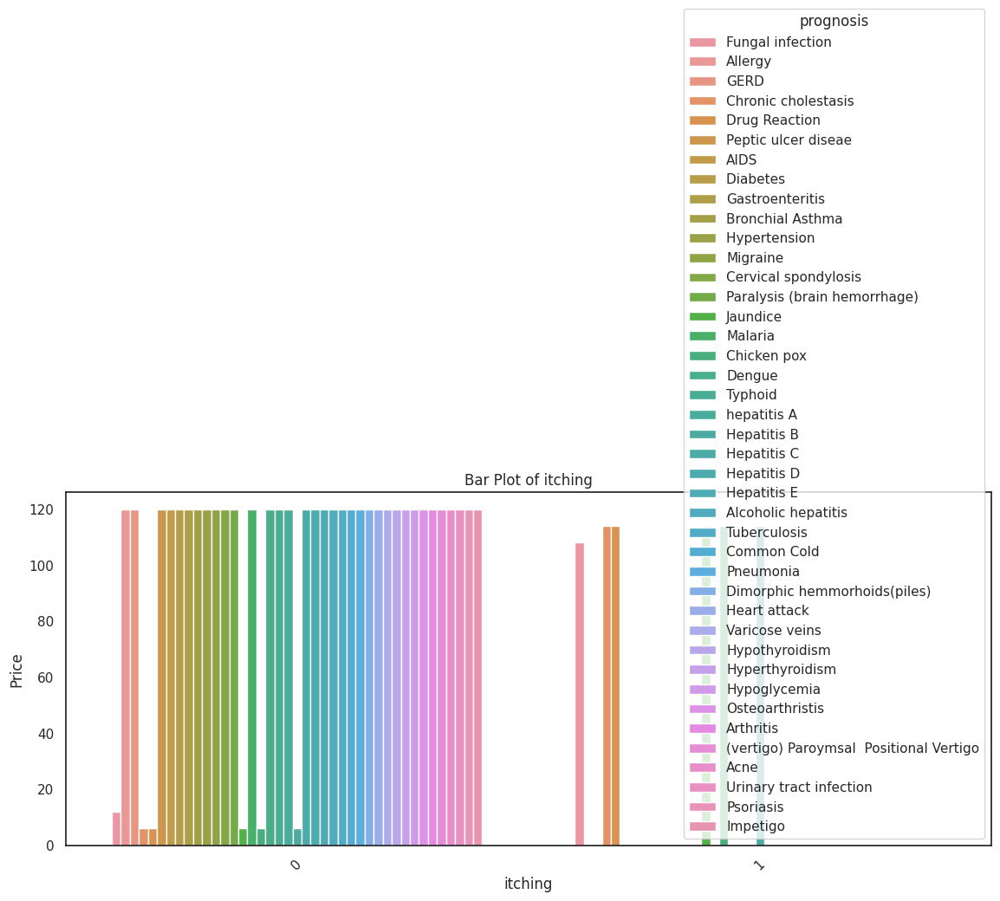

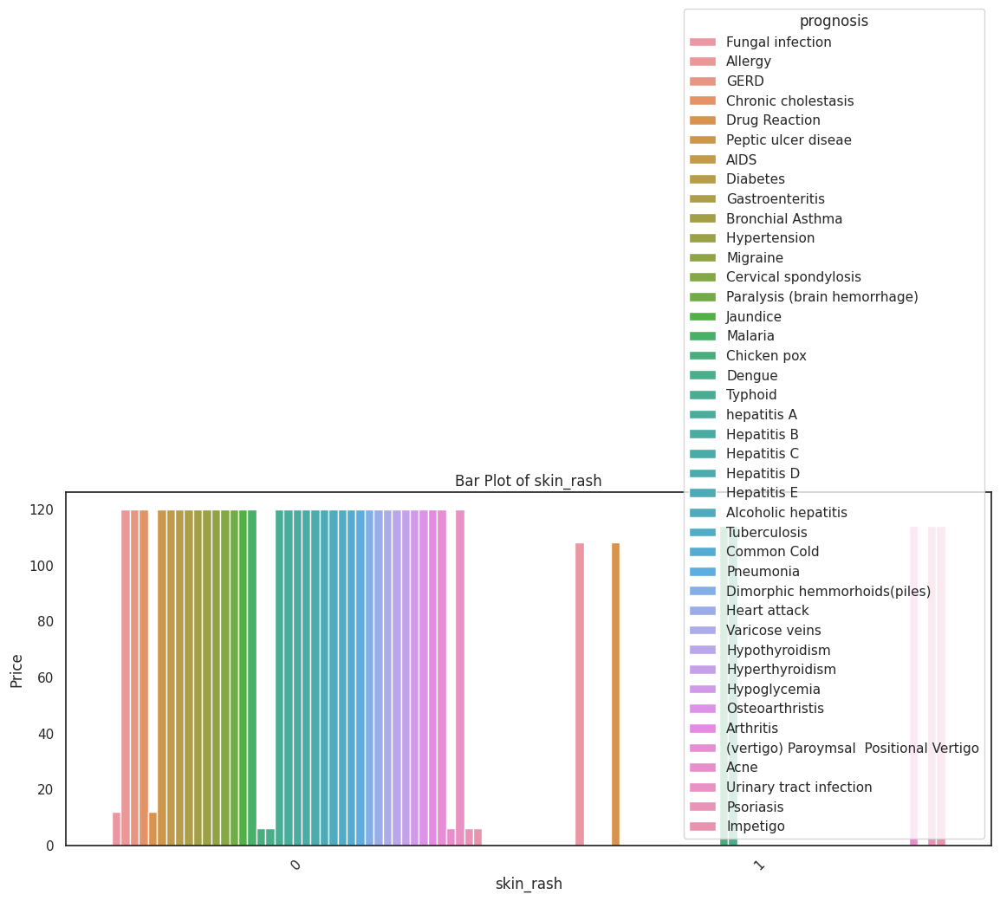

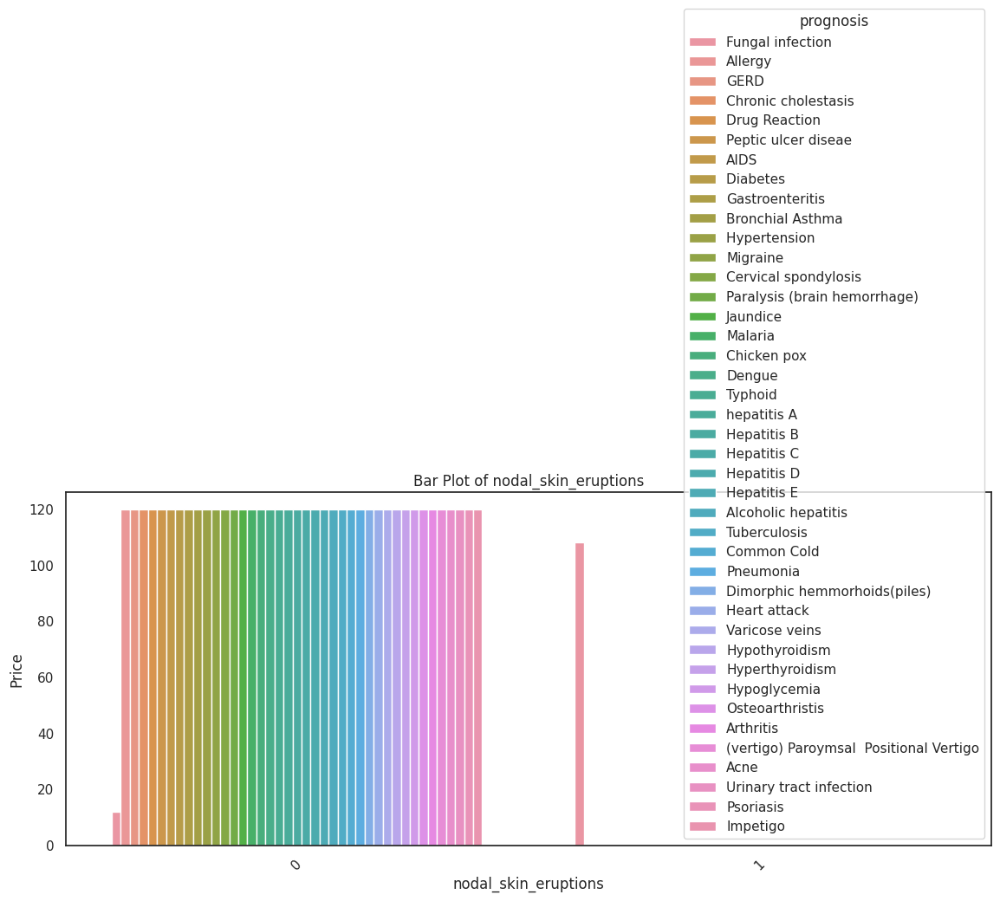

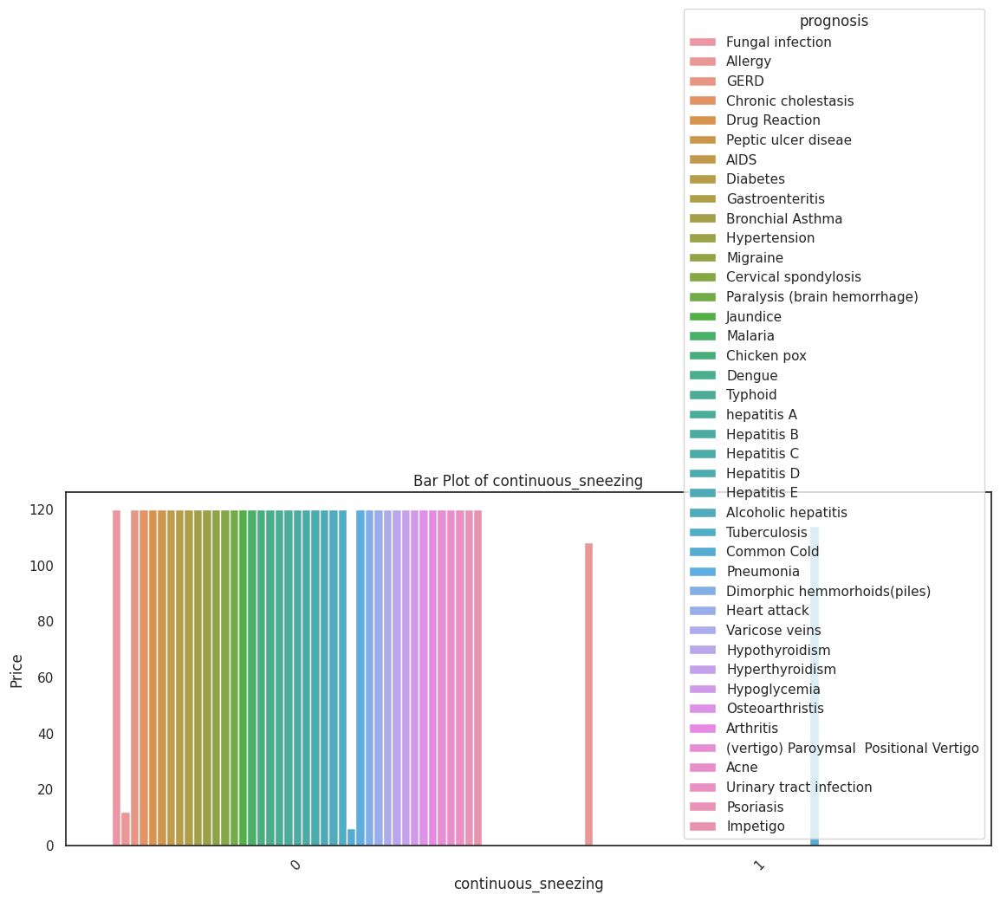

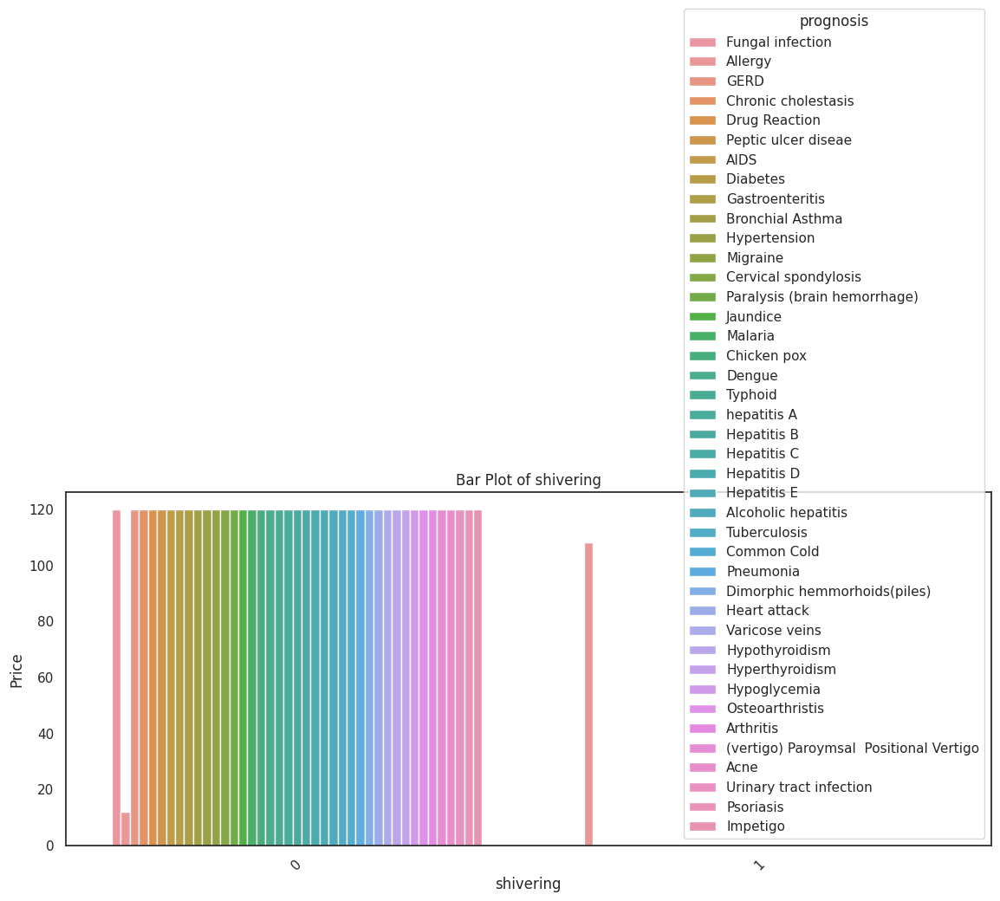

...

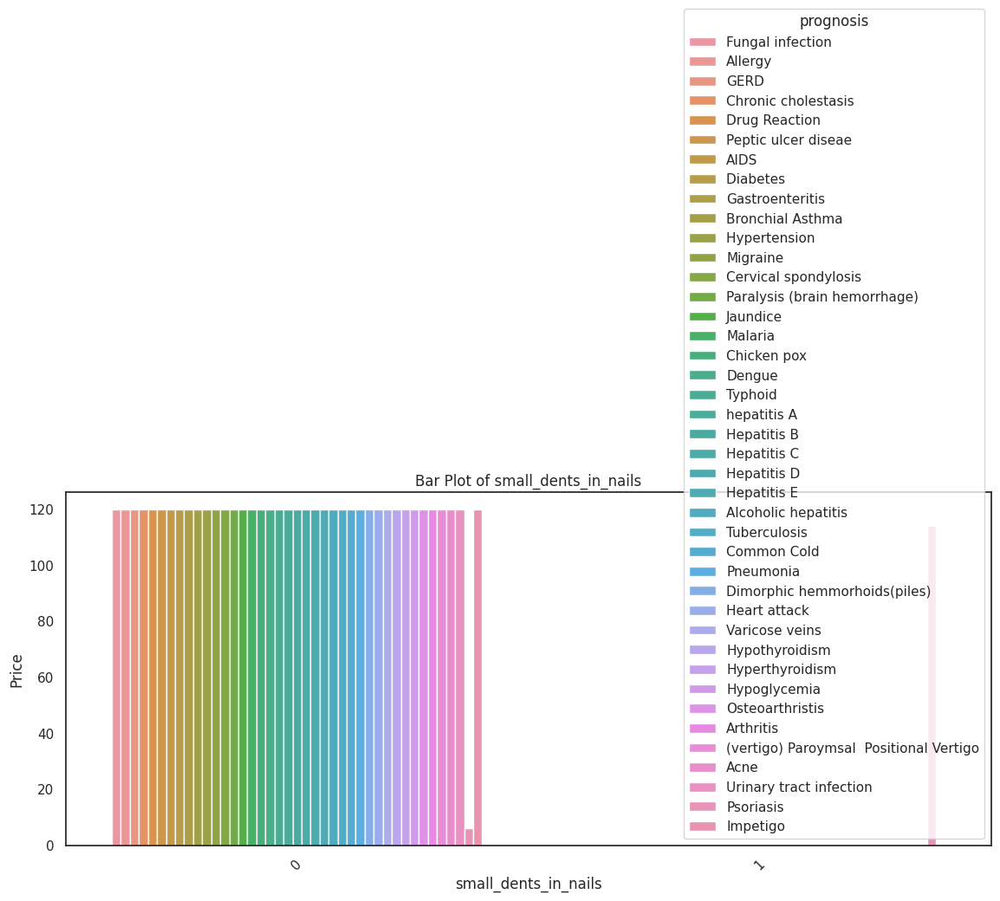

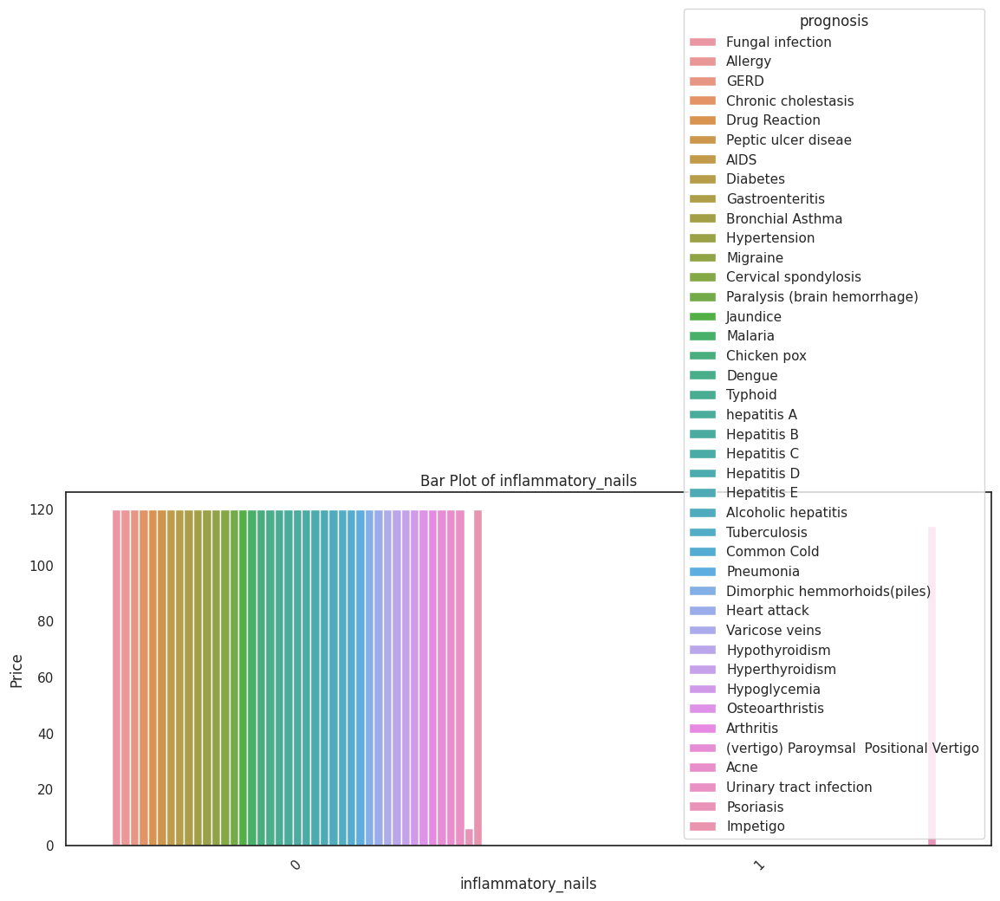

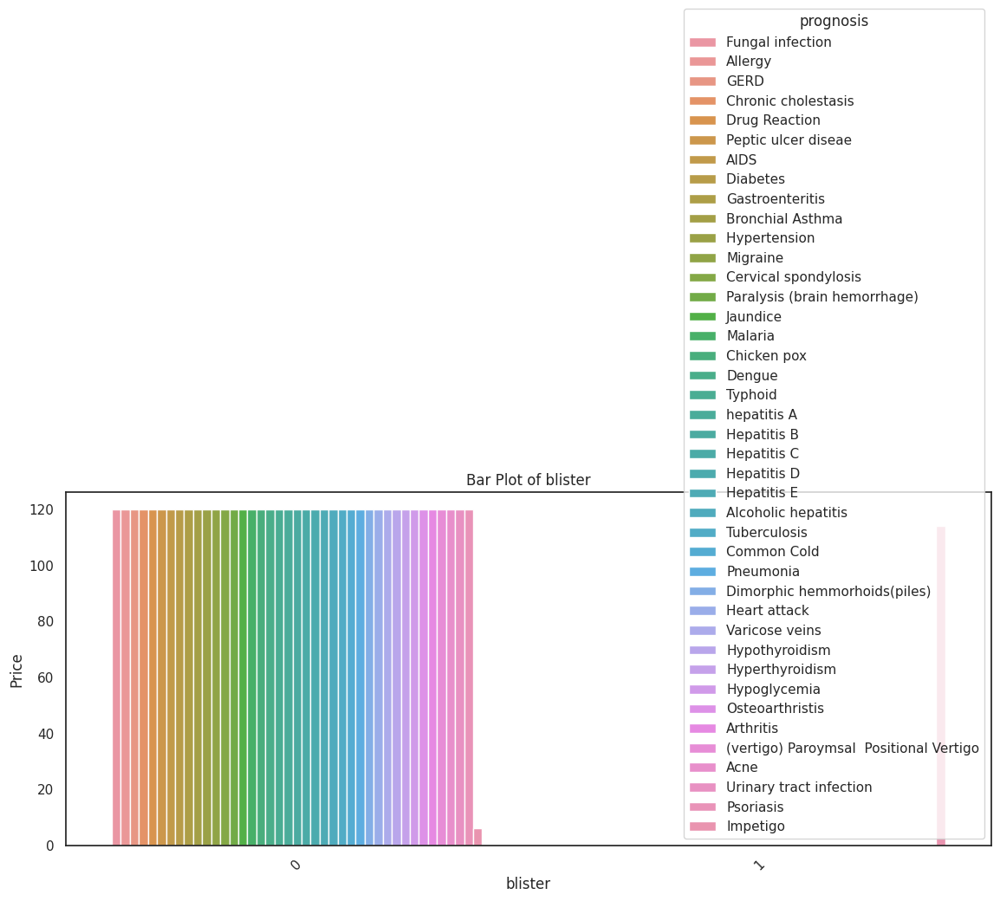

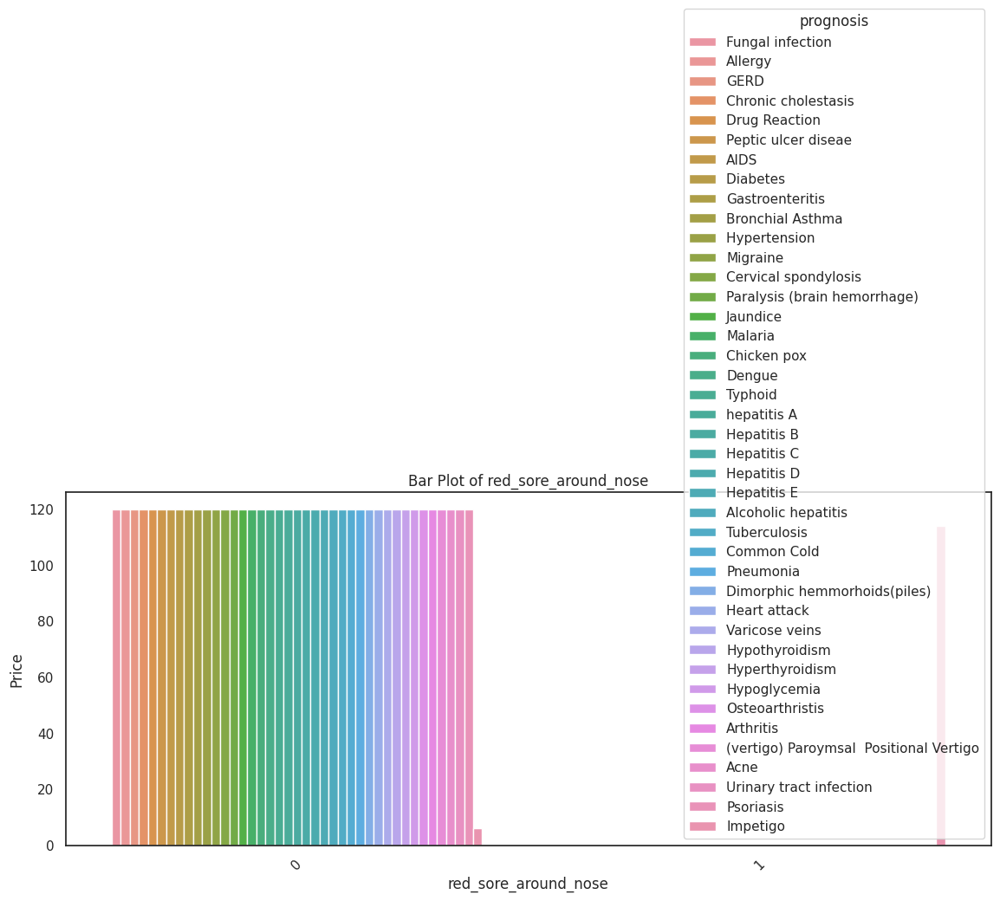

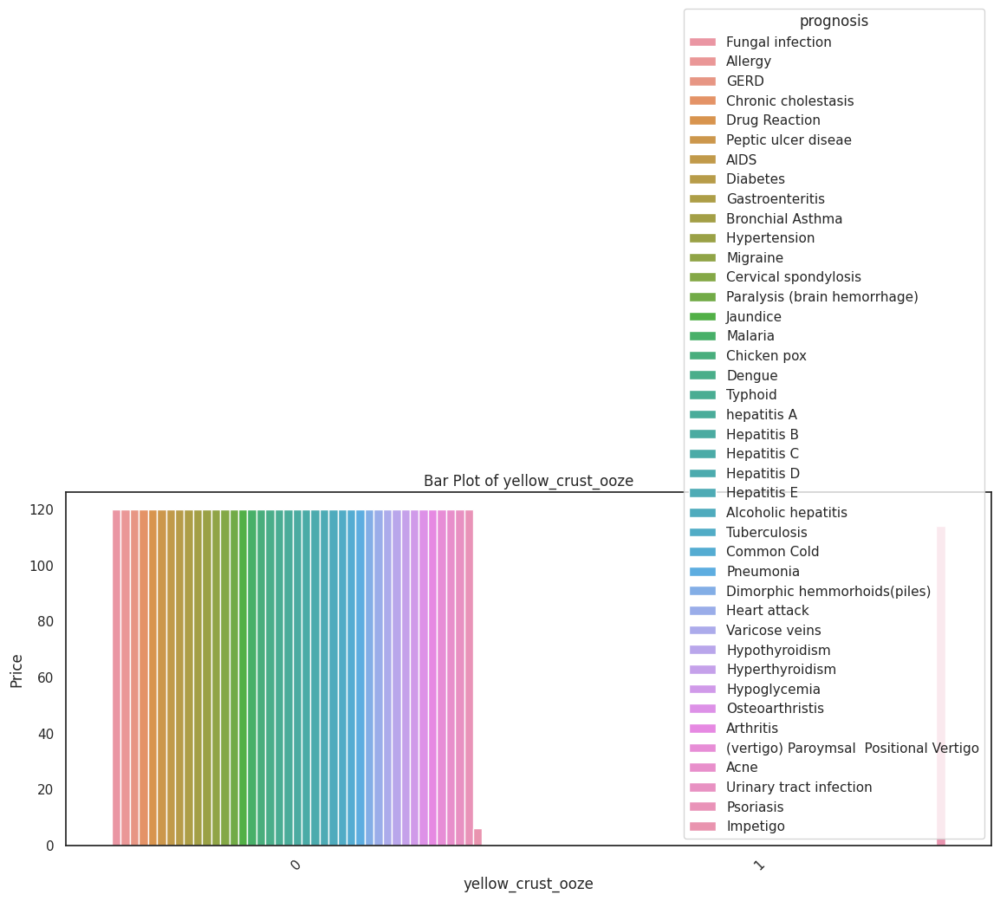

In [10]:
for i in train.select_dtypes("int64").columns:
            sns.countplot(data=train,x=i,hue="prognosis")
            plt.title(f"Bar Plot of {i}")
            plt.xlabel(i)
            plt.xticks(rotation=45)
            plt.ylabel("Price")

            plt.tight_layout()
            plt.show()            

>> Column 'itching' has 2 unique categories.

itching
0    4242
1     678
Name: count, dtype: int64


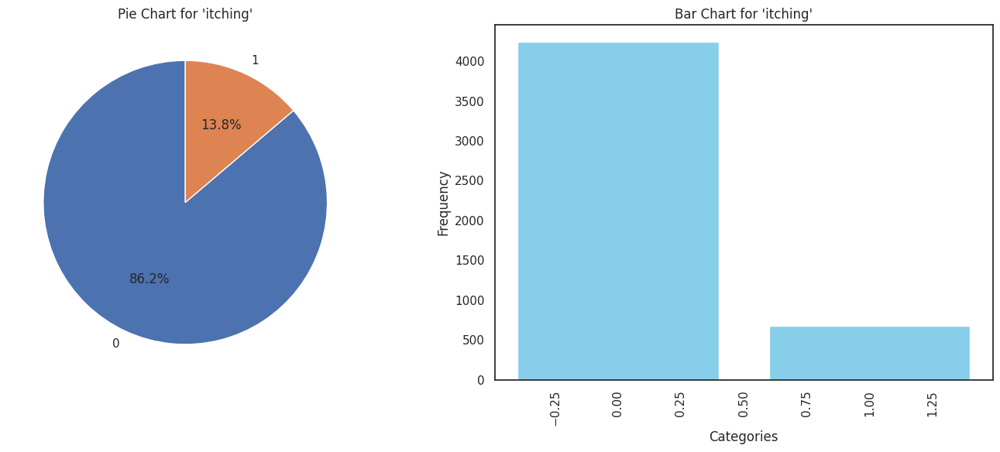

>> Column 'skin_rash' has 2 unique categories.

skin_rash
0    4134
1     786
Name: count, dtype: int64


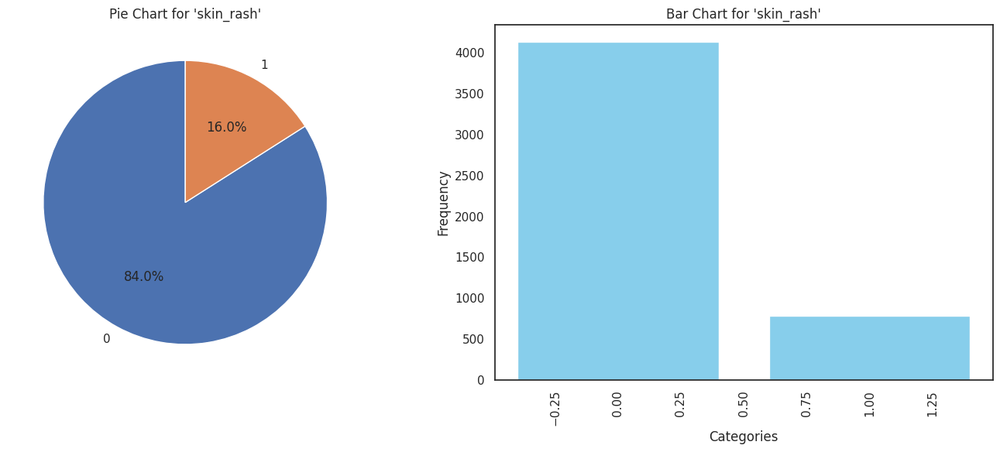

>> Column 'nodal_skin_eruptions' has 2 unique categories.

nodal_skin_eruptions
0    4812
1     108
Name: count, dtype: int64


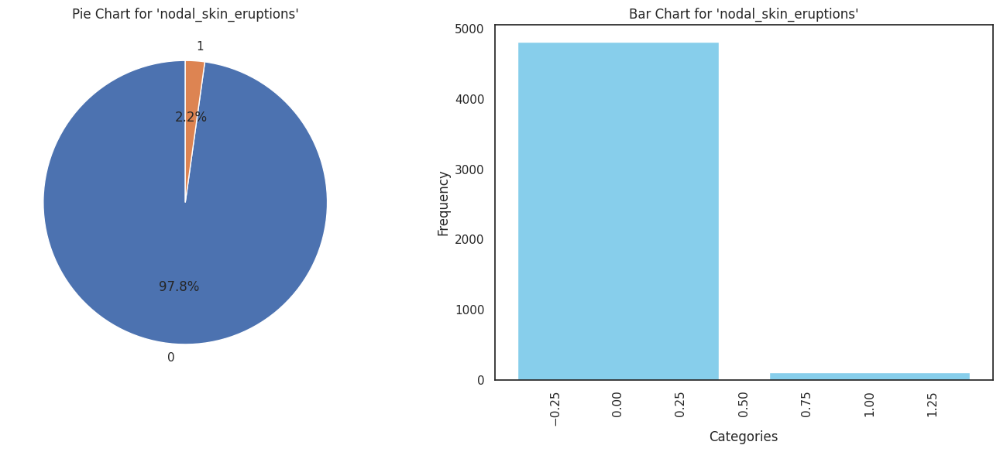

>> Column 'continuous_sneezing' has 2 unique categories.

continuous_sneezing
0    4698
1     222
Name: count, dtype: int64


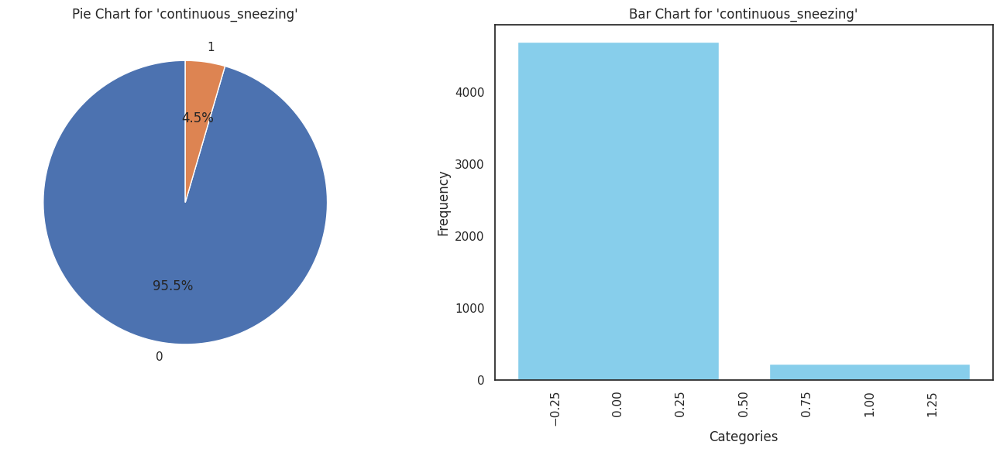

>> Column 'shivering' has 2 unique categories.

shivering
0    4812
1     108
Name: count, dtype: int64


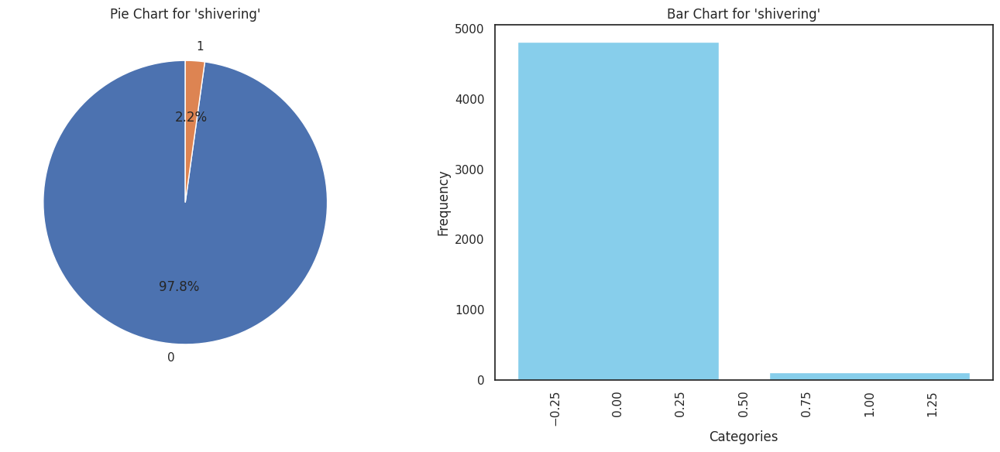

>> Column 'chills' has 2 unique categories.

chills
0    4122
1     798
Name: count, dtype: int64


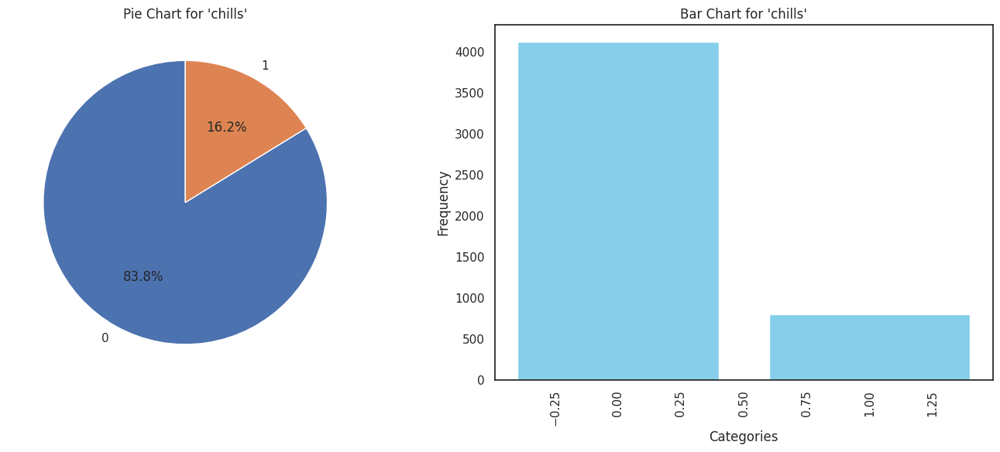

>> Column 'joint_pain' has 2 unique categories.

joint_pain
0    4236
1     684
Name: count, dtype: int64


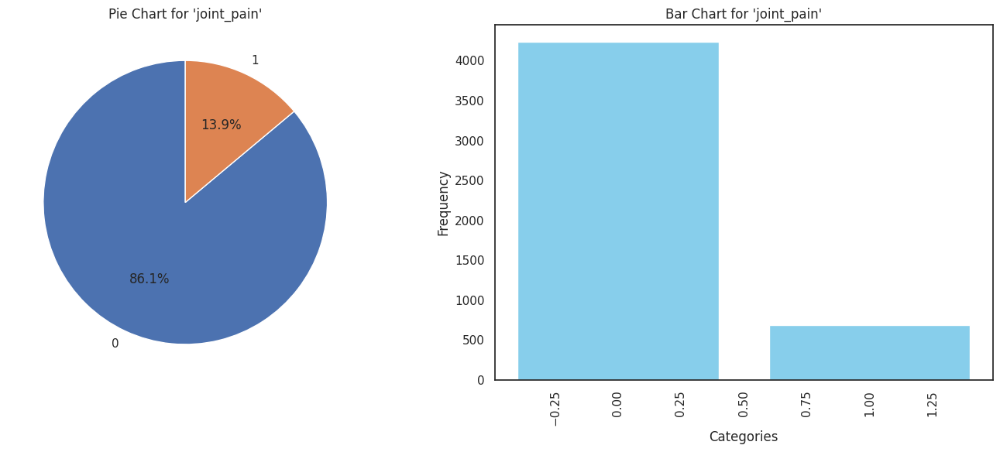

>> Column 'stomach_pain' has 2 unique categories.

stomach_pain
0    4698
1     222
Name: count, dtype: int64


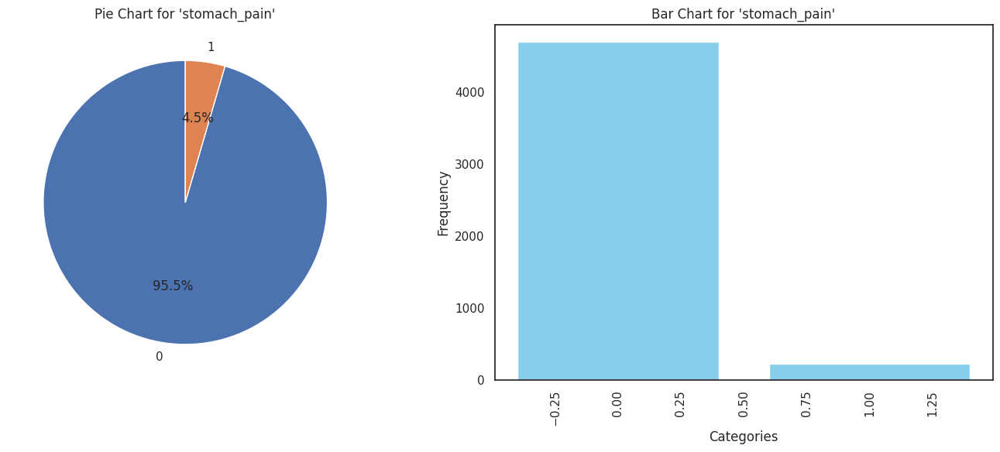

>> Column 'acidity' has 2 unique categories.

acidity
0    4698
1     222
Name: count, dtype: int64


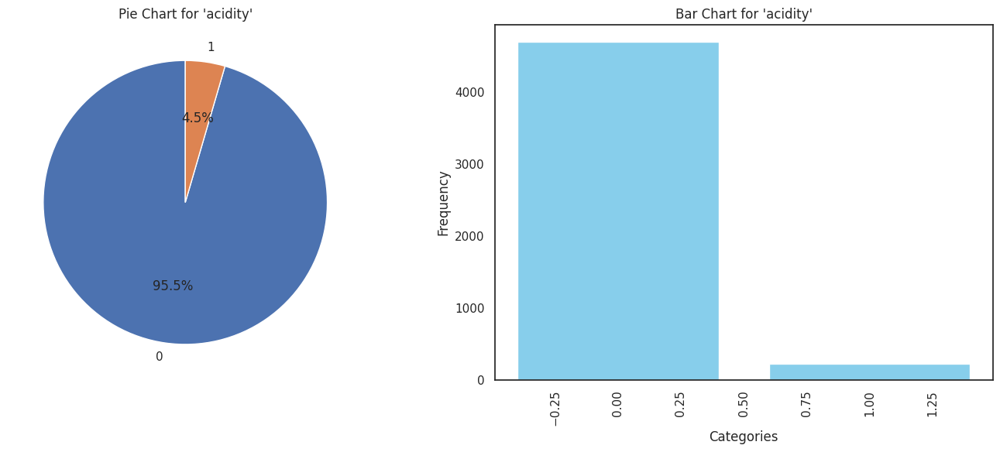

>> Column 'ulcers_on_tongue' has 2 unique categories.

ulcers_on_tongue
0    4812
1     108
Name: count, dtype: int64


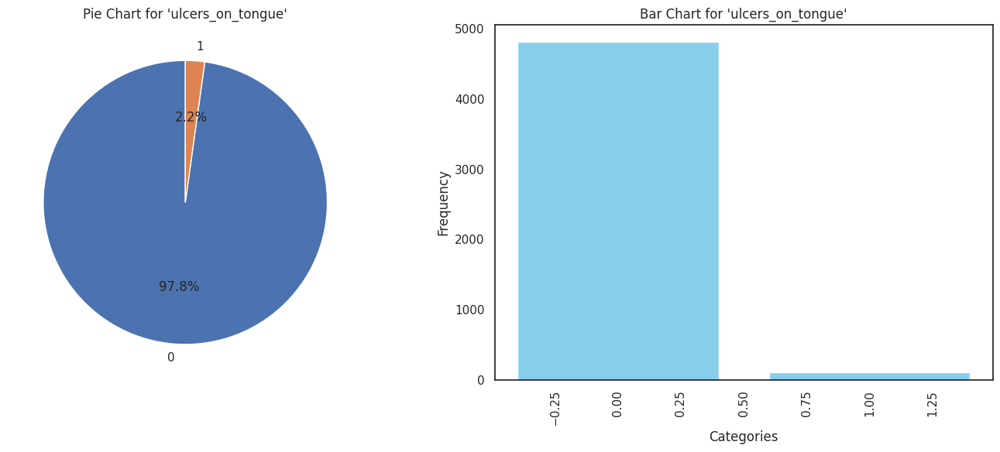

>> Column 'muscle_wasting' has 2 unique categories.

muscle_wasting
0    4812
1     108
Name: count, dtype: int64


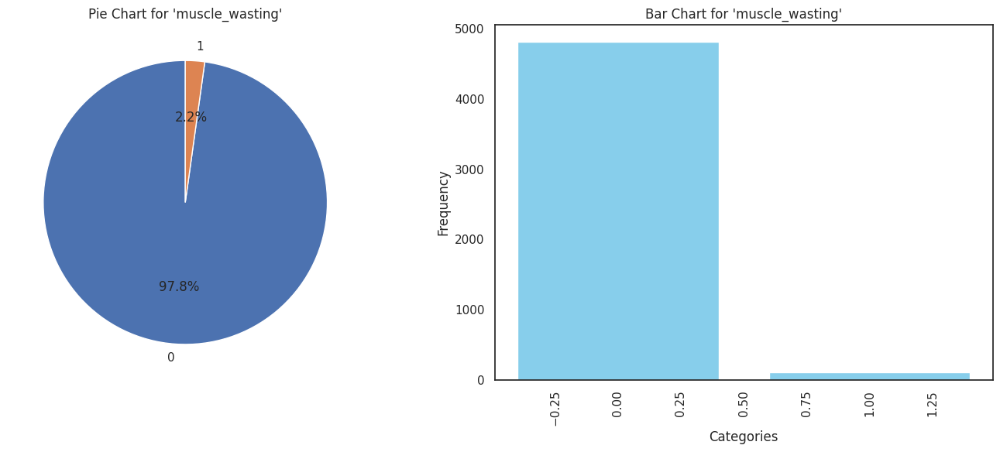

>> Column 'vomiting' has 2 unique categories.

vomiting
0    3006
1    1914
Name: count, dtype: int64


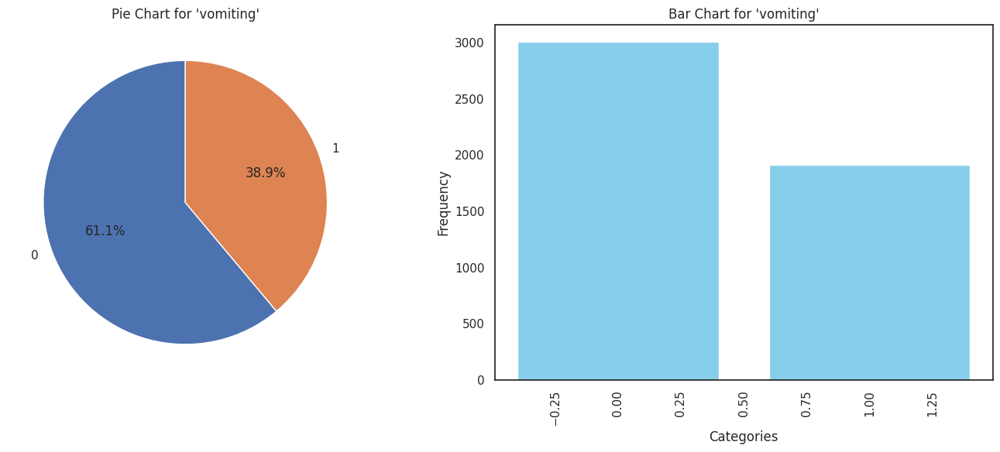

>> Column 'burning_micturition' has 2 unique categories.

burning_micturition
0    4704
1     216
Name: count, dtype: int64


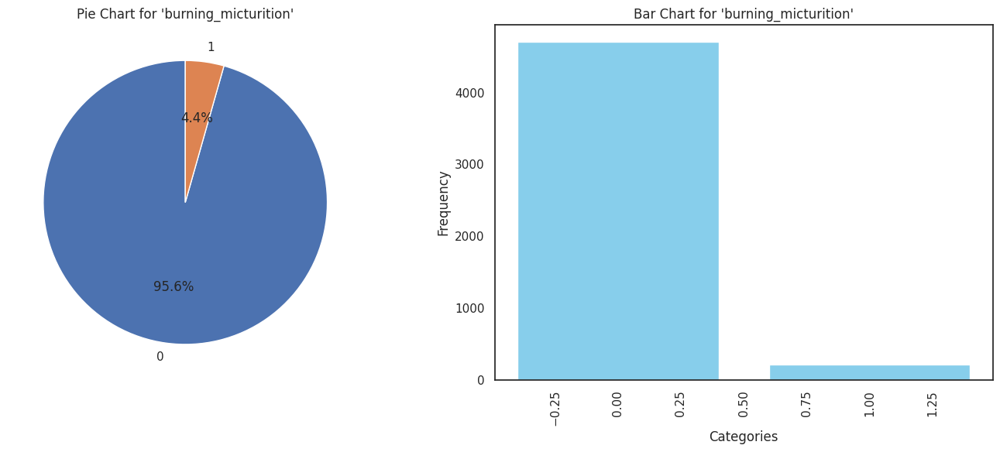

>> Column 'spotting_ urination' has 2 unique categories.

spotting_ urination
0    4812
1     108
Name: count, dtype: int64


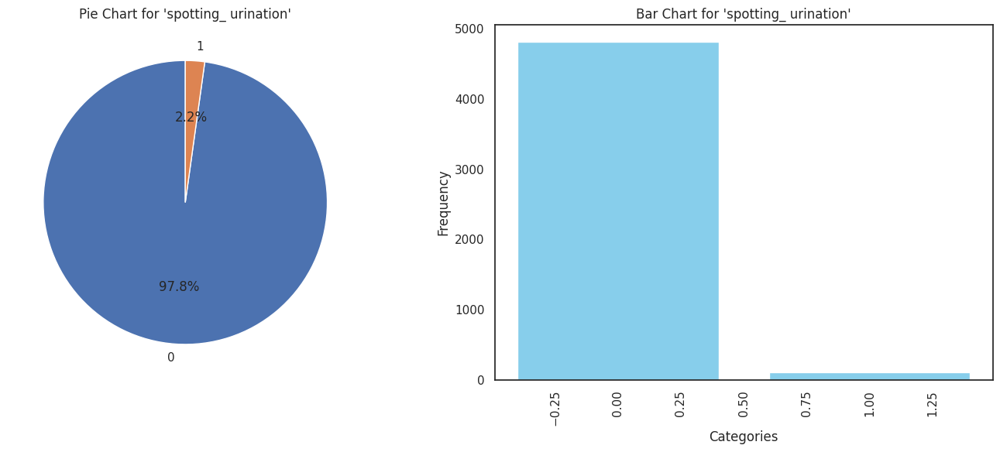

>> Column 'fatigue' has 2 unique categories.

fatigue
0    2988
1    1932
Name: count, dtype: int64


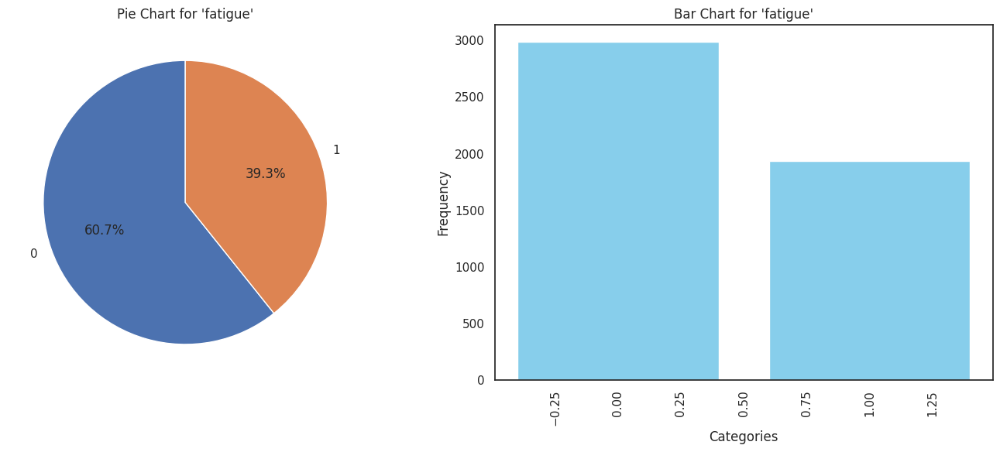

>> Column 'weight_gain' has 2 unique categories.

weight_gain
0    4806
1     114
Name: count, dtype: int64


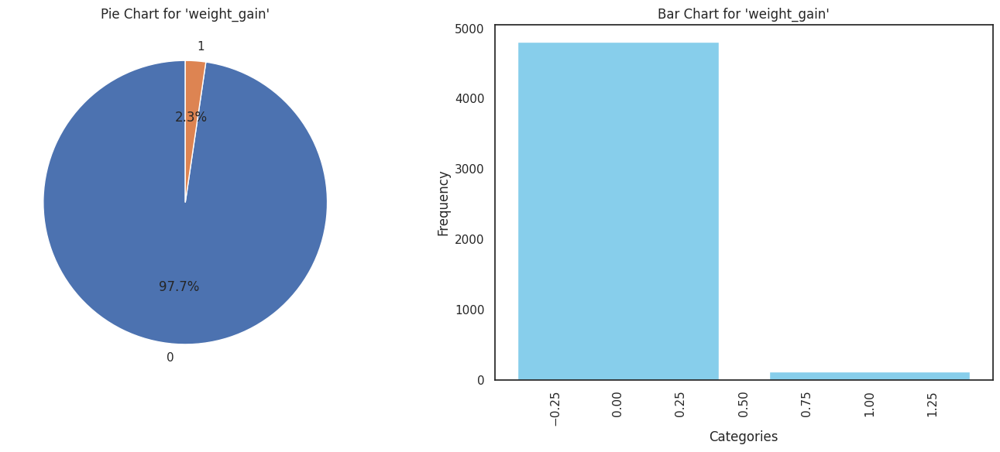

>> Column 'anxiety' has 2 unique categories.

anxiety
0    4806
1     114
Name: count, dtype: int64


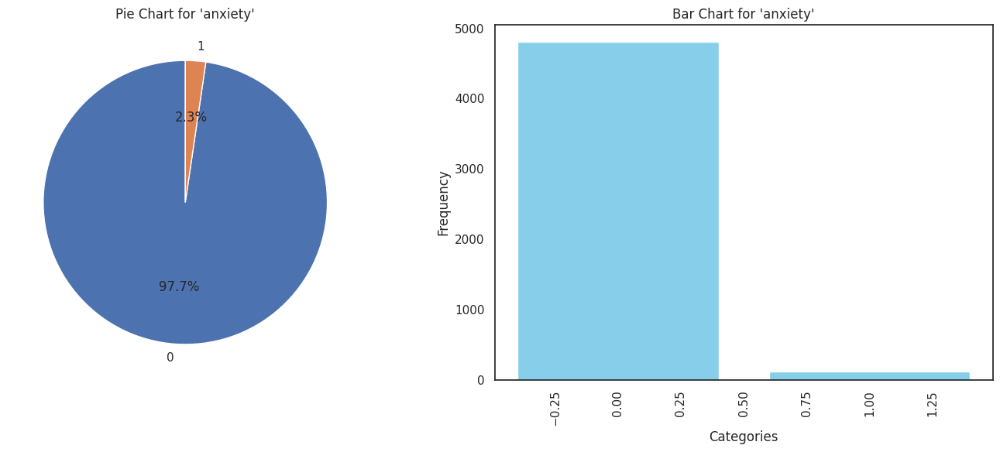

>> Column 'cold_hands_and_feets' has 2 unique categories.

cold_hands_and_feets
0    4806
1     114
Name: count, dtype: int64


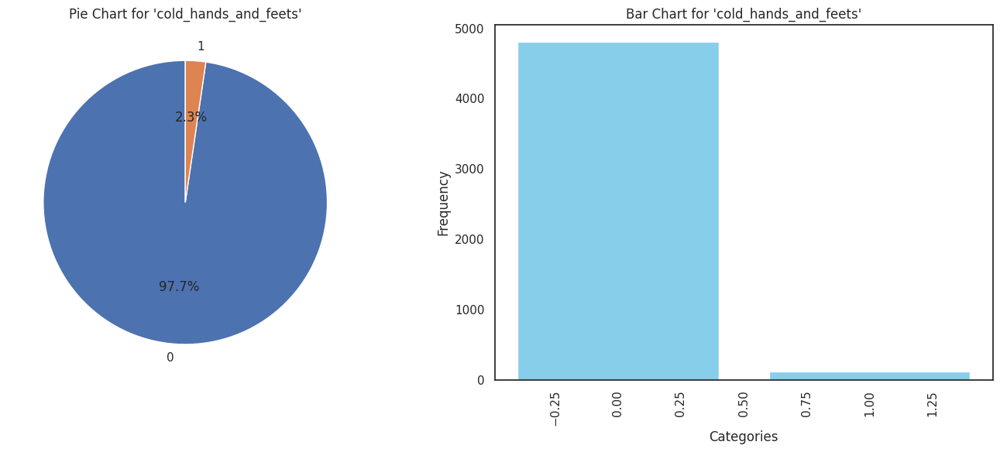

>> Column 'mood_swings' has 2 unique categories.

mood_swings
0    4692
1     228
Name: count, dtype: int64


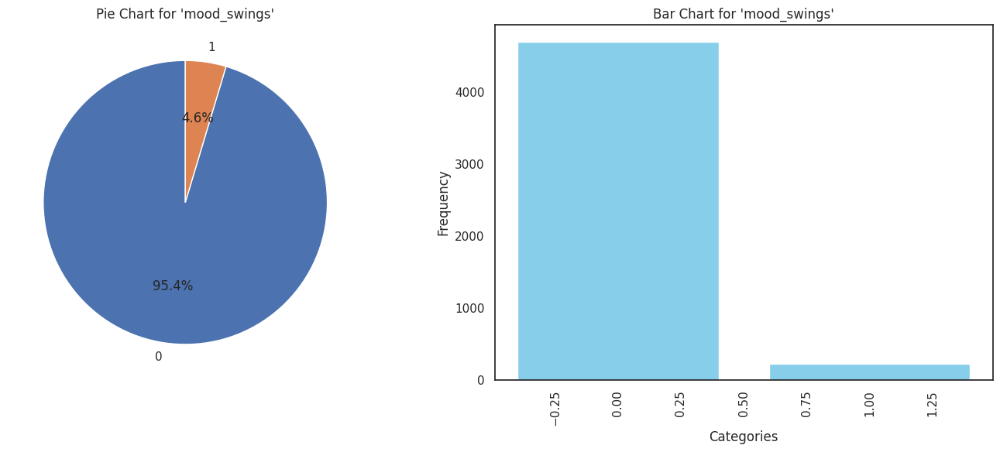

>> Column 'weight_loss' has 2 unique categories.

weight_loss
0    4464
1     456
Name: count, dtype: int64


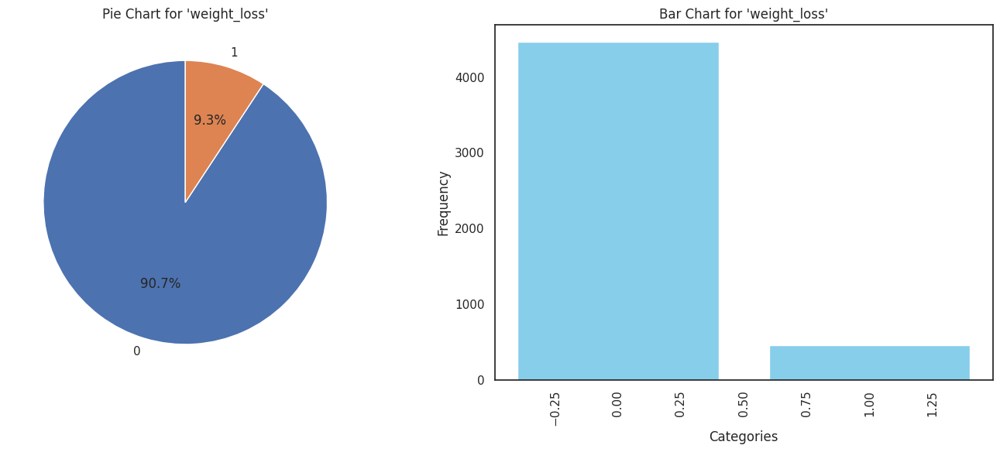

>> Column 'restlessness' has 2 unique categories.

restlessness
0    4692
1     228
Name: count, dtype: int64


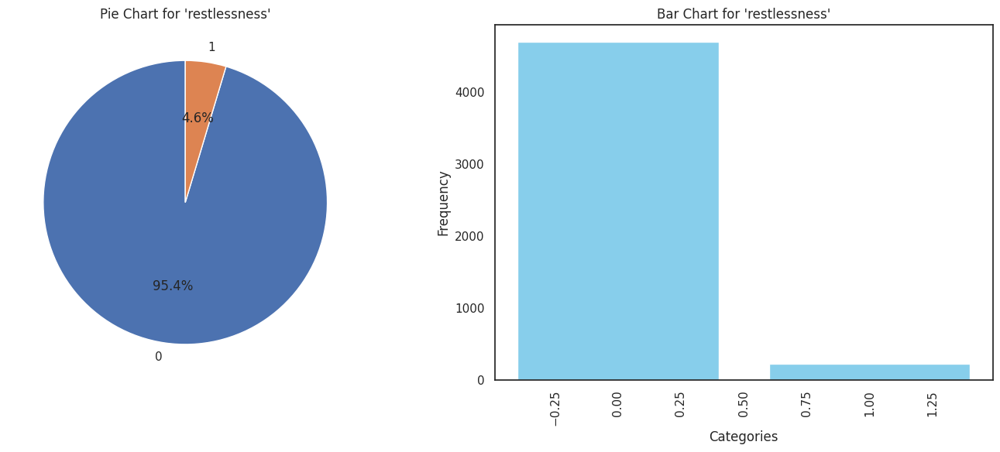

>> Column 'lethargy' has 2 unique categories.

lethargy
0    4464
1     456
Name: count, dtype: int64


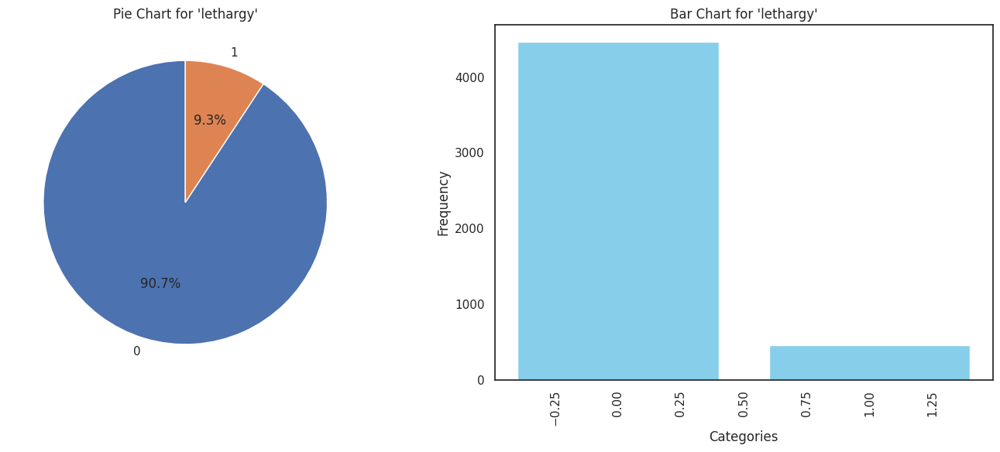

>> Column 'patches_in_throat' has 2 unique categories.

patches_in_throat
0    4812
1     108
Name: count, dtype: int64


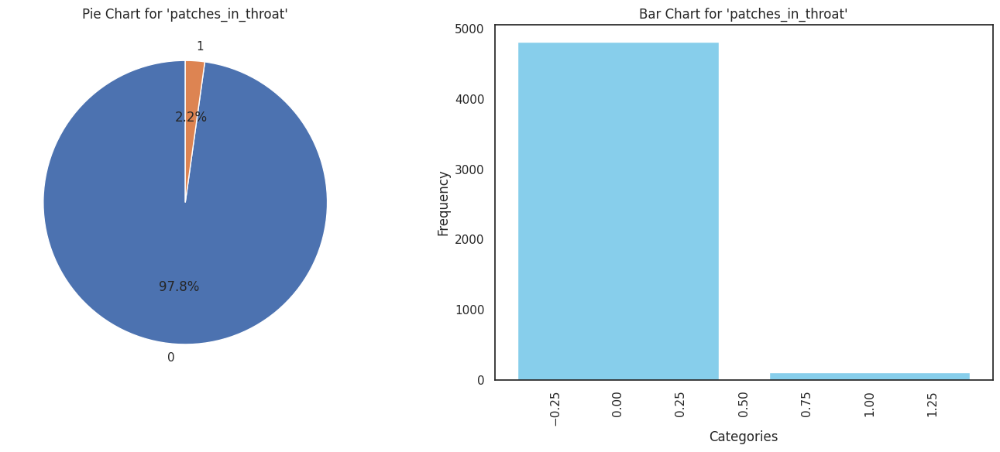

>> Column 'irregular_sugar_level' has 2 unique categories.

irregular_sugar_level
0    4806
1     114
Name: count, dtype: int64


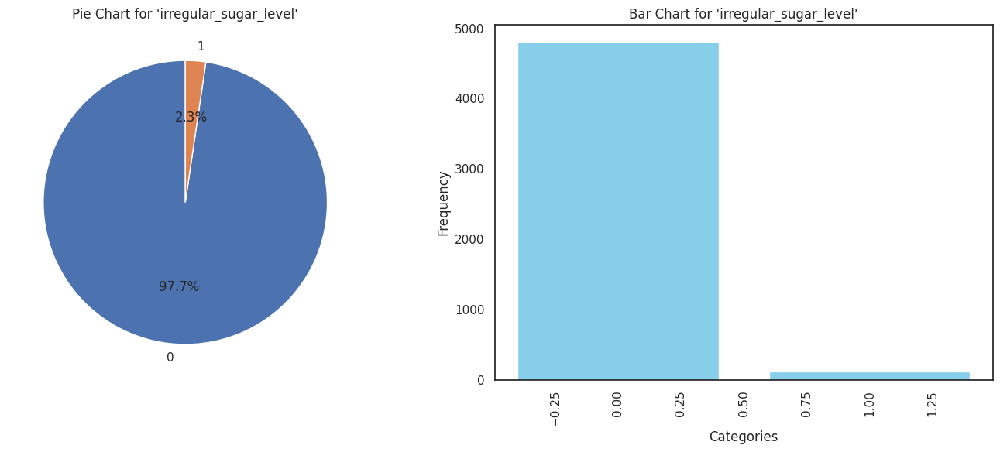

>> Column 'cough' has 2 unique categories.

cough
0    4356
1     564
Name: count, dtype: int64


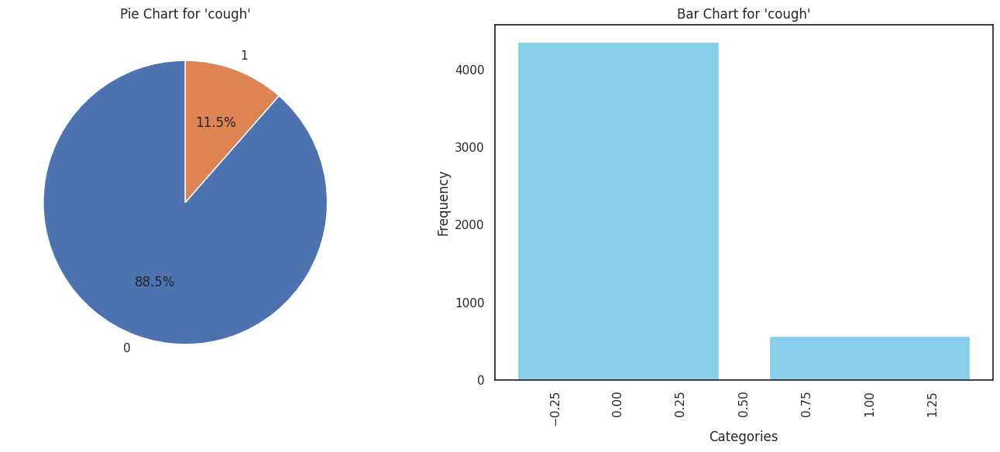

>> Column 'high_fever' has 2 unique categories.

high_fever
0    3558
1    1362
Name: count, dtype: int64


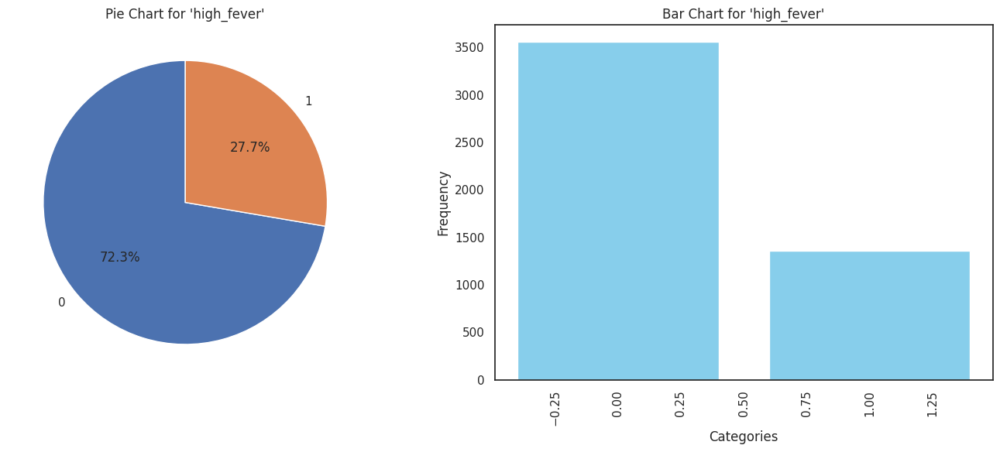

>> Column 'sunken_eyes' has 2 unique categories.

sunken_eyes
0    4812
1     108
Name: count, dtype: int64


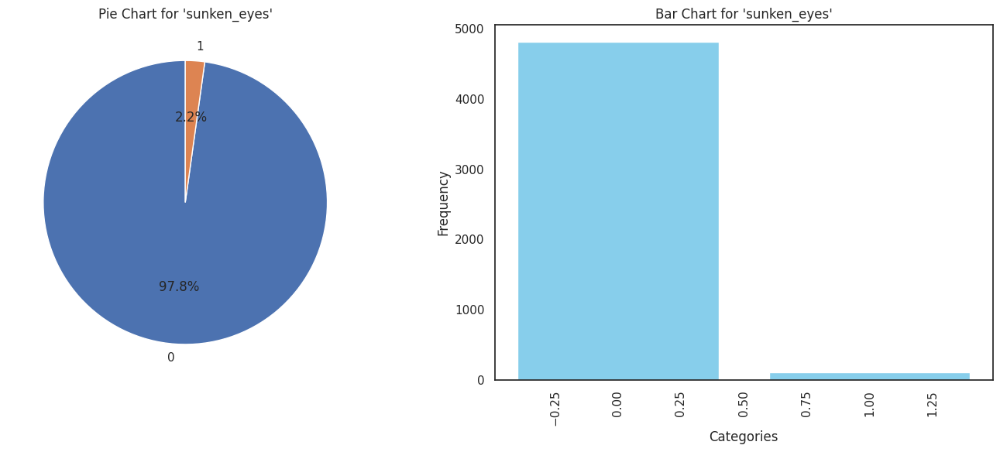

>> Column 'breathlessness' has 2 unique categories.

breathlessness
0    4470
1     450
Name: count, dtype: int64


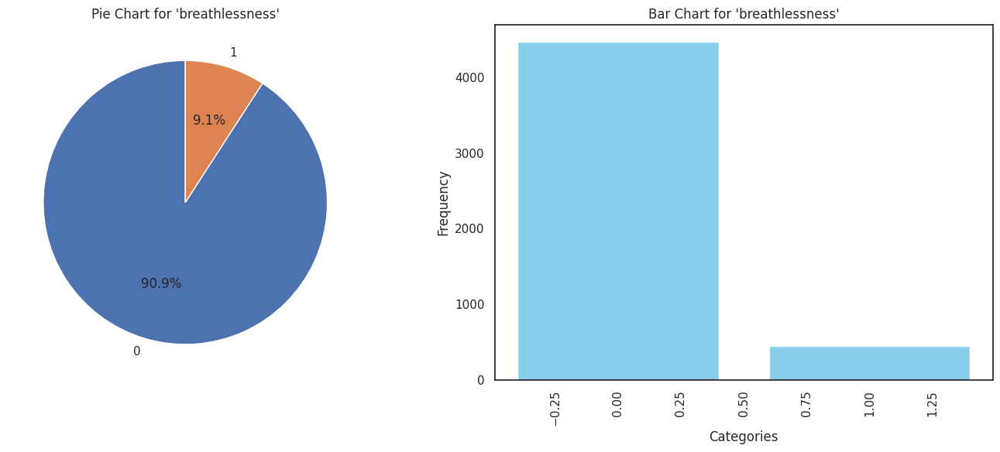

>> Column 'sweating' has 2 unique categories.

sweating
0    4242
1     678
Name: count, dtype: int64


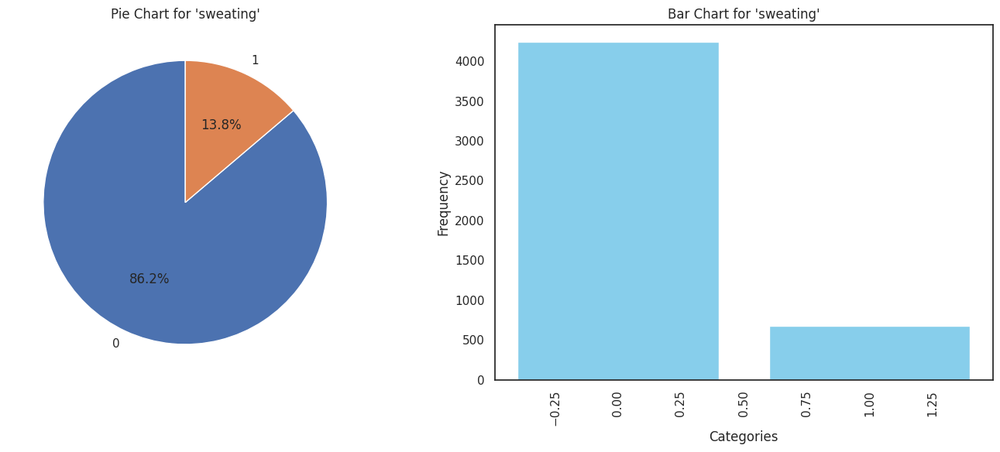

>> Column 'dehydration' has 2 unique categories.

dehydration
0    4812
1     108
Name: count, dtype: int64


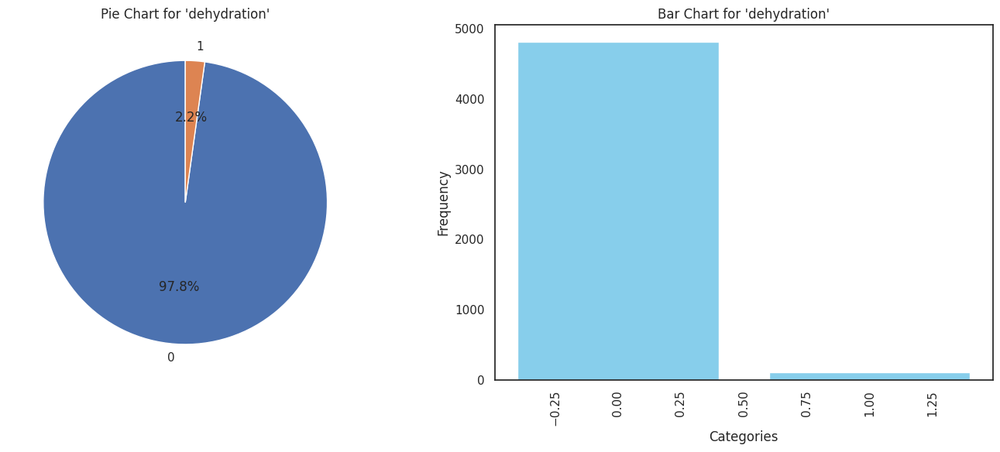

>> Column 'indigestion' has 2 unique categories.

indigestion
0    4698
1     222
Name: count, dtype: int64


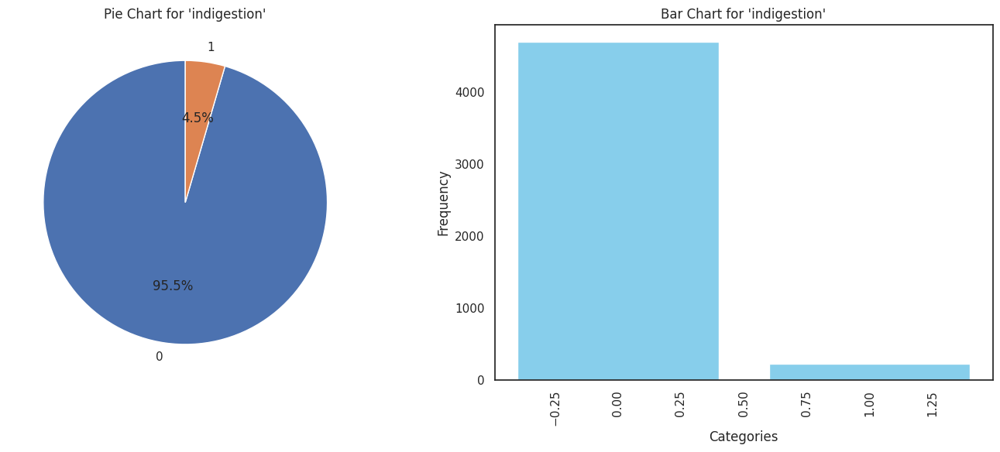

>> Column 'headache' has 2 unique categories.

headache
0    3786
1    1134
Name: count, dtype: int64


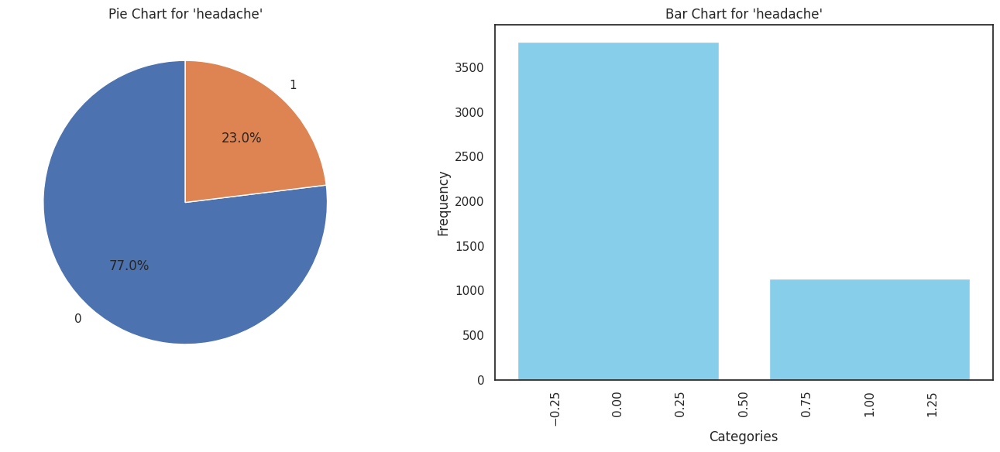

>> Column 'yellowish_skin' has 2 unique categories.

yellowish_skin
0    4008
1     912
Name: count, dtype: int64


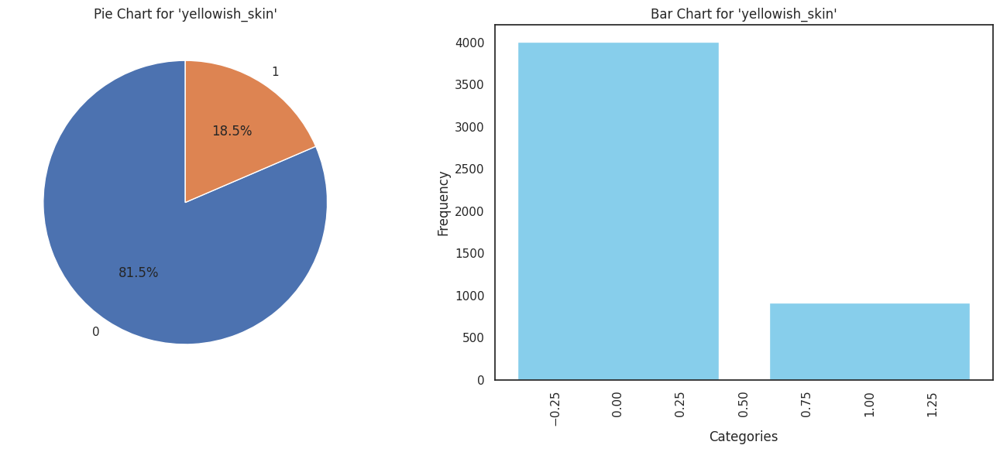

>> Column 'dark_urine' has 2 unique categories.

dark_urine
0    4350
1     570
Name: count, dtype: int64


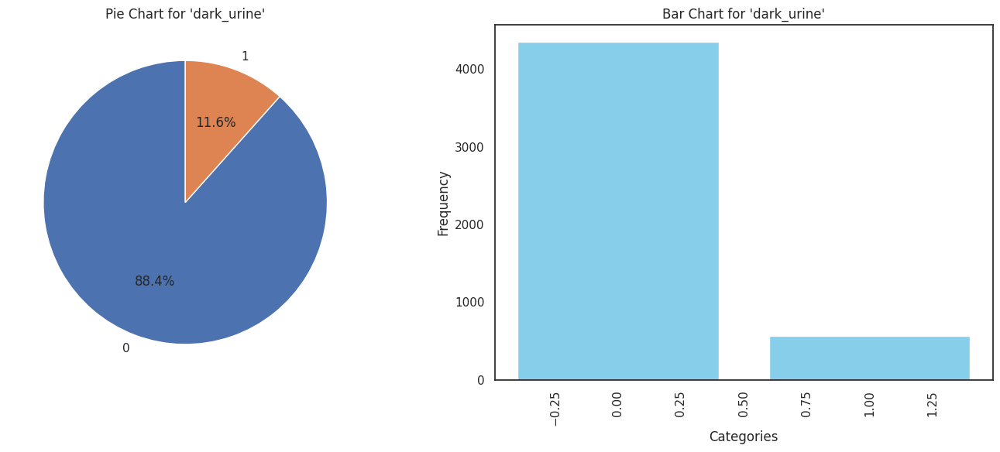

>> Column 'nausea' has 2 unique categories.

nausea
0    3774
1    1146
Name: count, dtype: int64


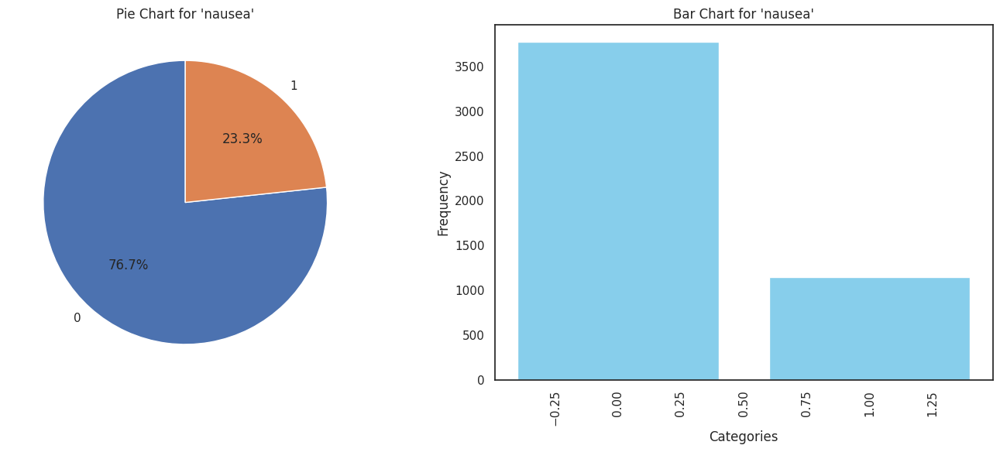

>> Column 'loss_of_appetite' has 2 unique categories.

loss_of_appetite
0    3768
1    1152
Name: count, dtype: int64


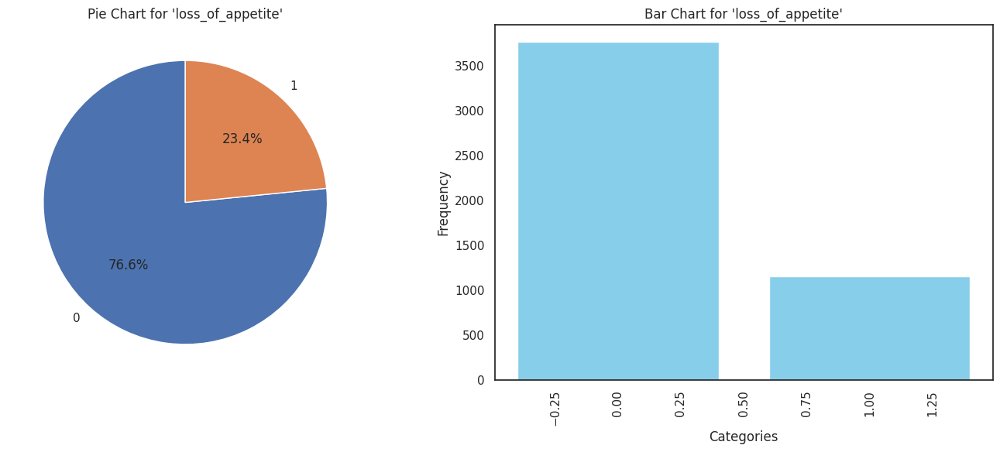

>> Column 'pain_behind_the_eyes' has 2 unique categories.

pain_behind_the_eyes
0    4800
1     120
Name: count, dtype: int64


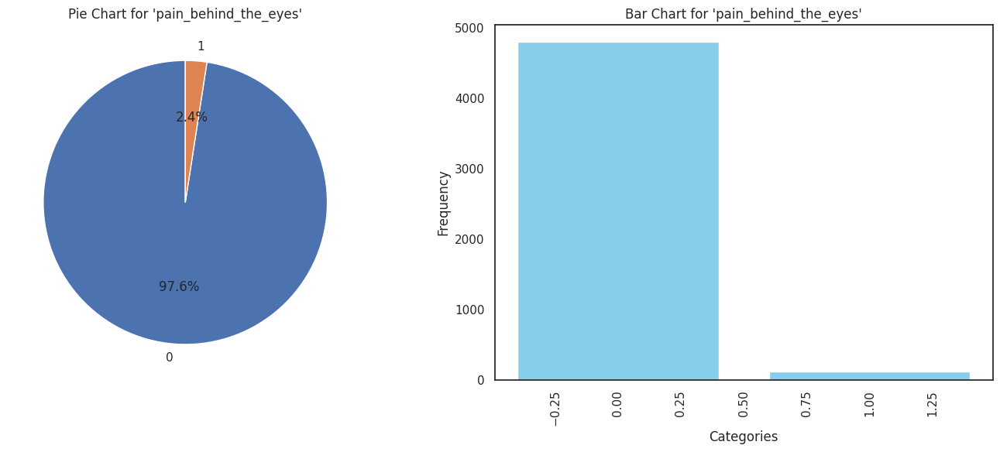

>> Column 'back_pain' has 2 unique categories.

back_pain
0    4692
1     228
Name: count, dtype: int64


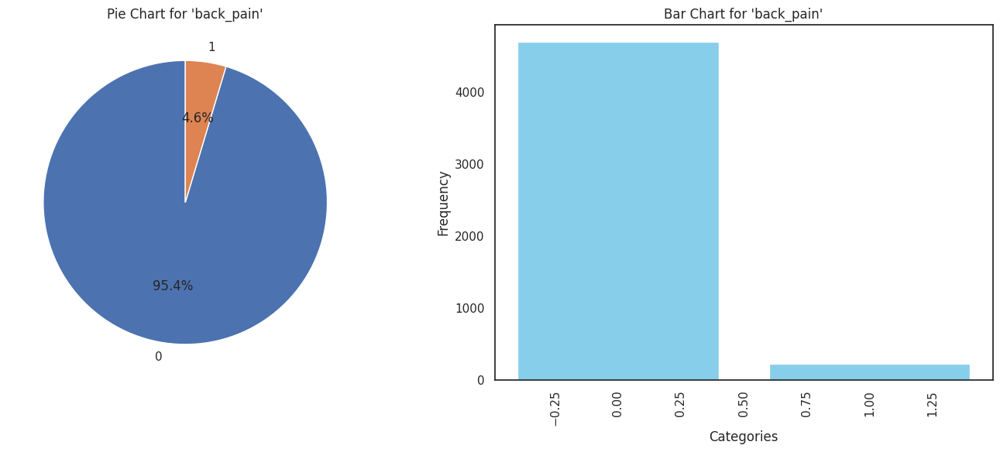

>> Column 'constipation' has 2 unique categories.

constipation
0    4692
1     228
Name: count, dtype: int64


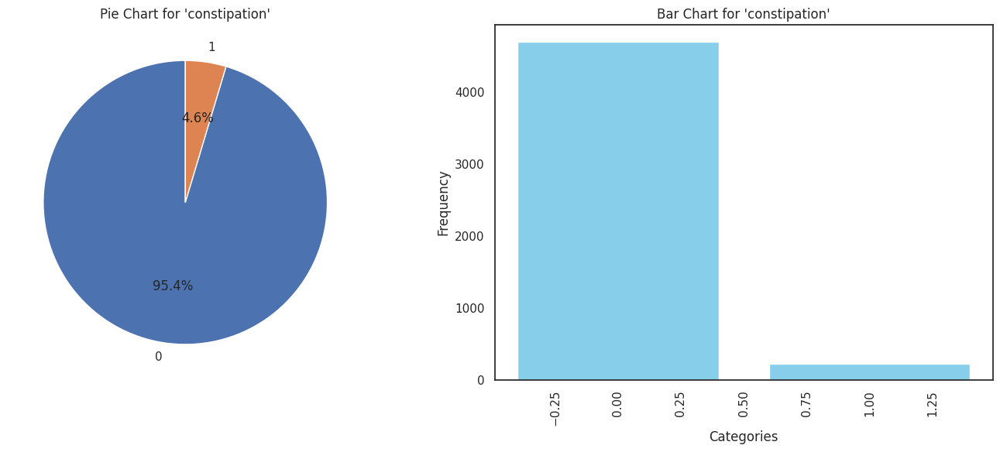

>> Column 'abdominal_pain' has 2 unique categories.

abdominal_pain
0    3888
1    1032
Name: count, dtype: int64


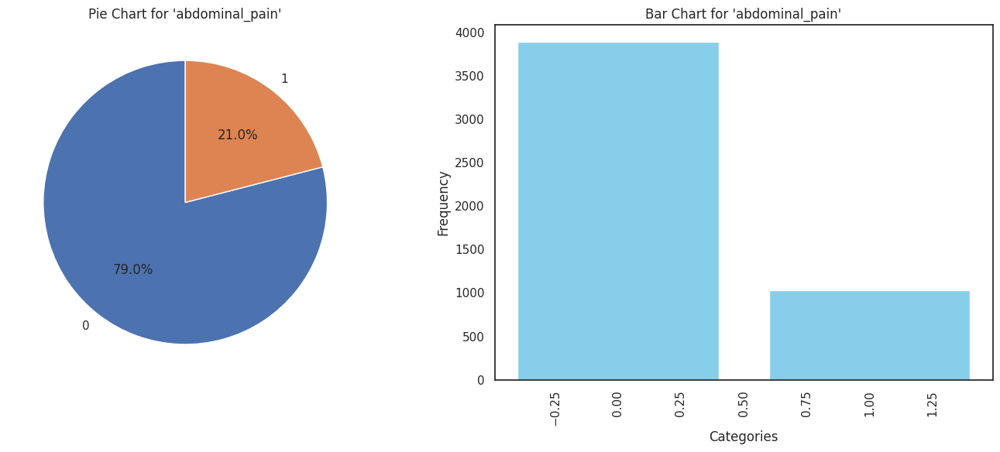

>> Column 'diarrhoea' has 2 unique categories.

diarrhoea
0    4356
1     564
Name: count, dtype: int64


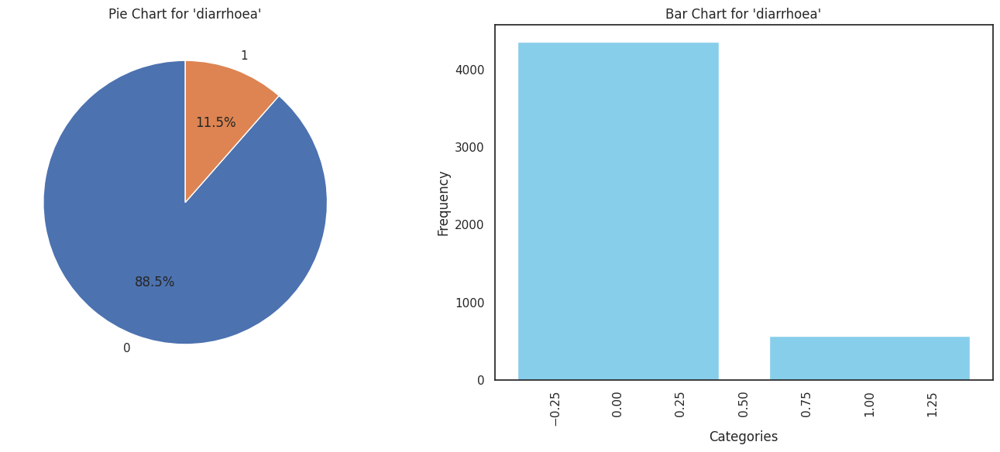

>> Column 'mild_fever' has 2 unique categories.

mild_fever
0    4566
1     354
Name: count, dtype: int64


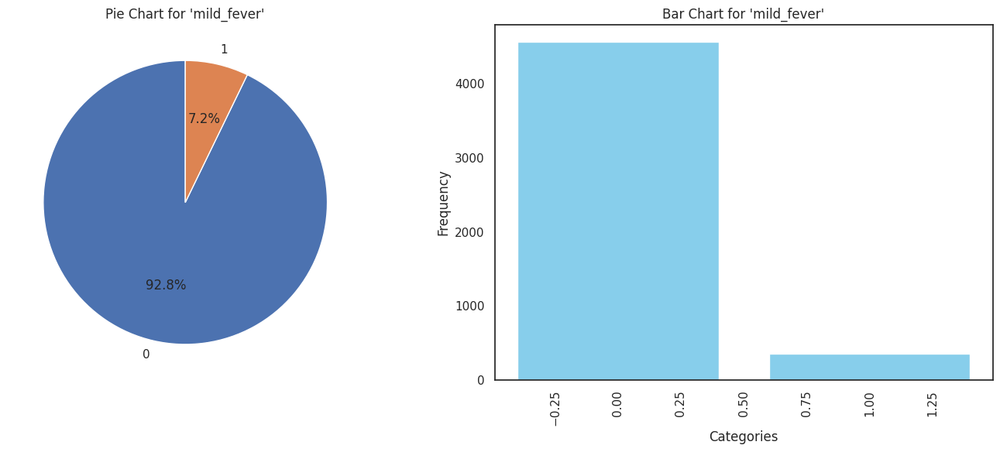

>> Column 'yellow_urine' has 2 unique categories.

yellow_urine
0    4806
1     114
Name: count, dtype: int64


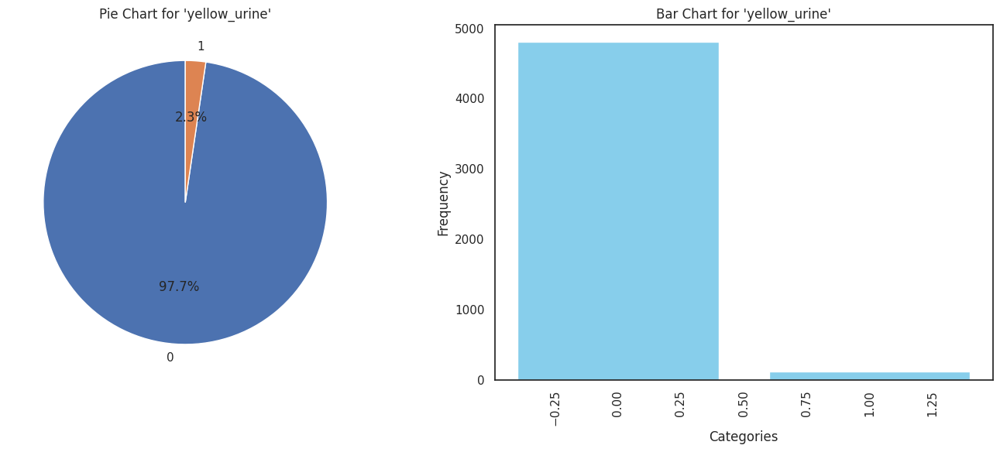

>> Column 'yellowing_of_eyes' has 2 unique categories.

yellowing_of_eyes
0    4104
1     816
Name: count, dtype: int64


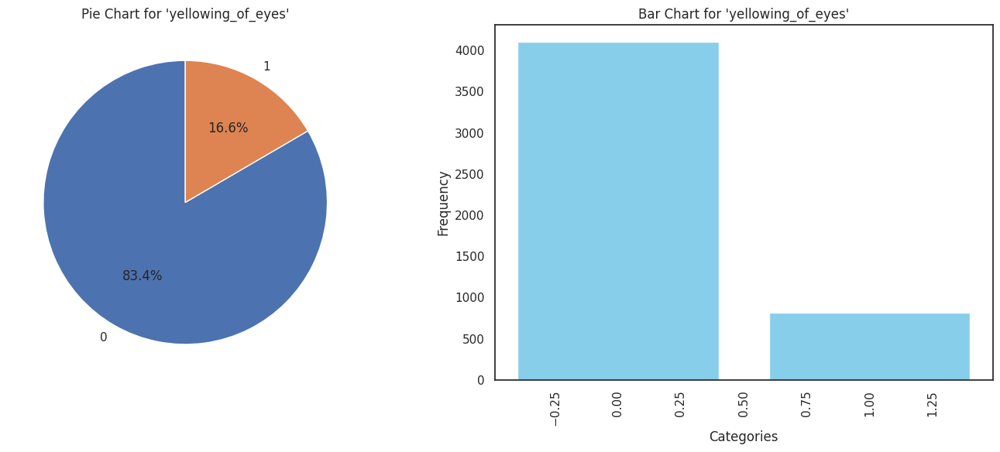

>> Column 'acute_liver_failure' has 2 unique categories.

acute_liver_failure
0    4806
1     114
Name: count, dtype: int64


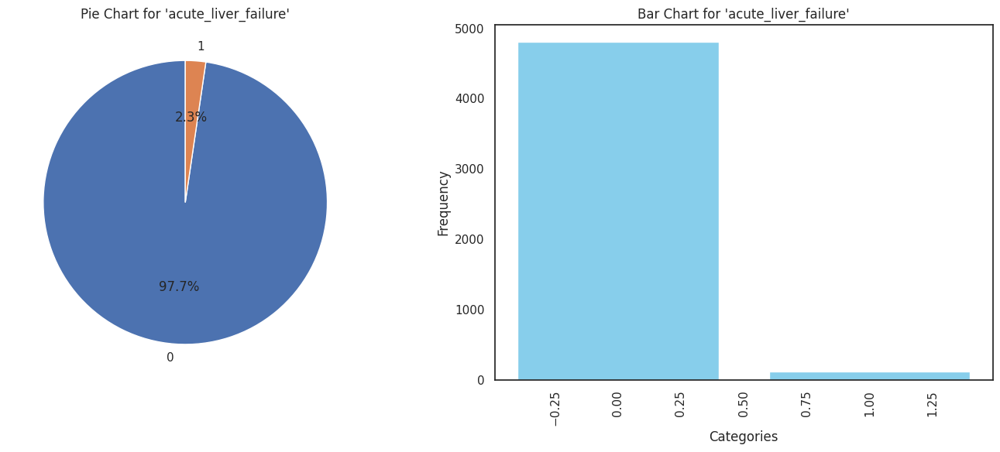

>> Column 'fluid_overload' has 1 unique categories.

fluid_overload
0    4920
Name: count, dtype: int64


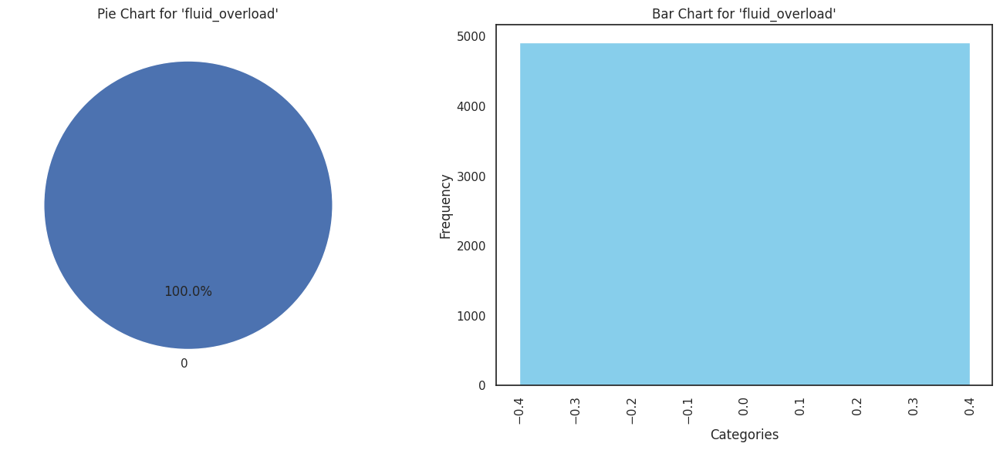

>> Column 'swelling_of_stomach' has 2 unique categories.

swelling_of_stomach
0    4806
1     114
Name: count, dtype: int64


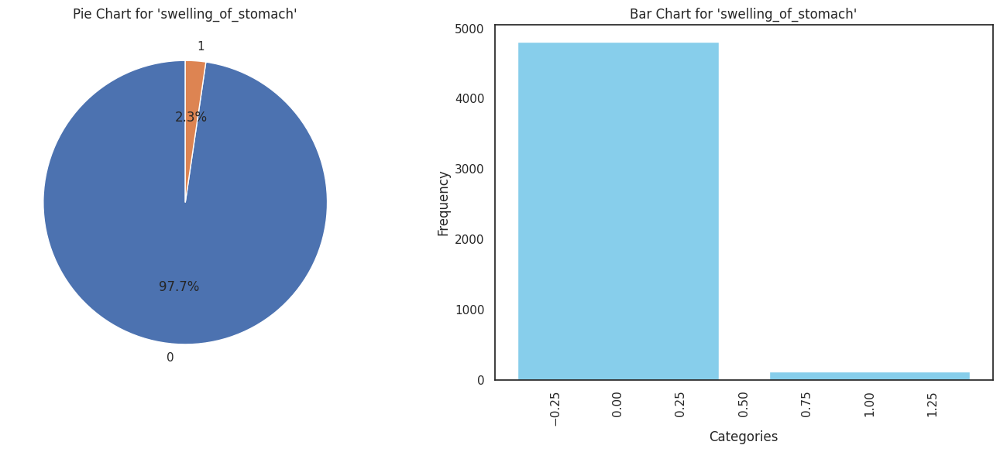

>> Column 'swelled_lymph_nodes' has 2 unique categories.

swelled_lymph_nodes
0    4572
1     348
Name: count, dtype: int64


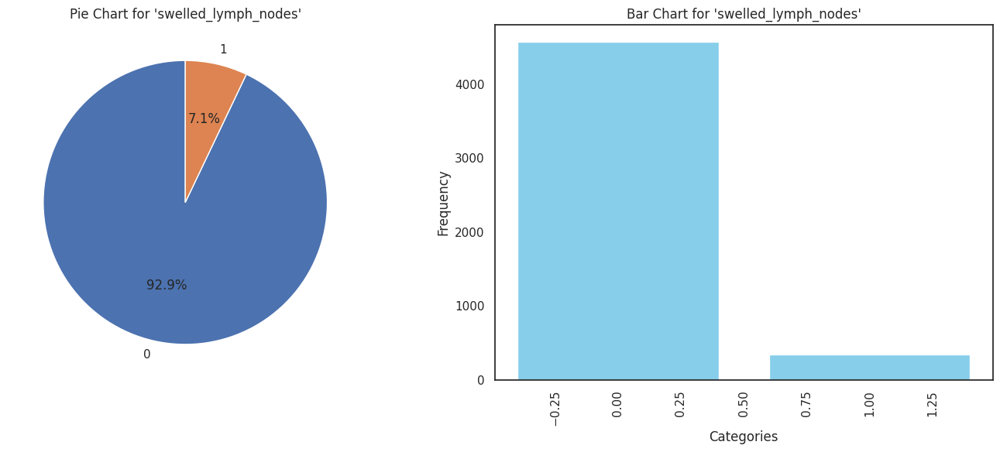

>> Column 'malaise' has 2 unique categories.

malaise
0    4218
1     702
Name: count, dtype: int64


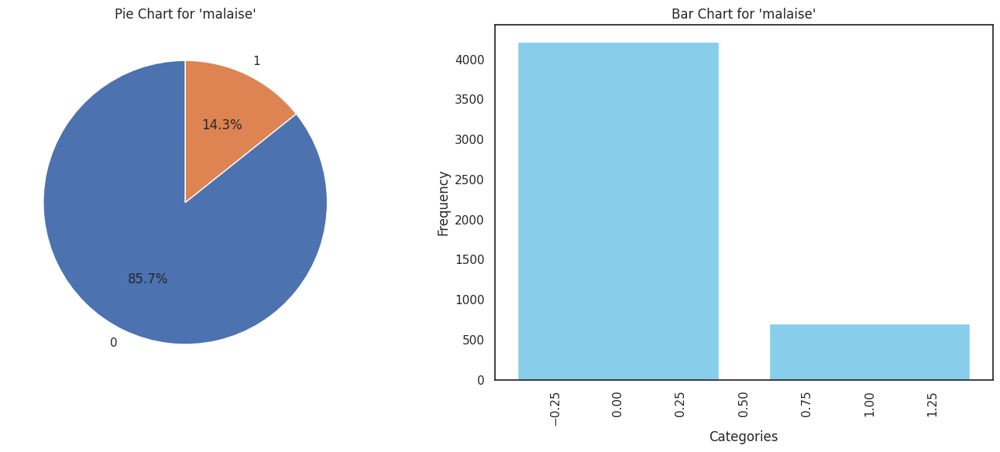

>> Column 'blurred_and_distorted_vision' has 2 unique categories.

blurred_and_distorted_vision
0    4578
1     342
Name: count, dtype: int64


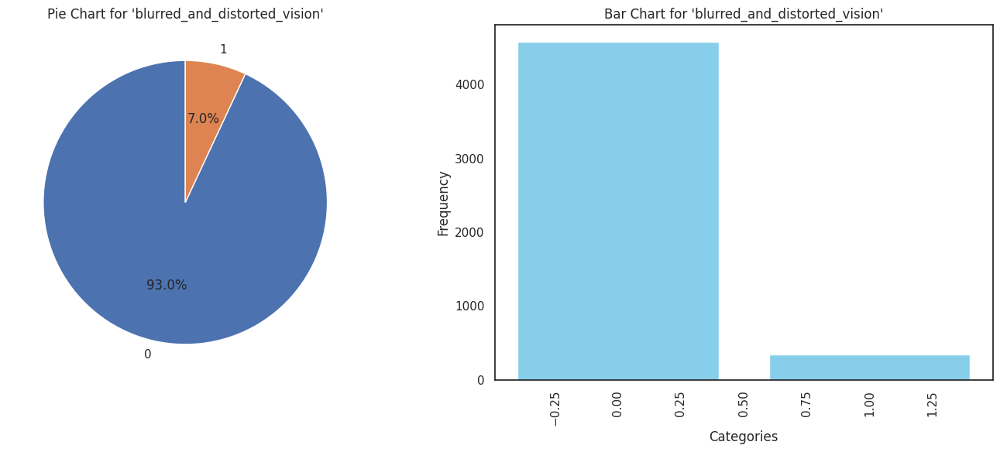

>> Column 'phlegm' has 2 unique categories.

phlegm
0    4566
1     354
Name: count, dtype: int64


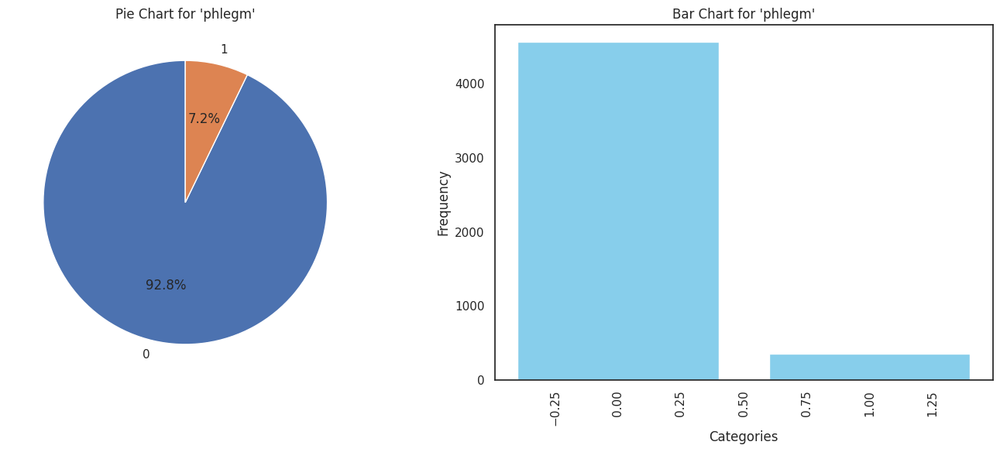

>> Column 'throat_irritation' has 2 unique categories.

throat_irritation
0    4800
1     120
Name: count, dtype: int64


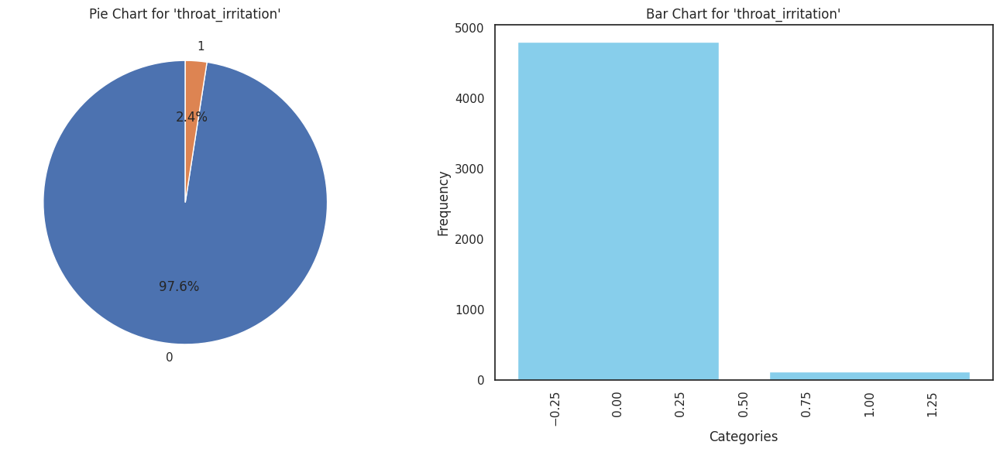

>> Column 'redness_of_eyes' has 2 unique categories.

redness_of_eyes
0    4800
1     120
Name: count, dtype: int64


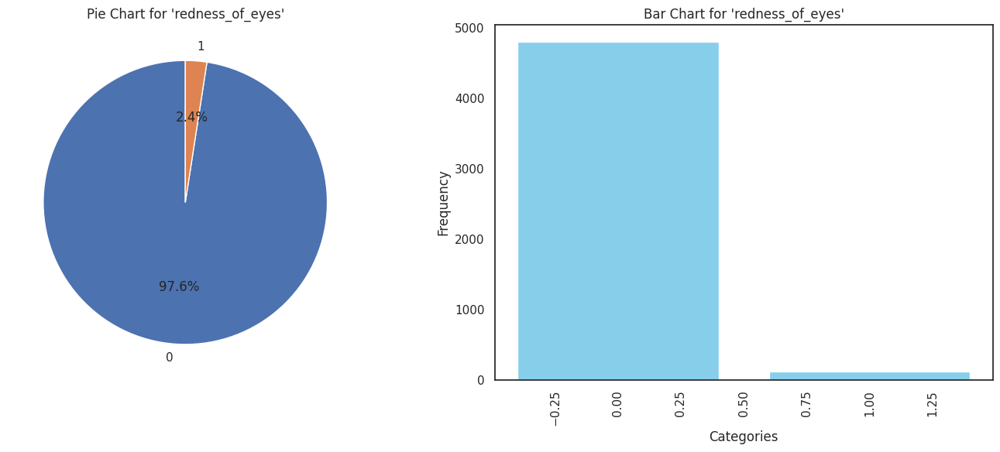

>> Column 'sinus_pressure' has 2 unique categories.

sinus_pressure
0    4800
1     120
Name: count, dtype: int64


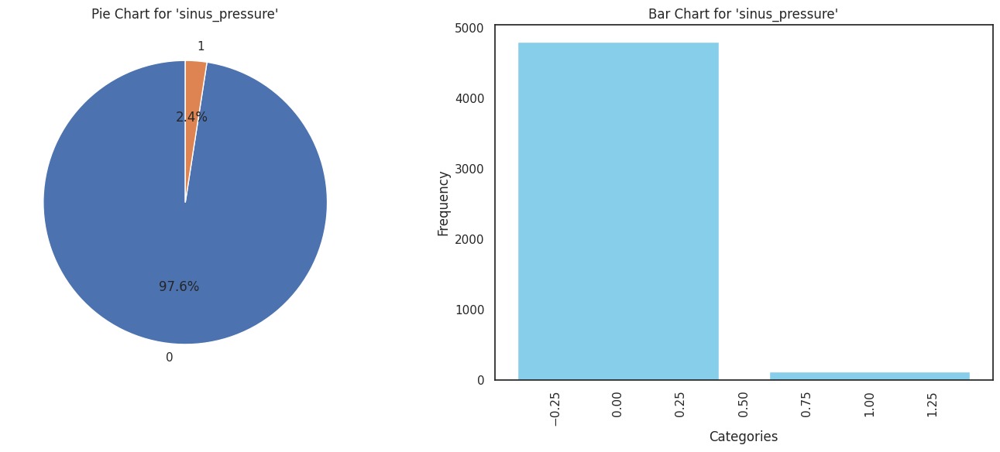

>> Column 'runny_nose' has 2 unique categories.

runny_nose
0    4800
1     120
Name: count, dtype: int64


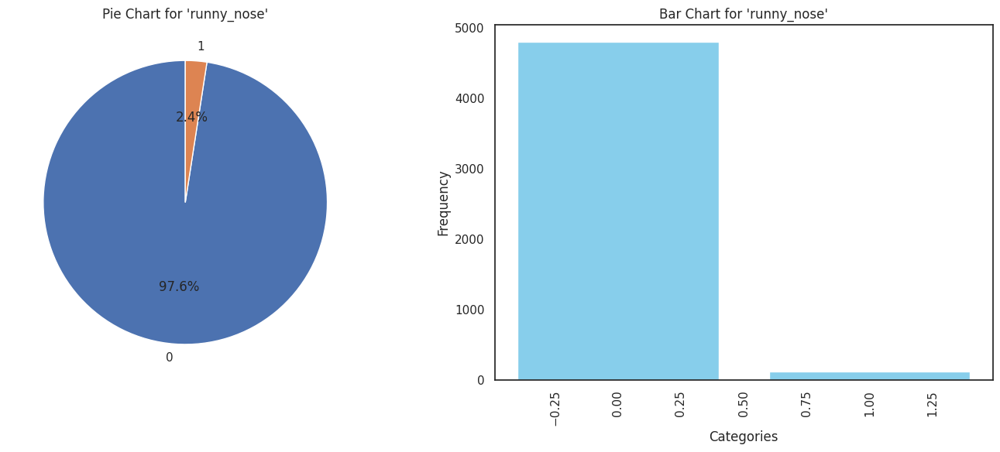

>> Column 'congestion' has 2 unique categories.

congestion
0    4800
1     120
Name: count, dtype: int64


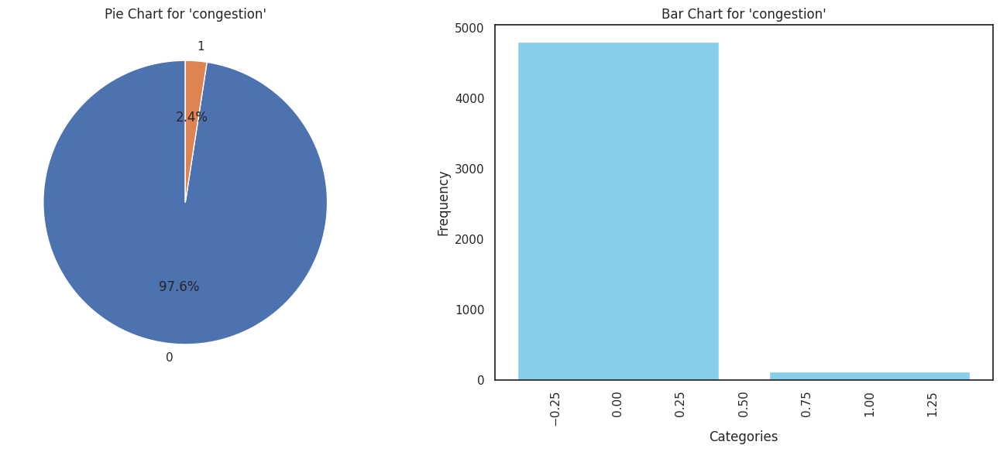

>> Column 'chest_pain' has 2 unique categories.

chest_pain
0    4224
1     696
Name: count, dtype: int64


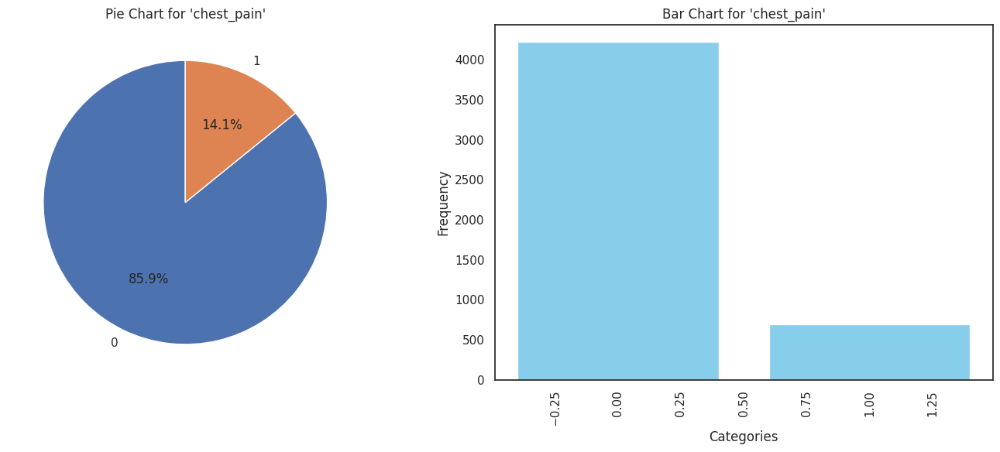

>> Column 'weakness_in_limbs' has 2 unique categories.

weakness_in_limbs
0    4812
1     108
Name: count, dtype: int64


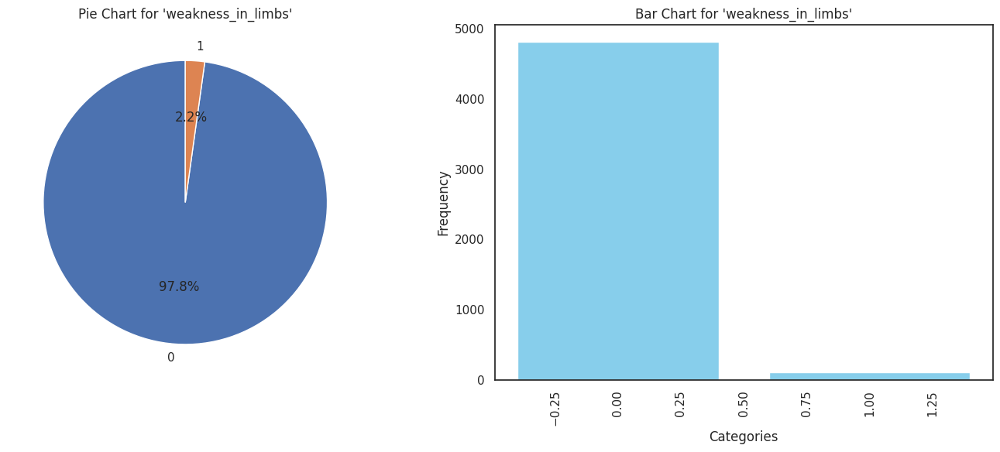

>> Column 'fast_heart_rate' has 2 unique categories.

fast_heart_rate
0    4686
1     234
Name: count, dtype: int64


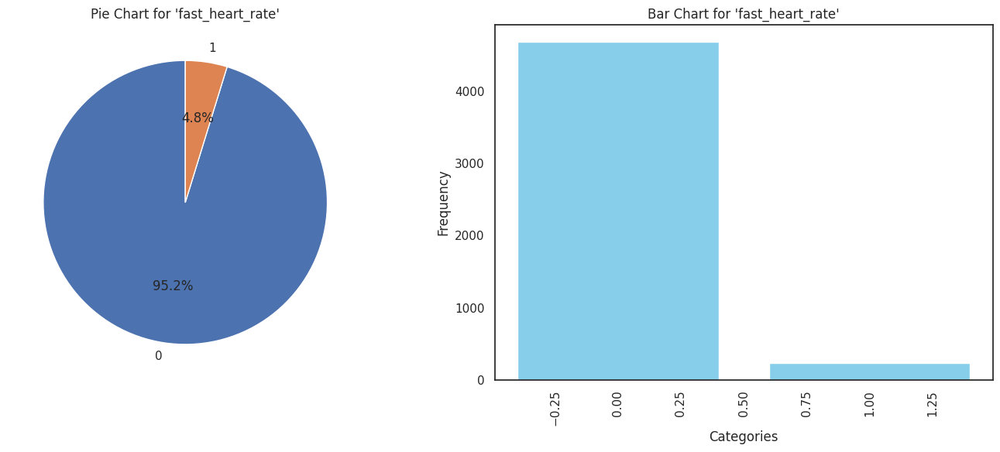

>> Column 'pain_during_bowel_movements' has 2 unique categories.

pain_during_bowel_movements
0    4806
1     114
Name: count, dtype: int64


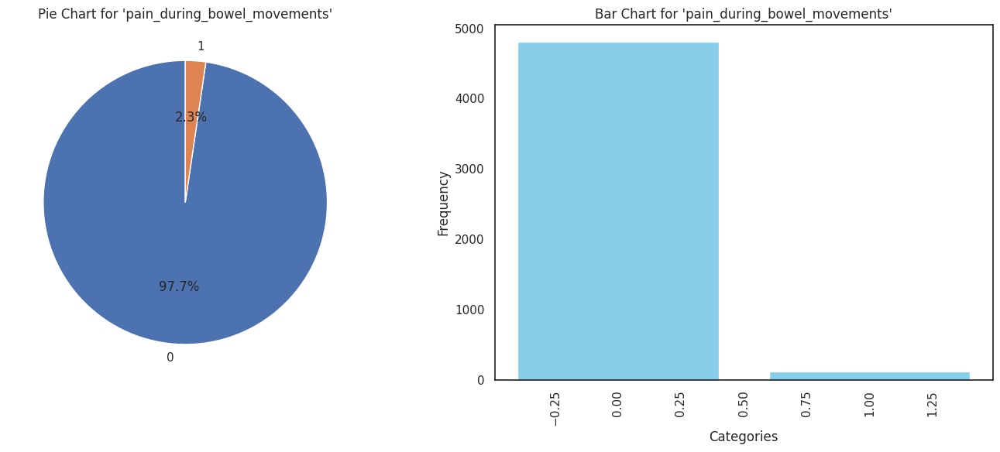

>> Column 'pain_in_anal_region' has 2 unique categories.

pain_in_anal_region
0    4806
1     114
Name: count, dtype: int64


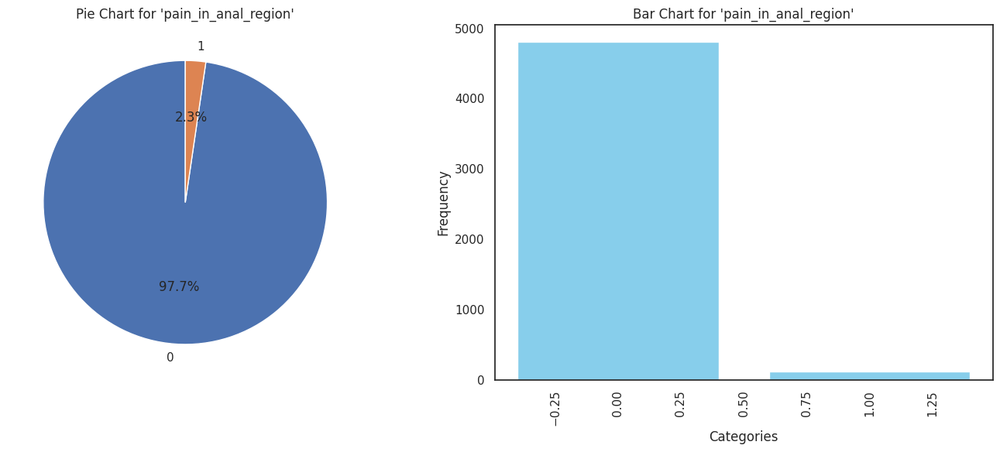

>> Column 'bloody_stool' has 2 unique categories.

bloody_stool
0    4806
1     114
Name: count, dtype: int64


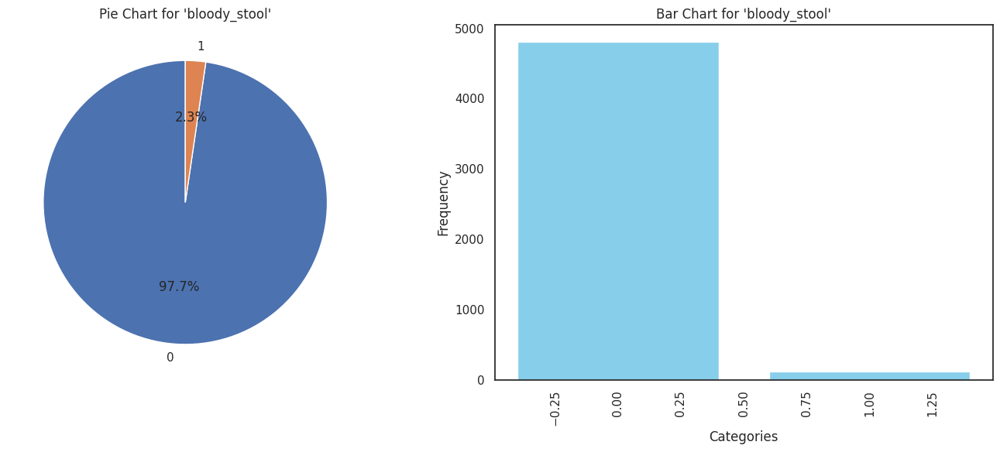

>> Column 'irritation_in_anus' has 2 unique categories.

irritation_in_anus
0    4806
1     114
Name: count, dtype: int64


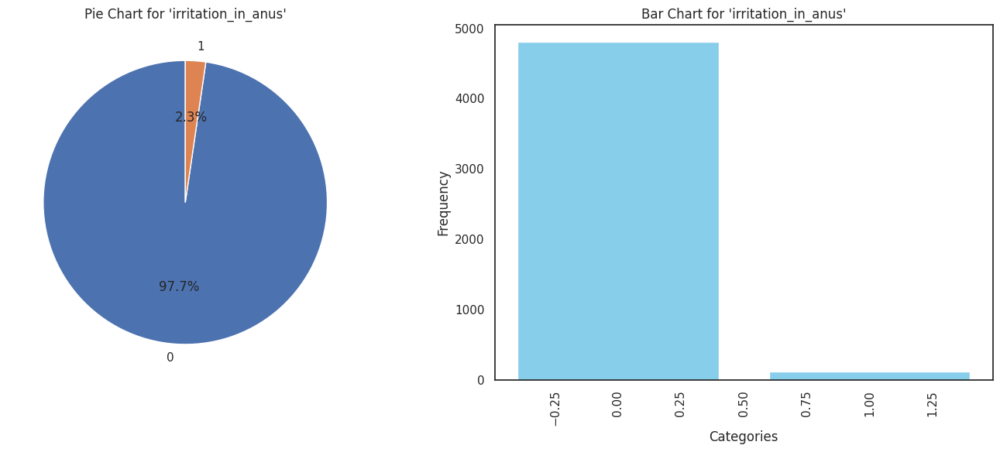

>> Column 'neck_pain' has 2 unique categories.

neck_pain
0    4692
1     228
Name: count, dtype: int64


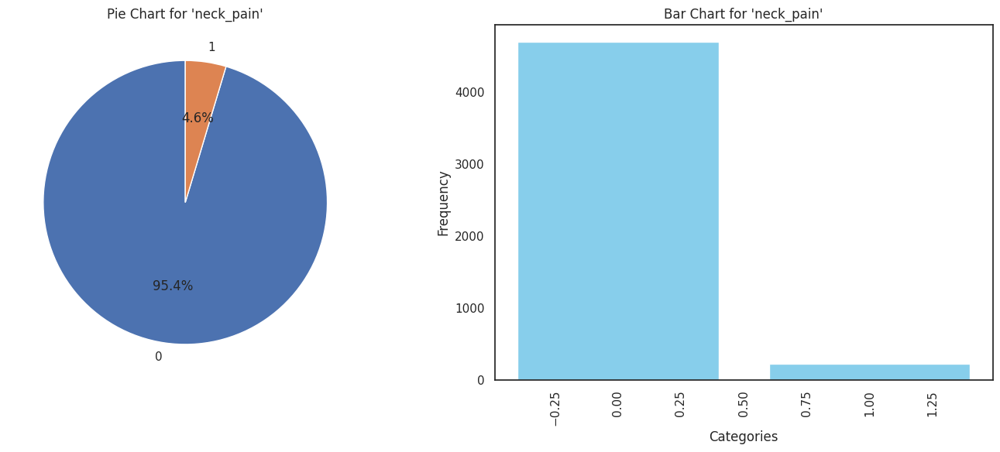

>> Column 'dizziness' has 2 unique categories.

dizziness
0    4584
1     336
Name: count, dtype: int64


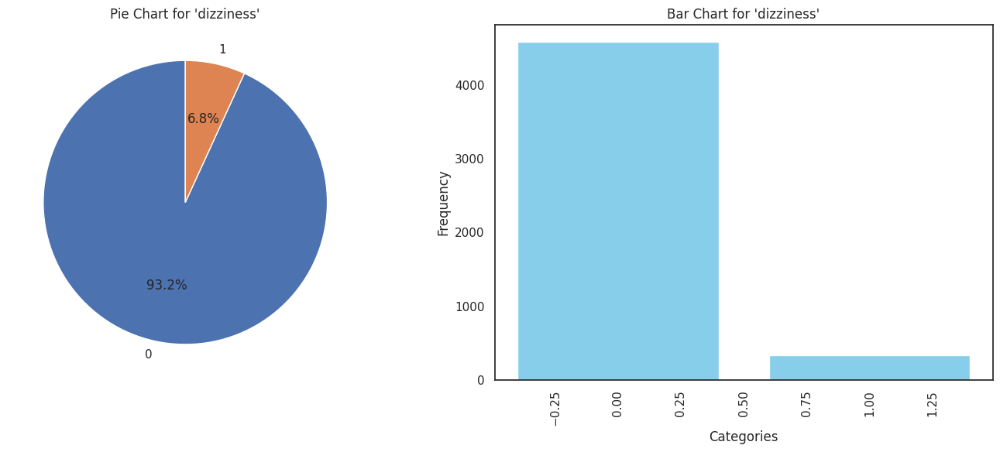

>> Column 'cramps' has 2 unique categories.

cramps
0    4806
1     114
Name: count, dtype: int64


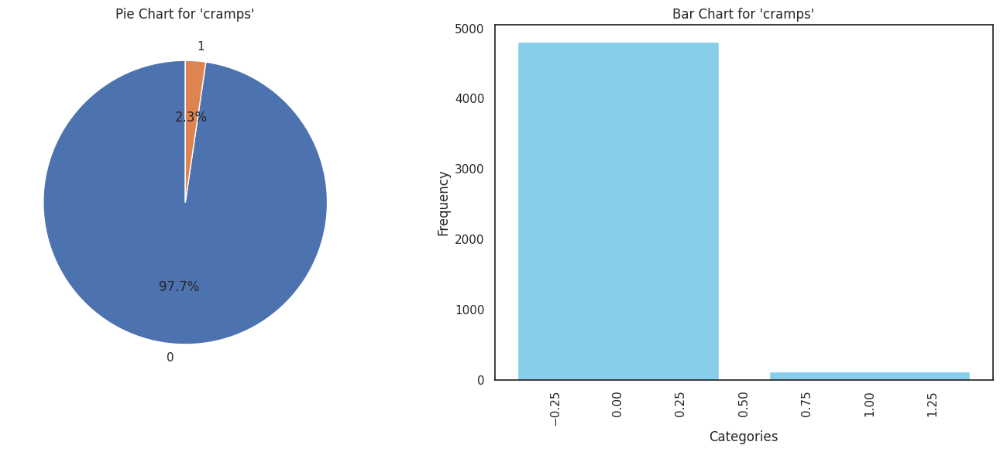

>> Column 'bruising' has 2 unique categories.

bruising
0    4806
1     114
Name: count, dtype: int64


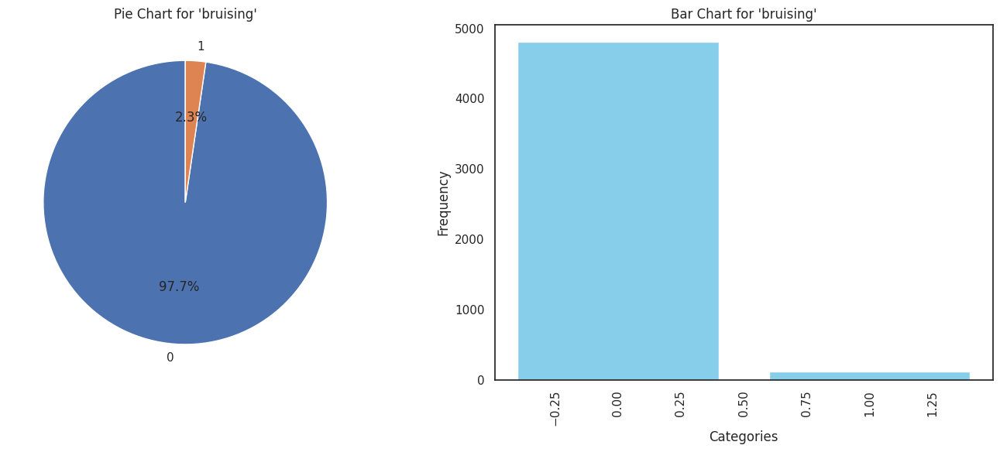

>> Column 'obesity' has 2 unique categories.

obesity
0    4692
1     228
Name: count, dtype: int64


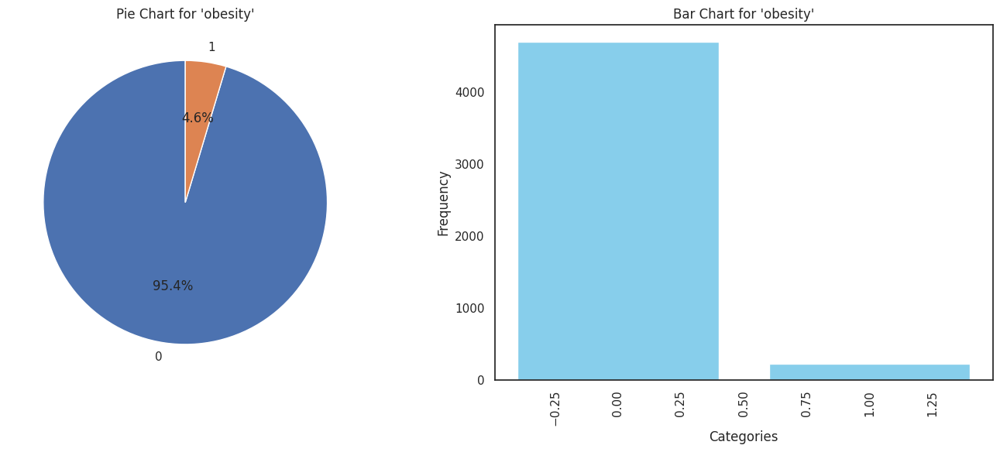

>> Column 'swollen_legs' has 2 unique categories.

swollen_legs
0    4806
1     114
Name: count, dtype: int64


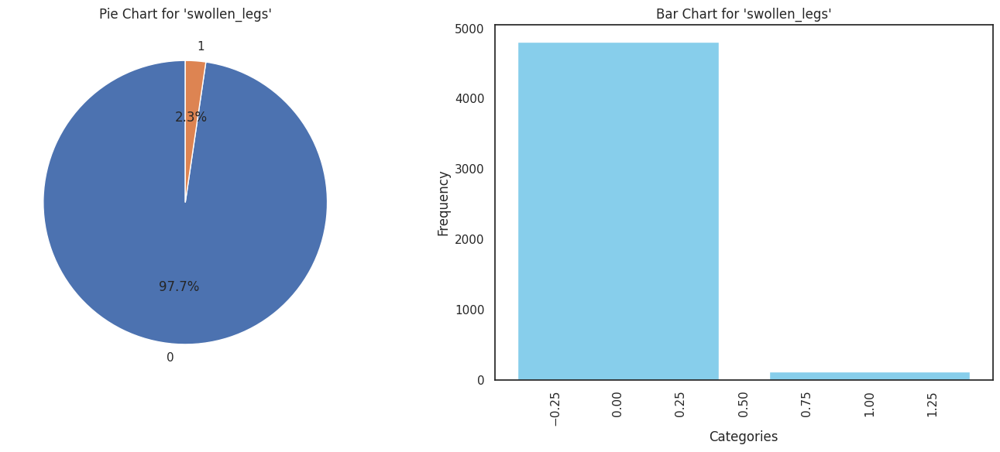

>> Column 'swollen_blood_vessels' has 2 unique categories.

swollen_blood_vessels
0    4812
1     108
Name: count, dtype: int64


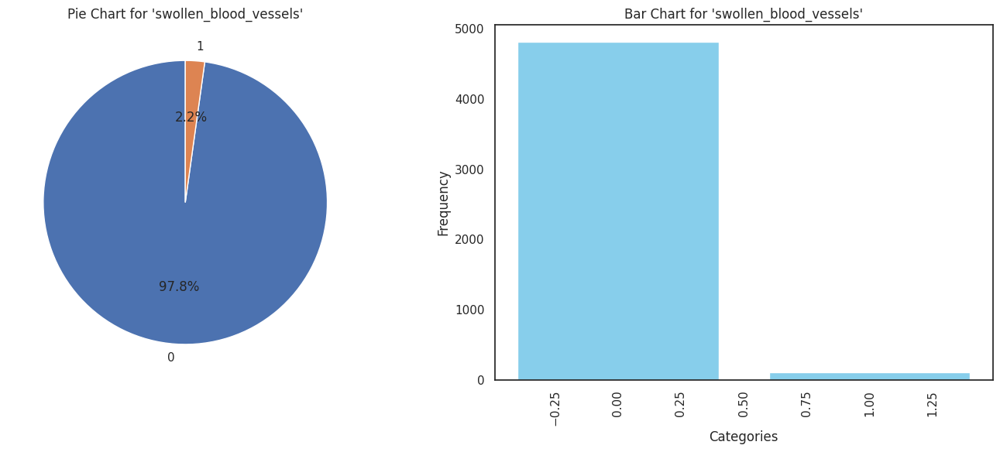

>> Column 'puffy_face_and_eyes' has 2 unique categories.

puffy_face_and_eyes
0    4806
1     114
Name: count, dtype: int64


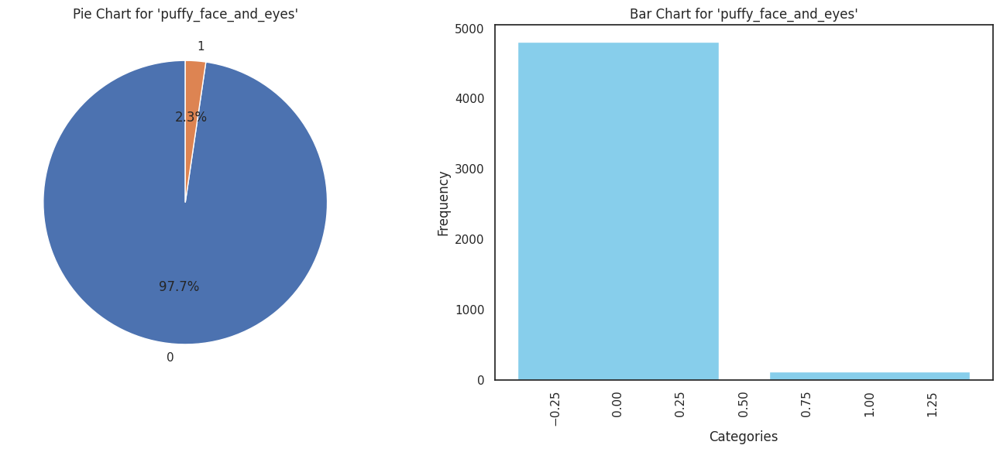

>> Column 'enlarged_thyroid' has 2 unique categories.

enlarged_thyroid
0    4800
1     120
Name: count, dtype: int64


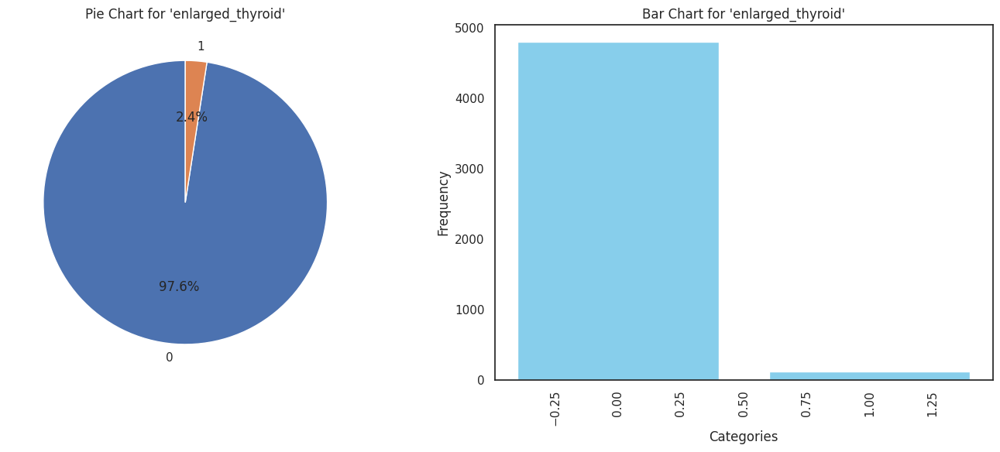

>> Column 'brittle_nails' has 2 unique categories.

brittle_nails
0    4800
1     120
Name: count, dtype: int64


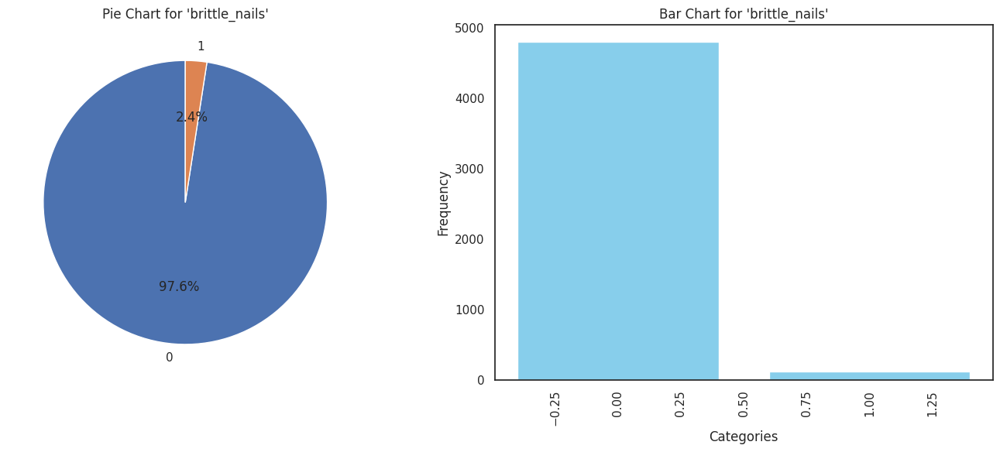

>> Column 'swollen_extremeties' has 2 unique categories.

swollen_extremeties
0    4800
1     120
Name: count, dtype: int64


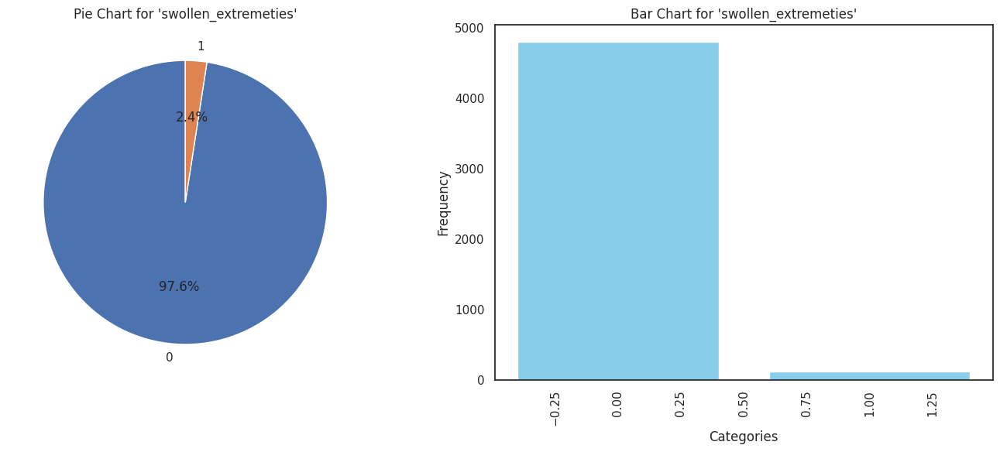

>> Column 'excessive_hunger' has 2 unique categories.

excessive_hunger
0    4458
1     462
Name: count, dtype: int64


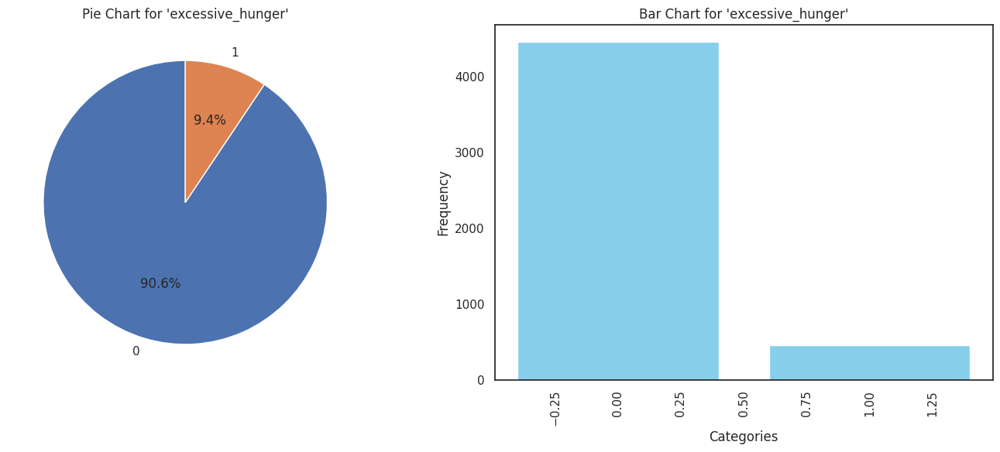

>> Column 'extra_marital_contacts' has 2 unique categories.

extra_marital_contacts
0    4812
1     108
Name: count, dtype: int64


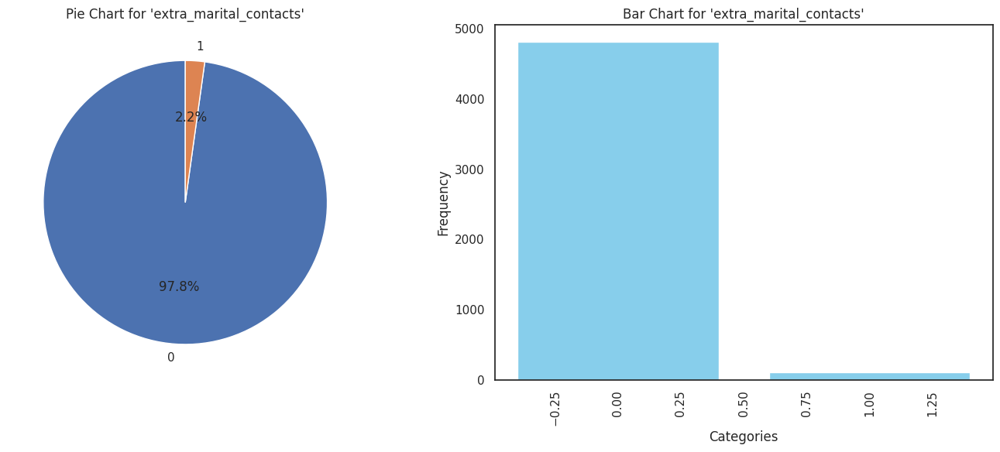

>> Column 'drying_and_tingling_lips' has 2 unique categories.

drying_and_tingling_lips
0    4806
1     114
Name: count, dtype: int64


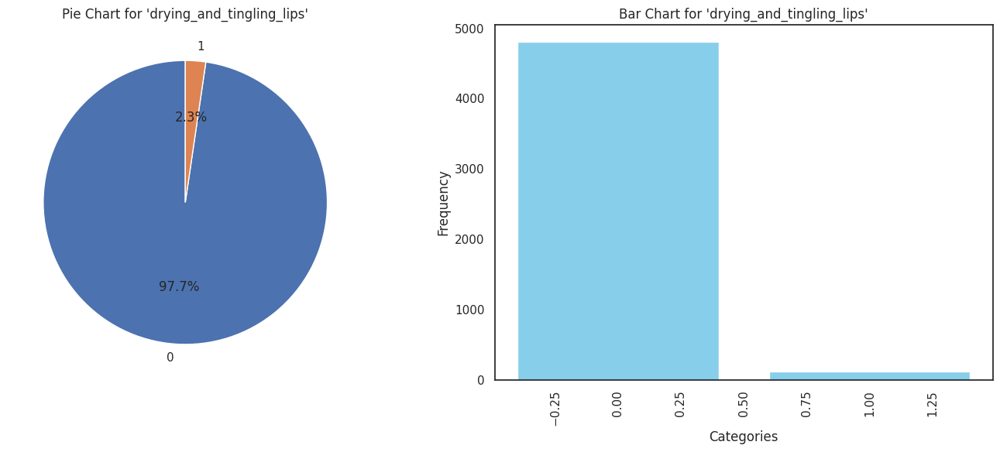

>> Column 'slurred_speech' has 2 unique categories.

slurred_speech
0    4800
1     120
Name: count, dtype: int64


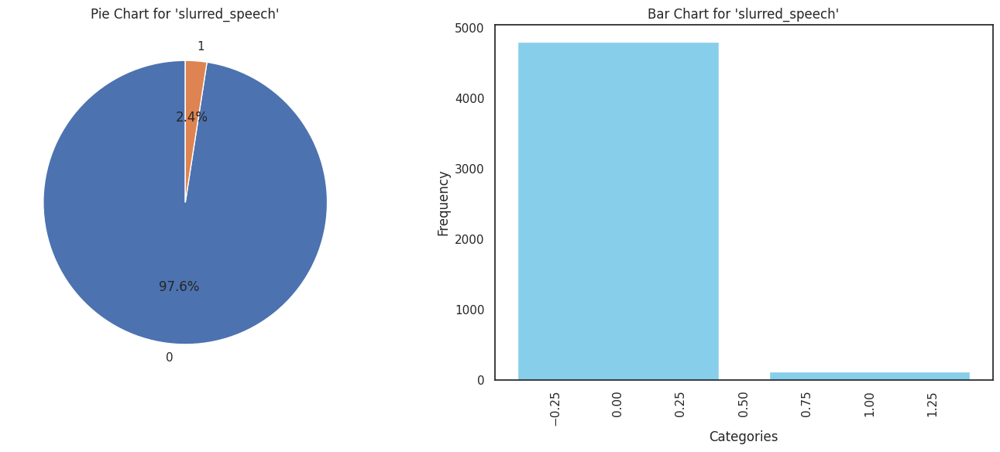

>> Column 'knee_pain' has 2 unique categories.

knee_pain
0    4806
1     114
Name: count, dtype: int64


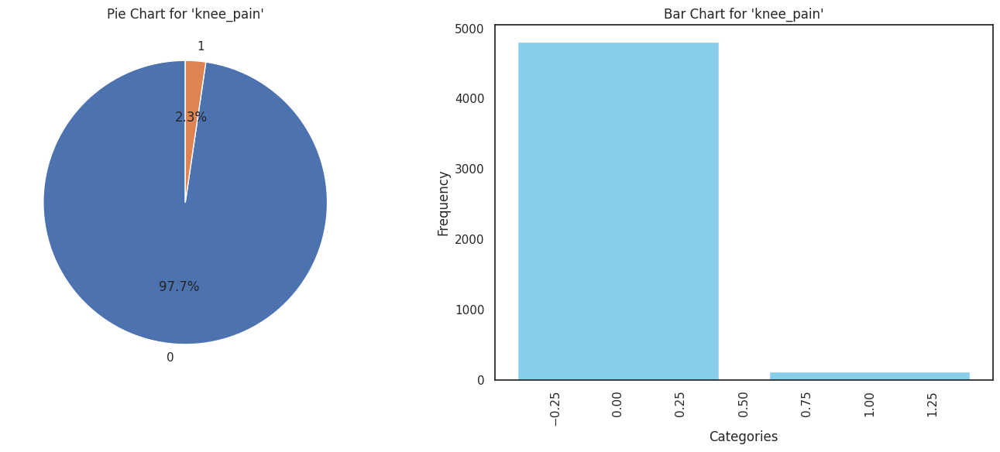

>> Column 'hip_joint_pain' has 2 unique categories.

hip_joint_pain
0    4806
1     114
Name: count, dtype: int64


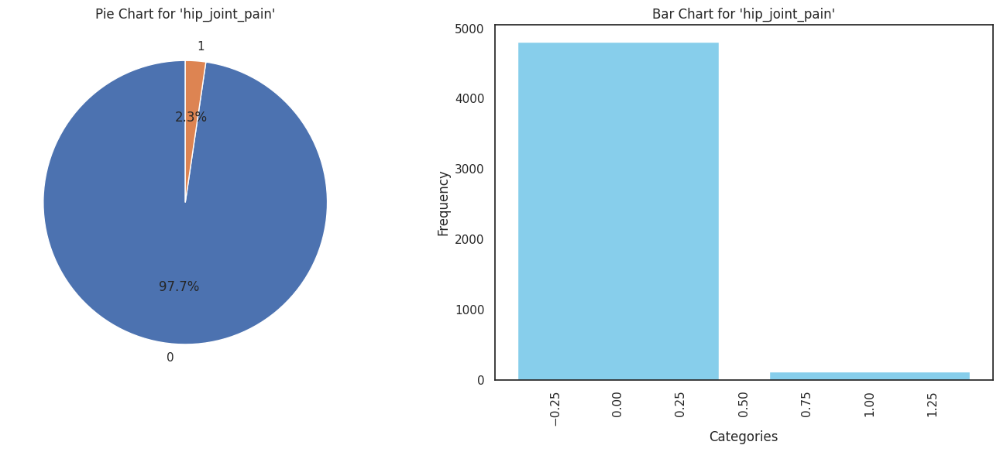

>> Column 'muscle_weakness' has 2 unique categories.

muscle_weakness
0    4686
1     234
Name: count, dtype: int64


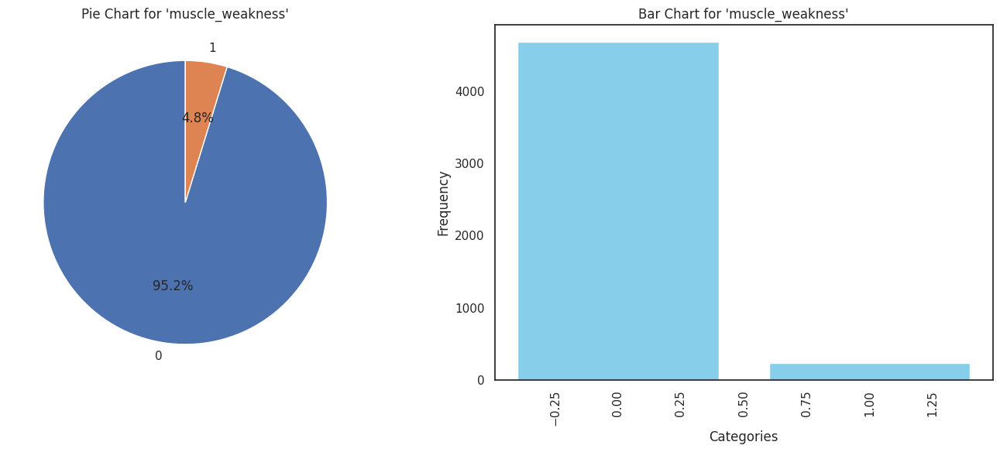

>> Column 'stiff_neck' has 2 unique categories.

stiff_neck
0    4692
1     228
Name: count, dtype: int64


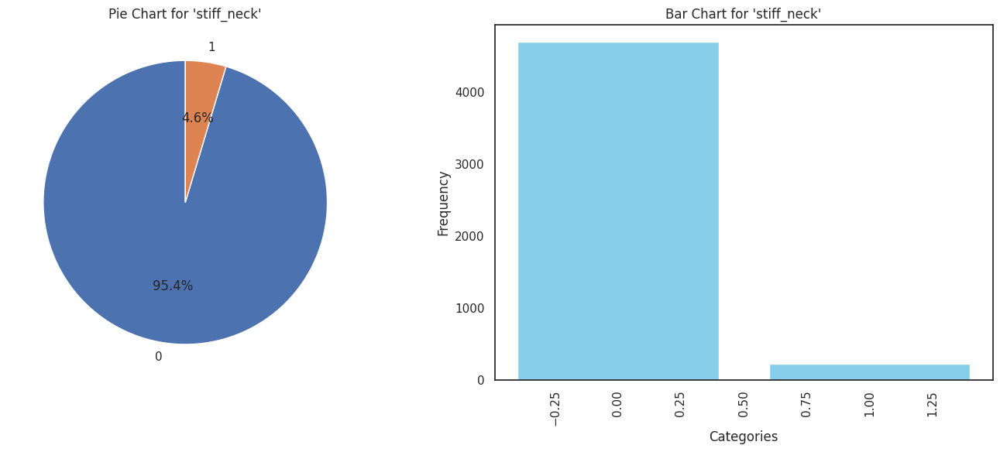

>> Column 'swelling_joints' has 2 unique categories.

swelling_joints
0    4692
1     228
Name: count, dtype: int64


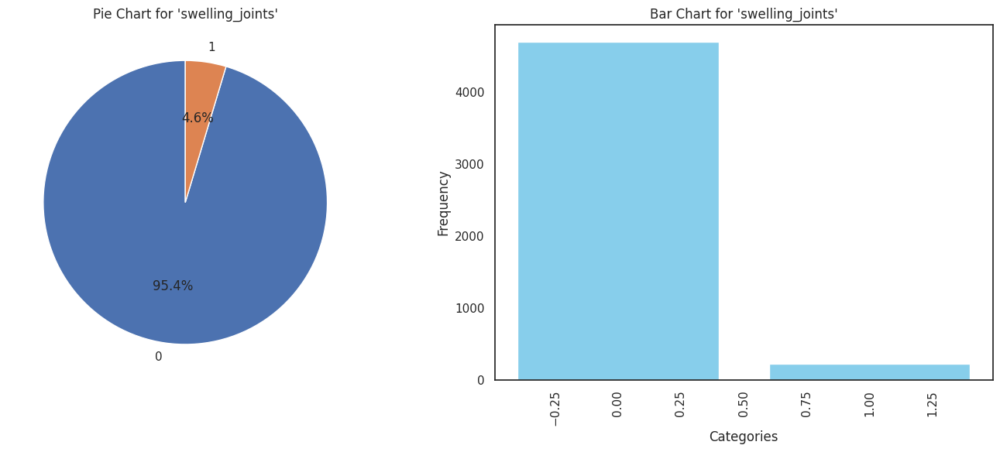

>> Column 'movement_stiffness' has 2 unique categories.

movement_stiffness
0    4806
1     114
Name: count, dtype: int64


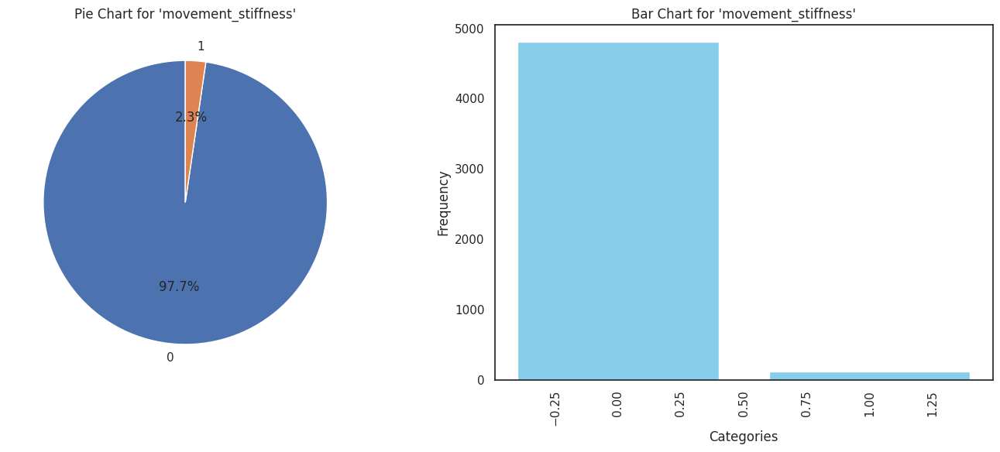

>> Column 'spinning_movements' has 2 unique categories.

spinning_movements
0    4812
1     108
Name: count, dtype: int64


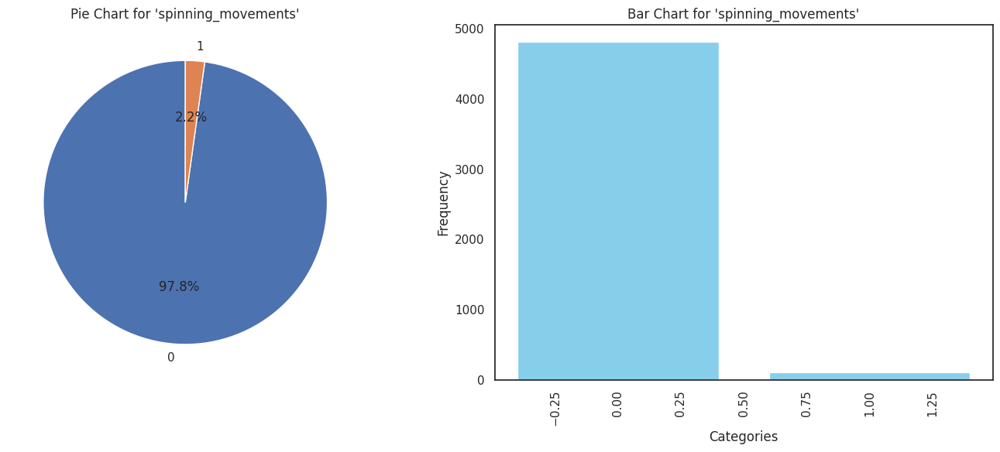

>> Column 'loss_of_balance' has 2 unique categories.

loss_of_balance
0    4578
1     342
Name: count, dtype: int64


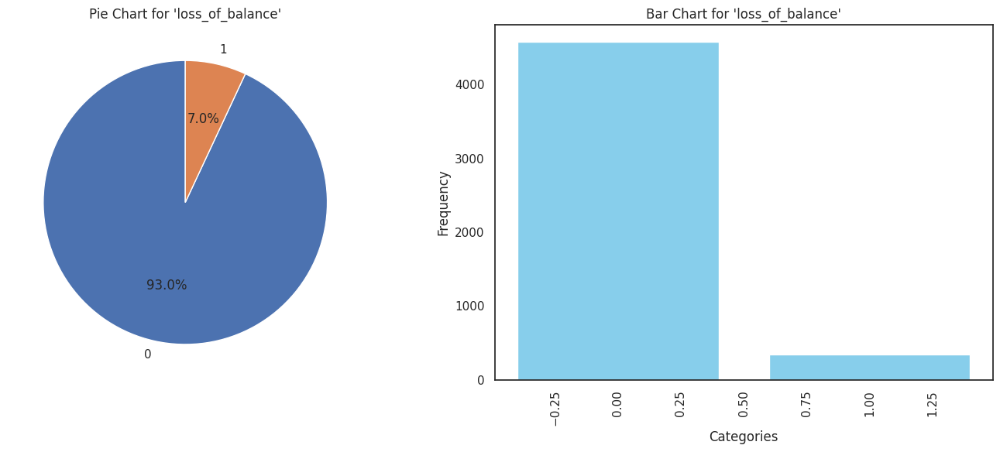

>> Column 'unsteadiness' has 2 unique categories.

unsteadiness
0    4806
1     114
Name: count, dtype: int64


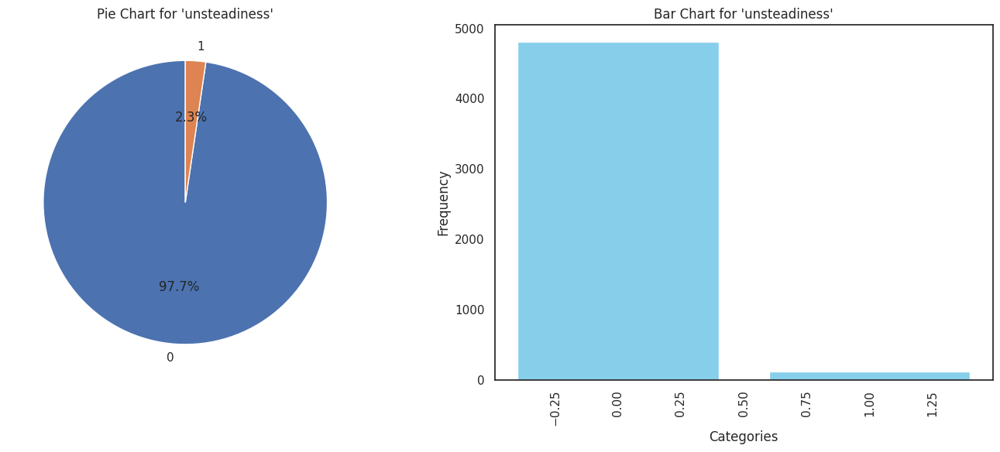

>> Column 'weakness_of_one_body_side' has 2 unique categories.

weakness_of_one_body_side
0    4812
1     108
Name: count, dtype: int64


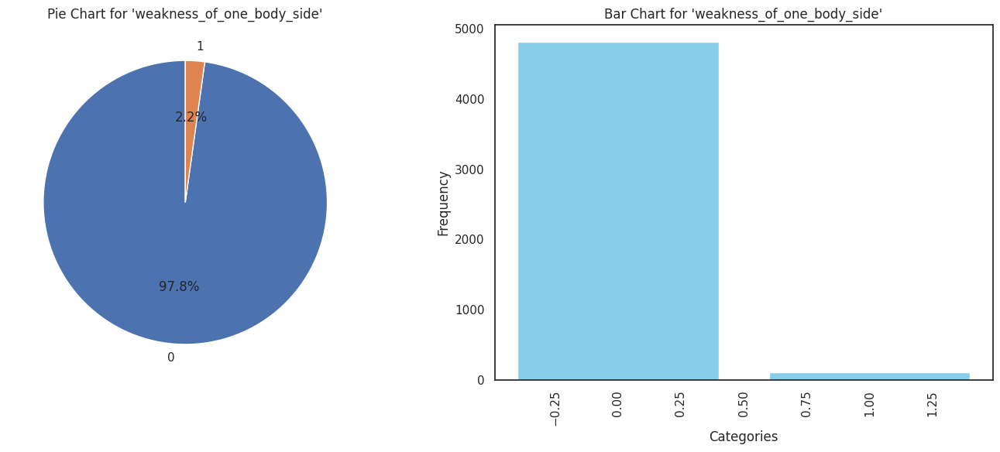

>> Column 'loss_of_smell' has 2 unique categories.

loss_of_smell
0    4800
1     120
Name: count, dtype: int64


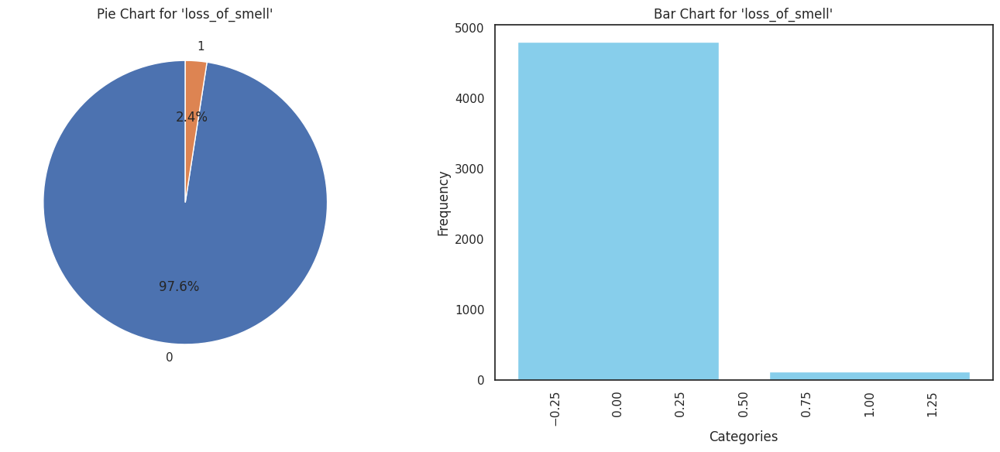

>> Column 'bladder_discomfort' has 2 unique categories.

bladder_discomfort
0    4806
1     114
Name: count, dtype: int64


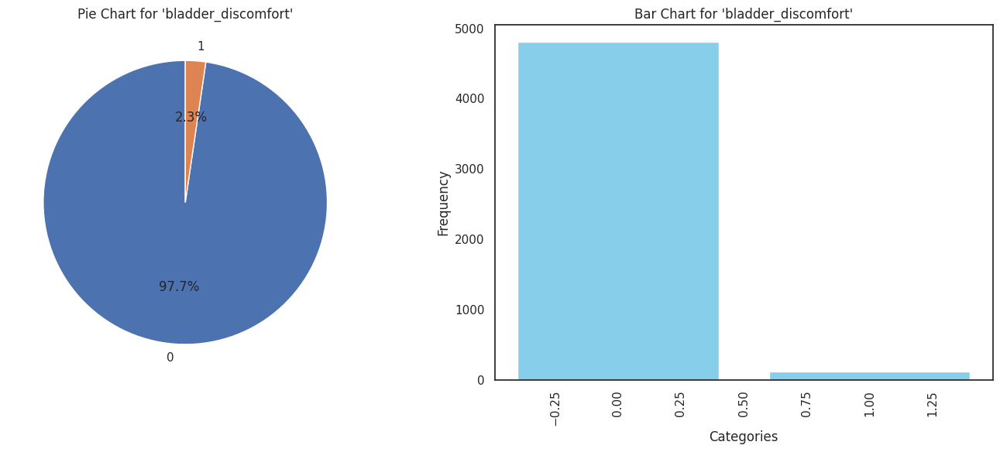

>> Column 'foul_smell_of urine' has 2 unique categories.

foul_smell_of urine
0    4818
1     102
Name: count, dtype: int64


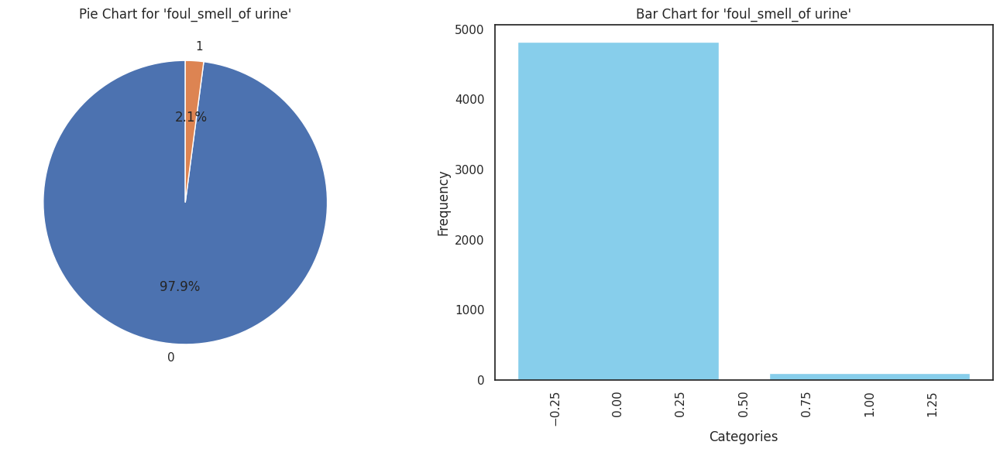

>> Column 'continuous_feel_of_urine' has 2 unique categories.

continuous_feel_of_urine
0    4806
1     114
Name: count, dtype: int64


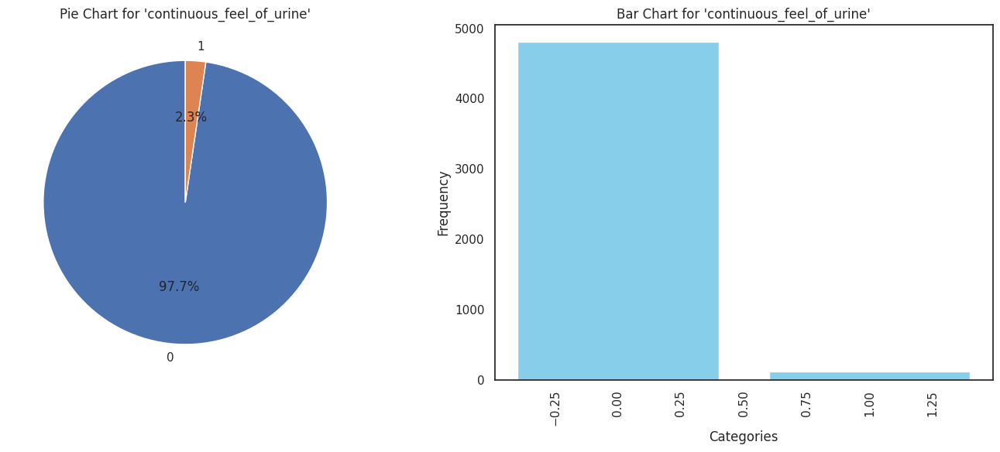

>> Column 'passage_of_gases' has 2 unique categories.

passage_of_gases
0    4806
1     114
Name: count, dtype: int64


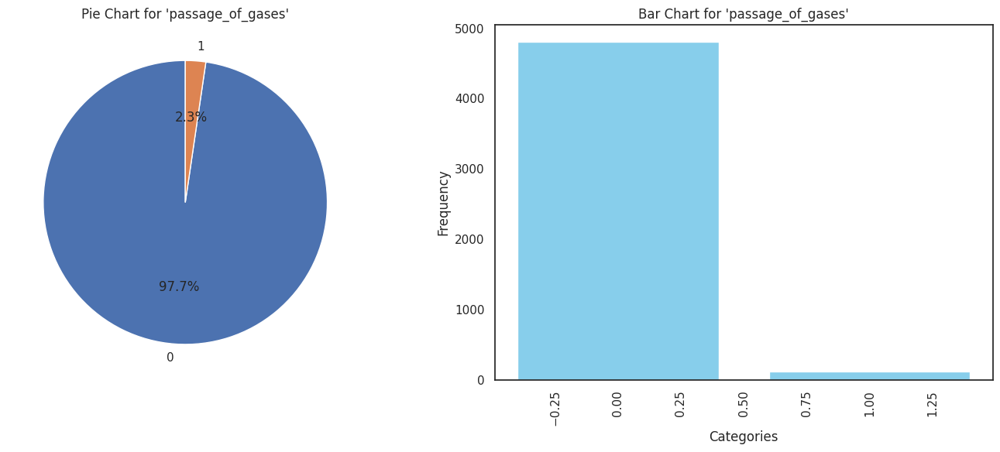

>> Column 'internal_itching' has 2 unique categories.

internal_itching
0    4806
1     114
Name: count, dtype: int64


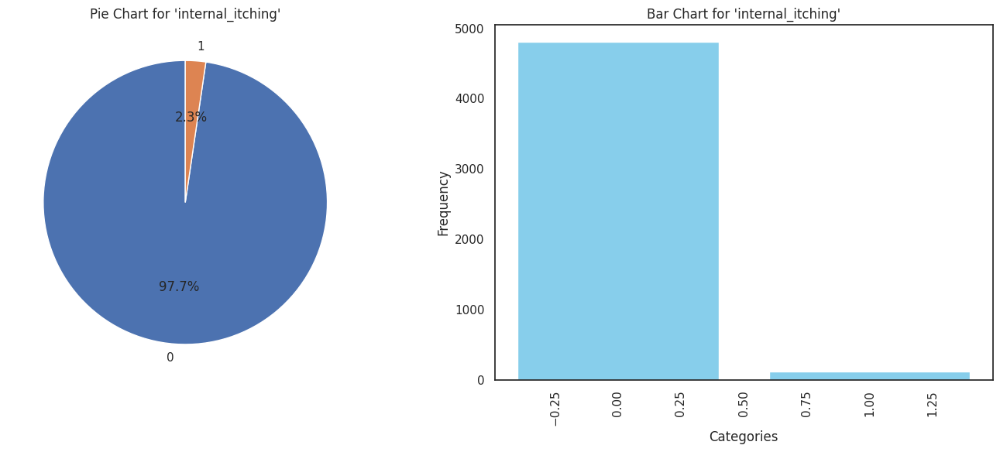

>> Column 'toxic_look_(typhos)' has 2 unique categories.

toxic_look_(typhos)
0    4806
1     114
Name: count, dtype: int64


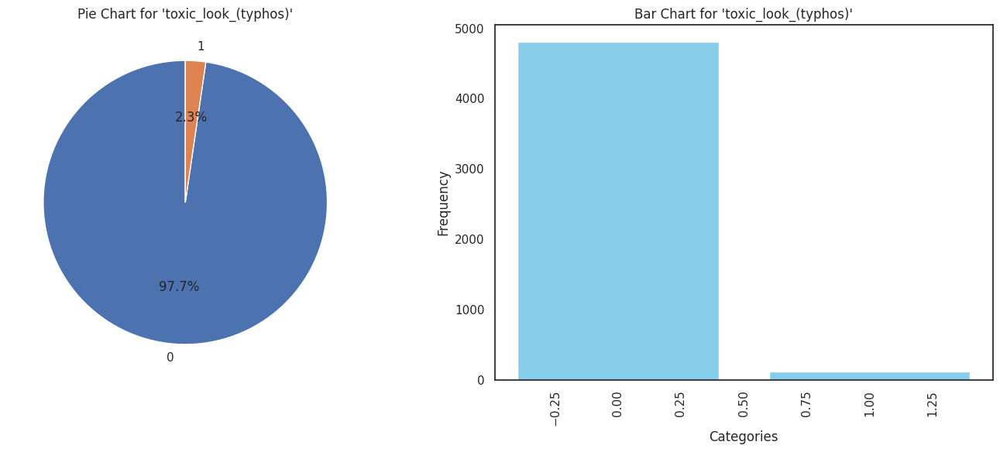

>> Column 'depression' has 2 unique categories.

depression
0    4686
1     234
Name: count, dtype: int64


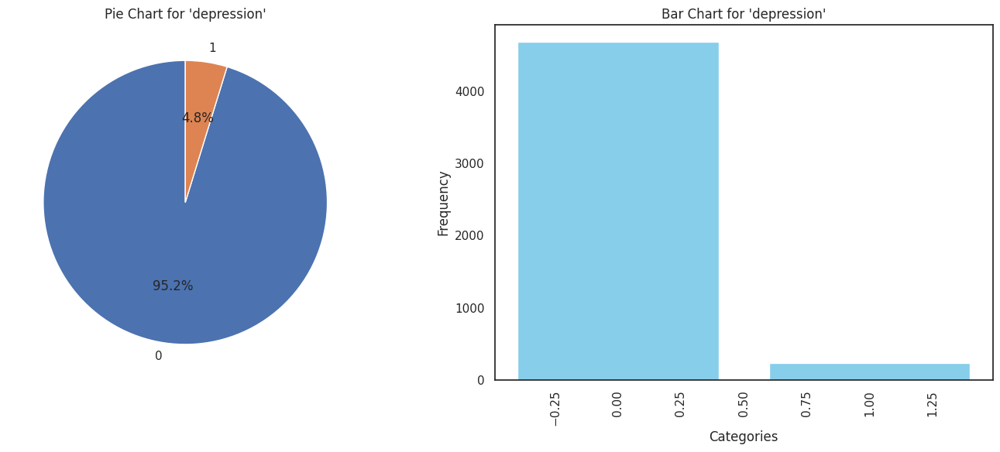

>> Column 'irritability' has 2 unique categories.

irritability
0    4446
1     474
Name: count, dtype: int64


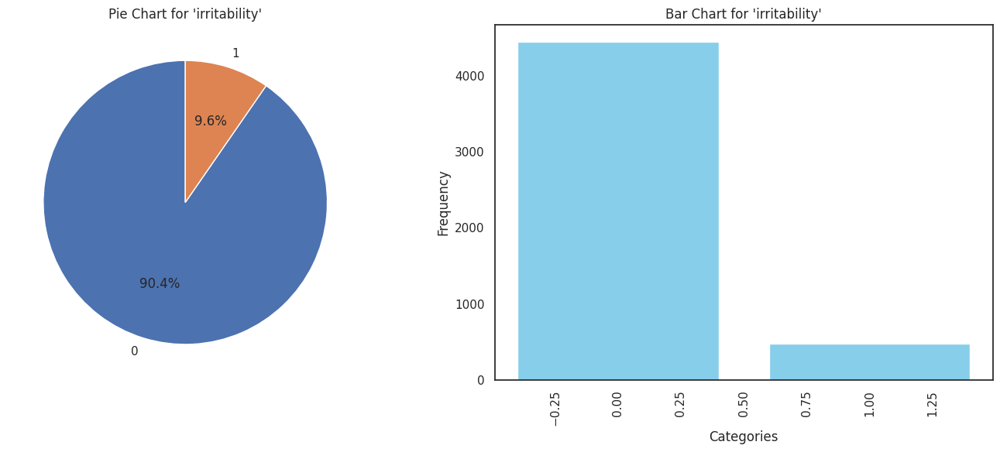

>> Column 'muscle_pain' has 2 unique categories.

muscle_pain
0    4446
1     474
Name: count, dtype: int64


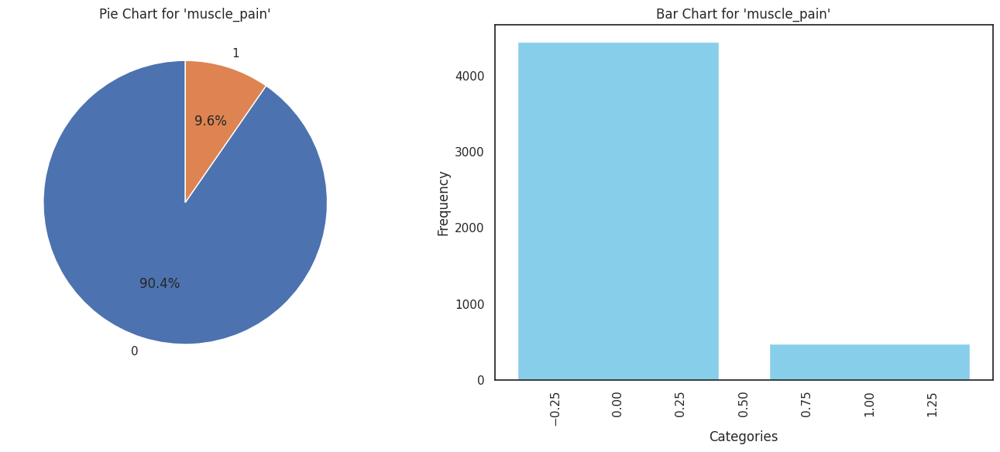

>> Column 'altered_sensorium' has 2 unique categories.

altered_sensorium
0    4806
1     114
Name: count, dtype: int64


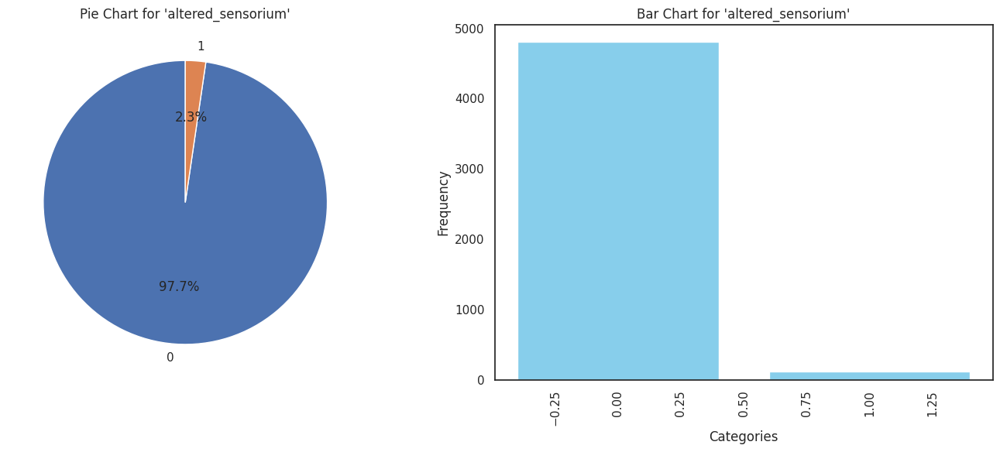

>> Column 'red_spots_over_body' has 2 unique categories.

red_spots_over_body
0    4686
1     234
Name: count, dtype: int64


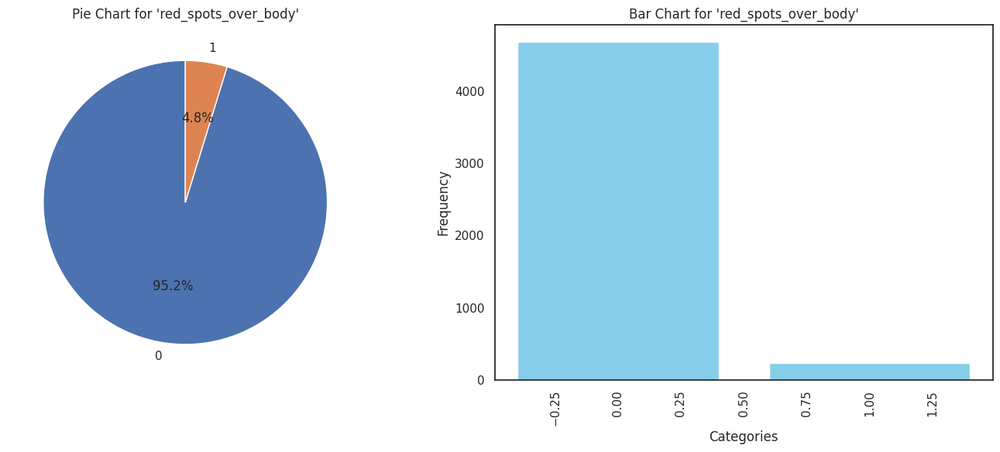

>> Column 'belly_pain' has 2 unique categories.

belly_pain
0    4806
1     114
Name: count, dtype: int64


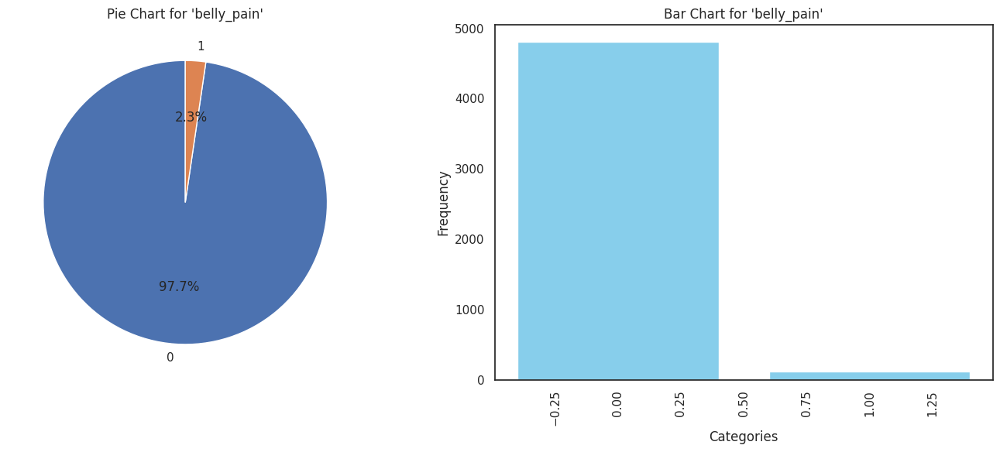

>> Column 'abnormal_menstruation' has 2 unique categories.

abnormal_menstruation
0    4680
1     240
Name: count, dtype: int64


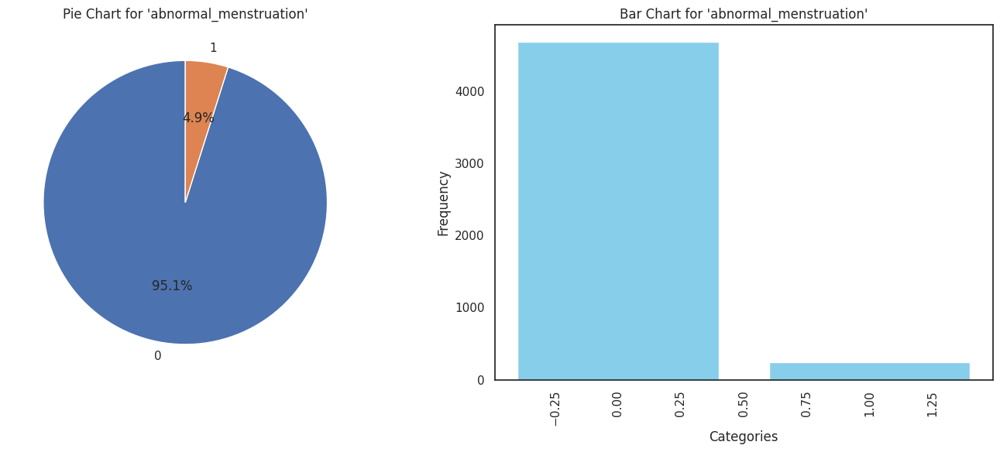

>> Column 'dischromic _patches' has 2 unique categories.

dischromic _patches
0    4812
1     108
Name: count, dtype: int64


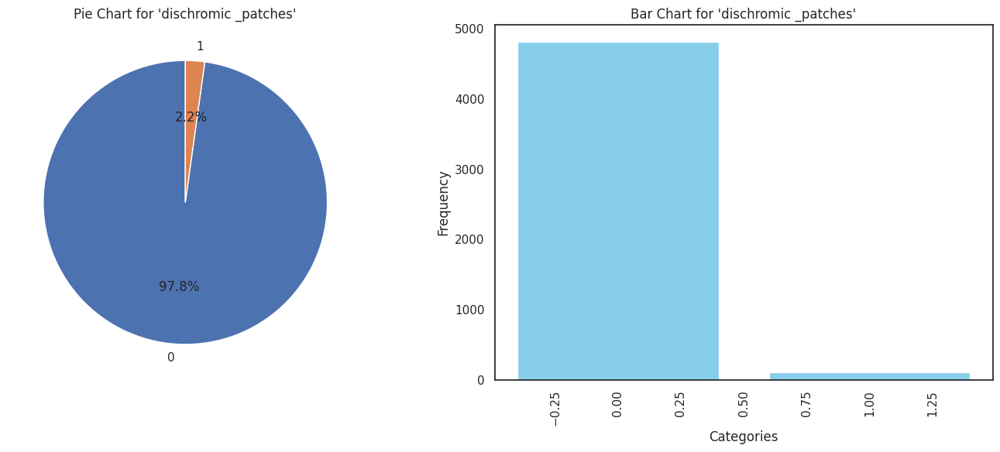

>> Column 'watering_from_eyes' has 2 unique categories.

watering_from_eyes
0    4812
1     108
Name: count, dtype: int64


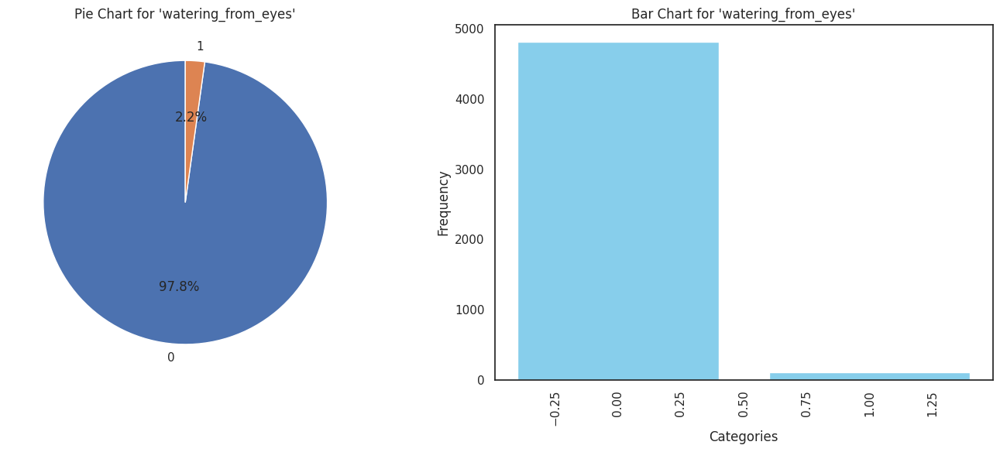

>> Column 'increased_appetite' has 2 unique categories.

increased_appetite
0    4800
1     120
Name: count, dtype: int64


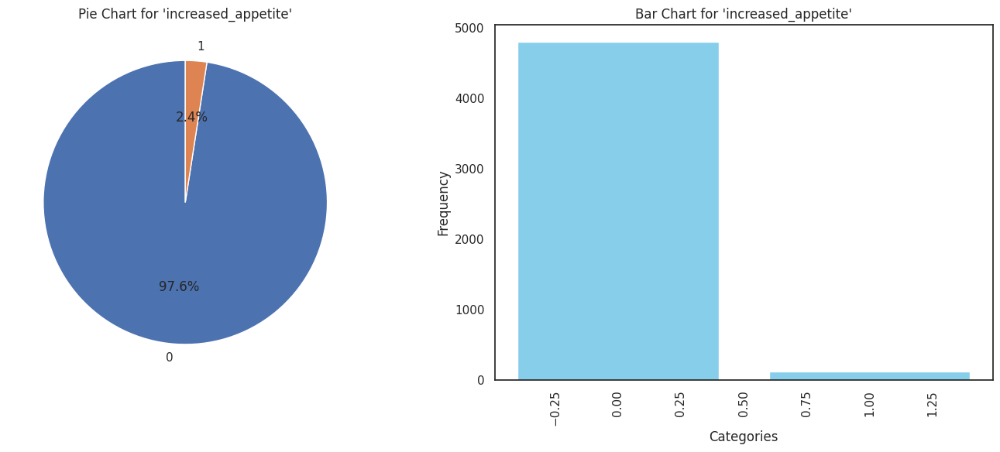

>> Column 'polyuria' has 2 unique categories.

polyuria
0    4800
1     120
Name: count, dtype: int64


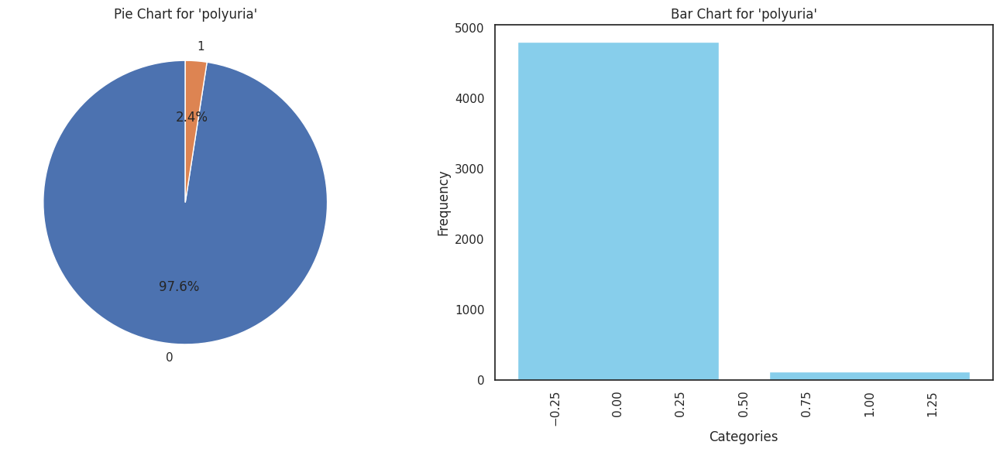

>> Column 'family_history' has 2 unique categories.

family_history
0    4692
1     228
Name: count, dtype: int64


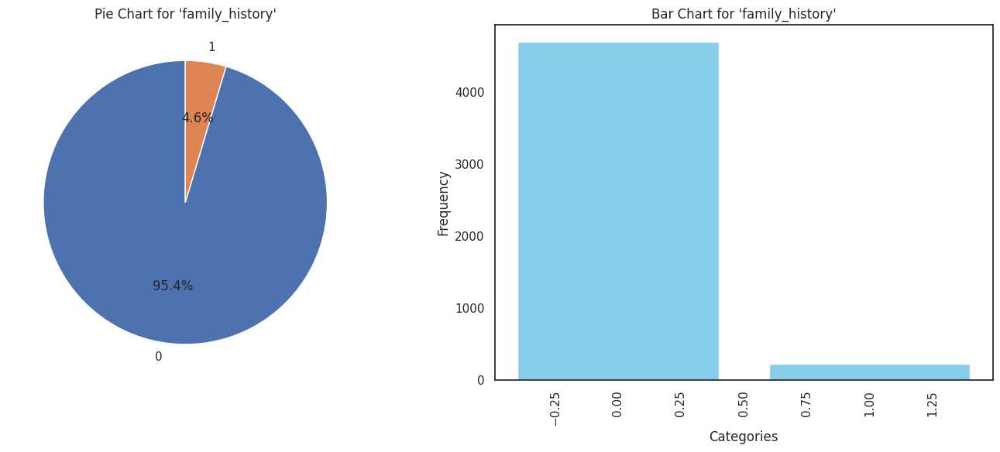

>> Column 'mucoid_sputum' has 2 unique categories.

mucoid_sputum
0    4806
1     114
Name: count, dtype: int64


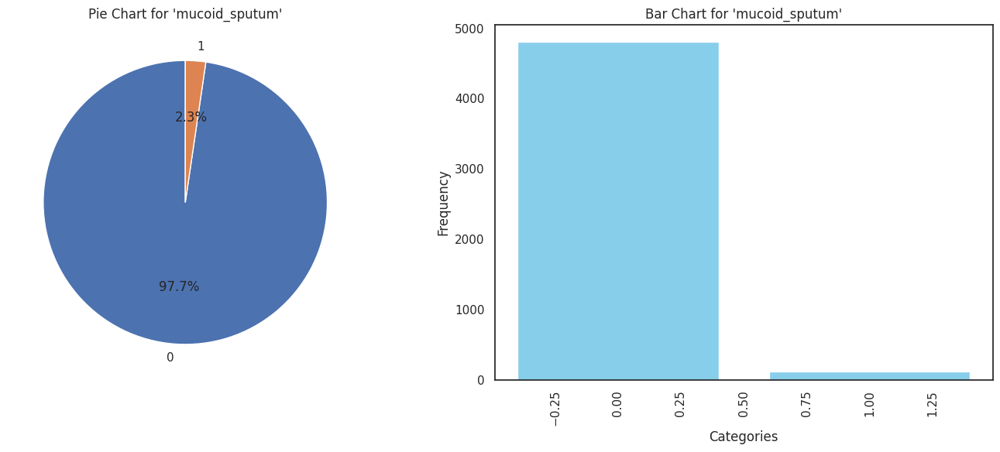

>> Column 'rusty_sputum' has 2 unique categories.

rusty_sputum
0    4800
1     120
Name: count, dtype: int64


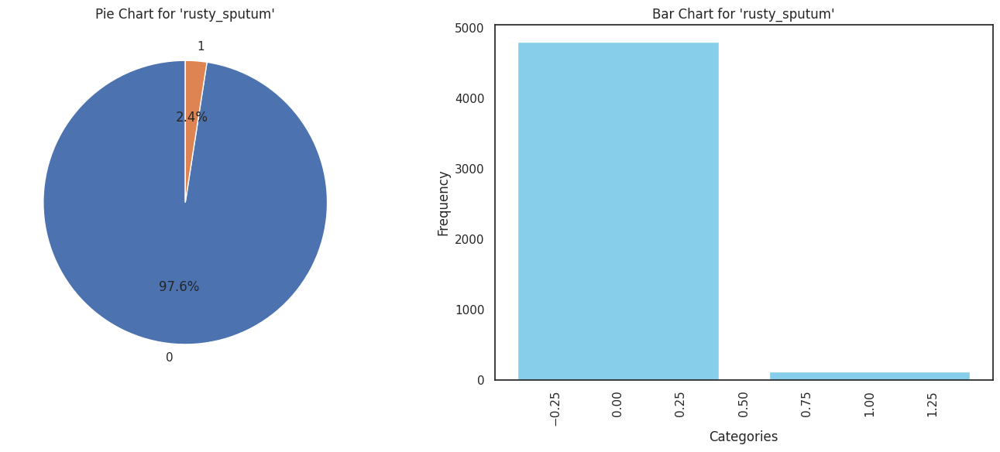

>> Column 'lack_of_concentration' has 2 unique categories.

lack_of_concentration
0    4806
1     114
Name: count, dtype: int64


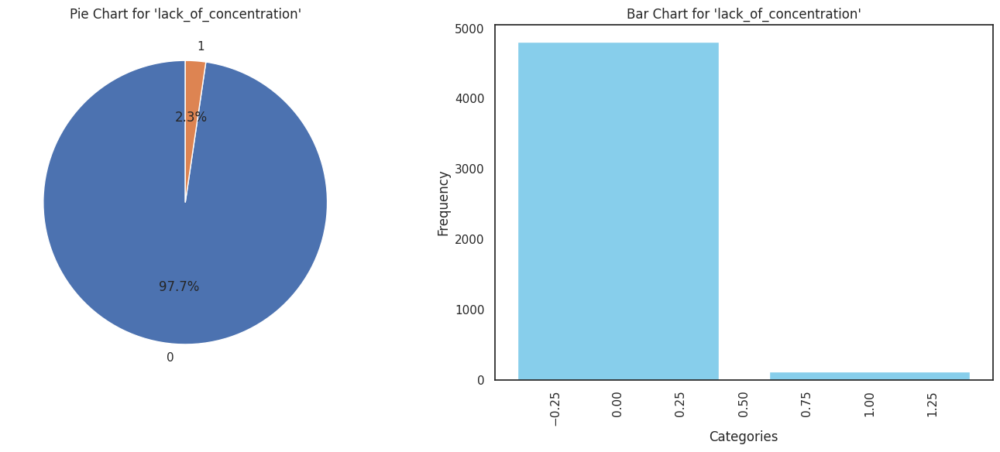

>> Column 'visual_disturbances' has 2 unique categories.

visual_disturbances
0    4806
1     114
Name: count, dtype: int64


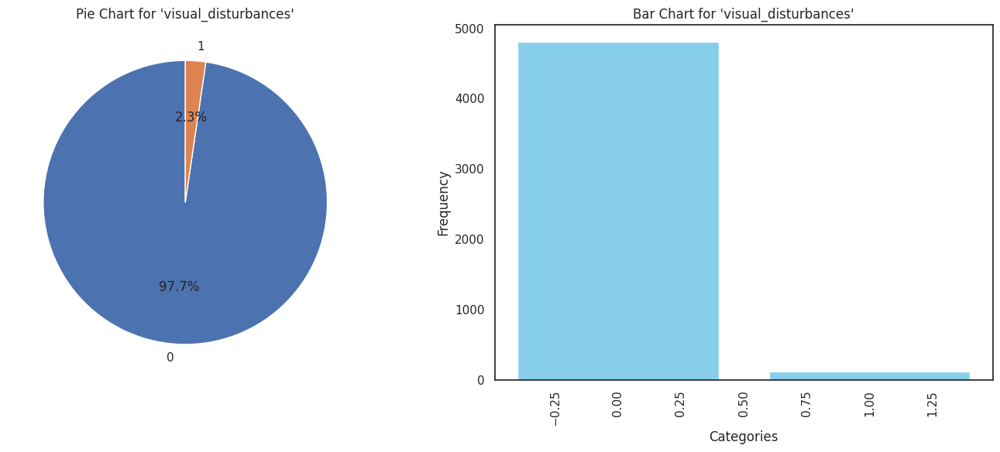

>> Column 'receiving_blood_transfusion' has 2 unique categories.

receiving_blood_transfusion
0    4800
1     120
Name: count, dtype: int64


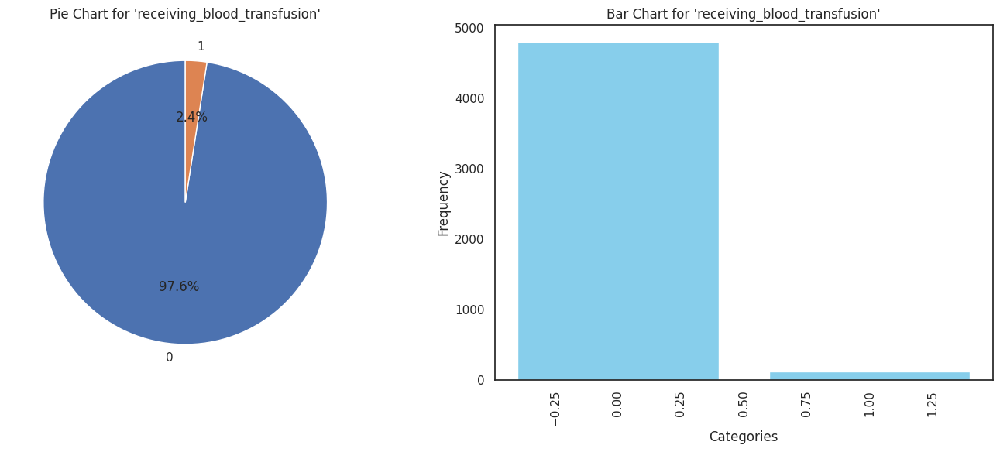

>> Column 'receiving_unsterile_injections' has 2 unique categories.

receiving_unsterile_injections
0    4800
1     120
Name: count, dtype: int64


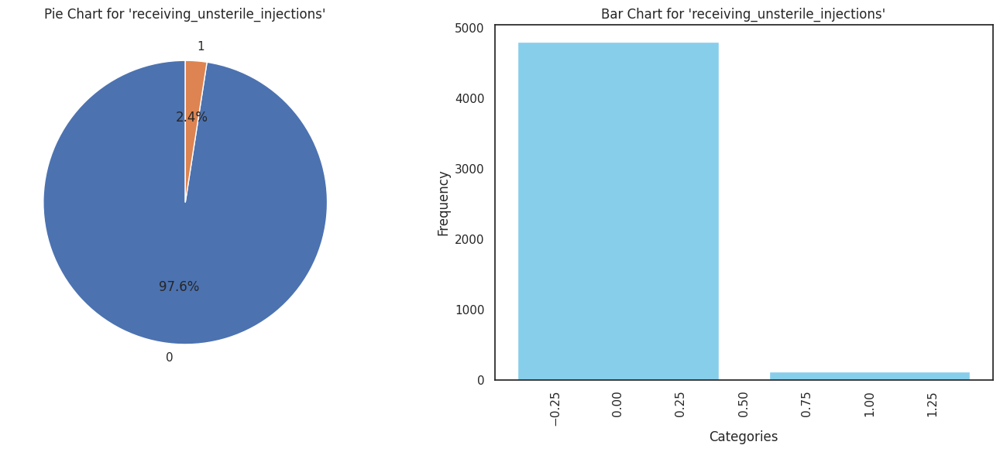

>> Column 'coma' has 2 unique categories.

coma
0    4800
1     120
Name: count, dtype: int64


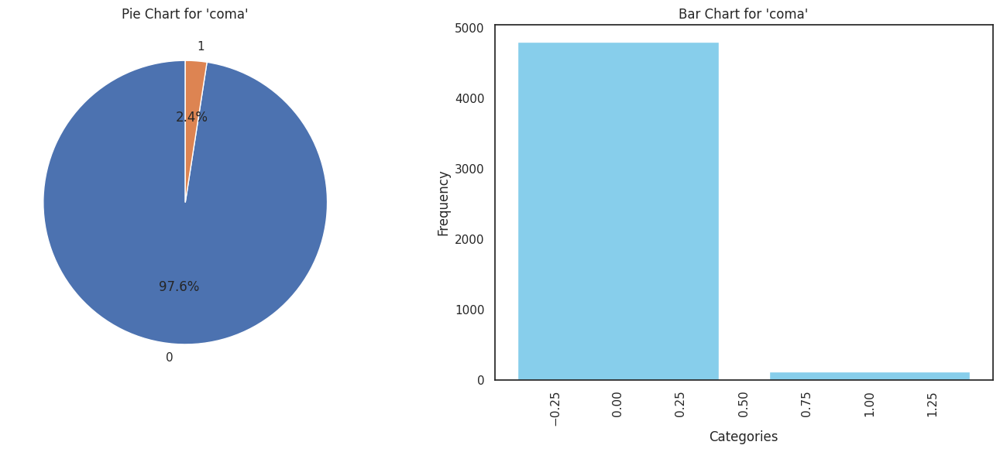

>> Column 'stomach_bleeding' has 2 unique categories.

stomach_bleeding
0    4800
1     120
Name: count, dtype: int64


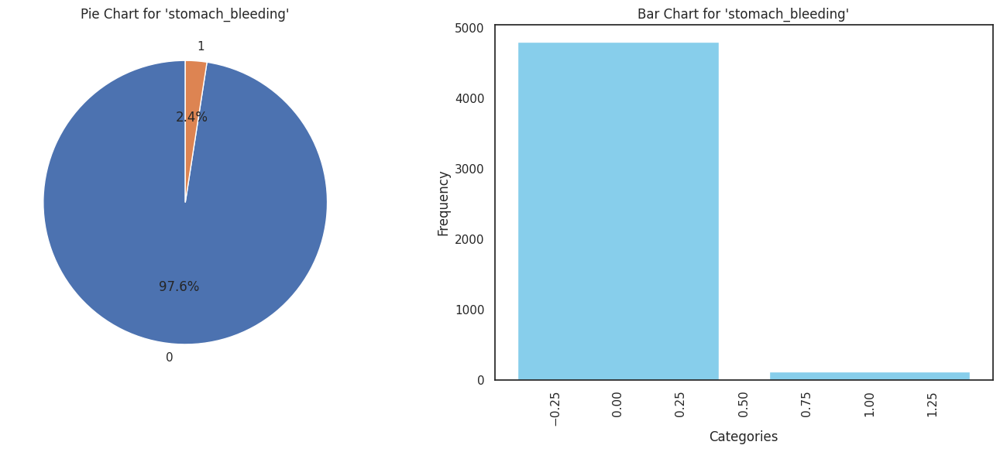

>> Column 'distention_of_abdomen' has 2 unique categories.

distention_of_abdomen
0    4806
1     114
Name: count, dtype: int64


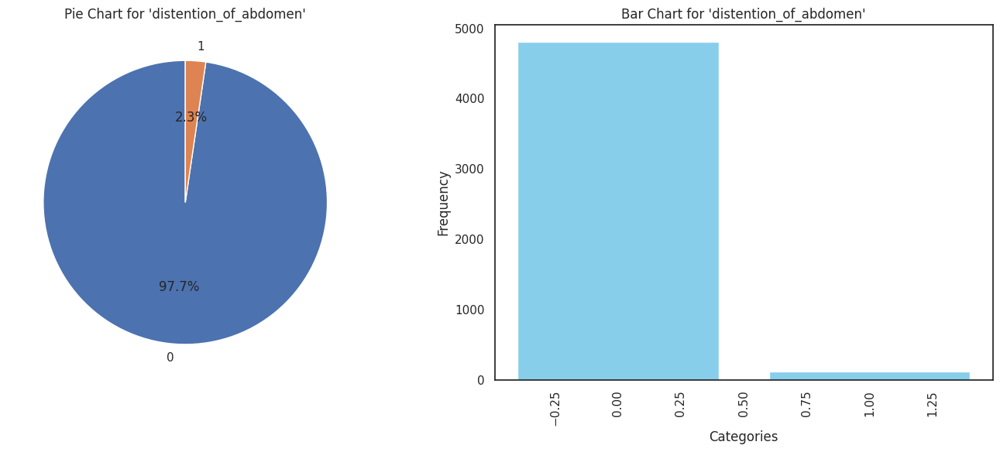

>> Column 'history_of_alcohol_consumption' has 2 unique categories.

history_of_alcohol_consumption
0    4806
1     114
Name: count, dtype: int64


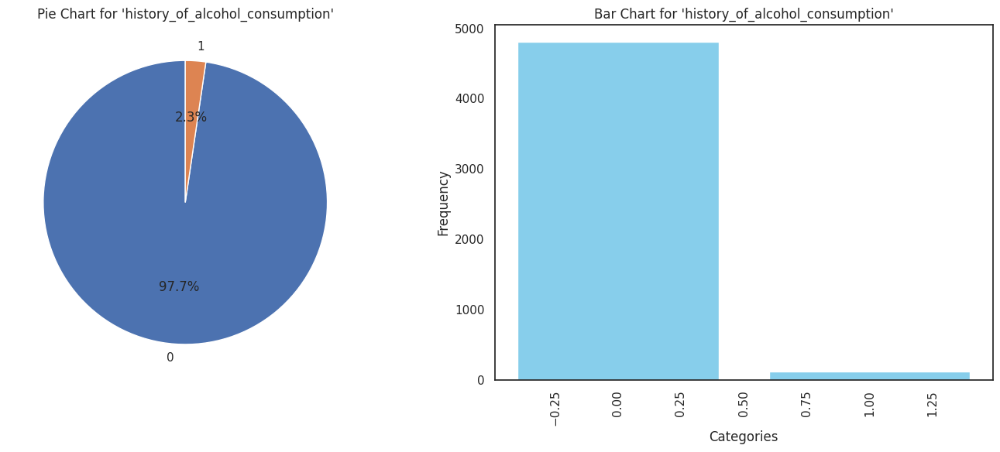

>> Column 'fluid_overload.1' has 2 unique categories.

fluid_overload.1
0    4806
1     114
Name: count, dtype: int64


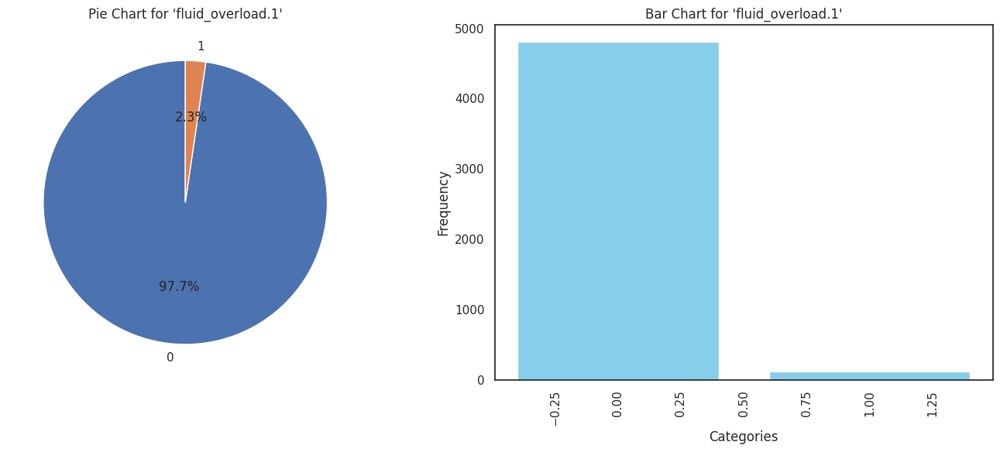

>> Column 'blood_in_sputum' has 2 unique categories.

blood_in_sputum
0    4800
1     120
Name: count, dtype: int64


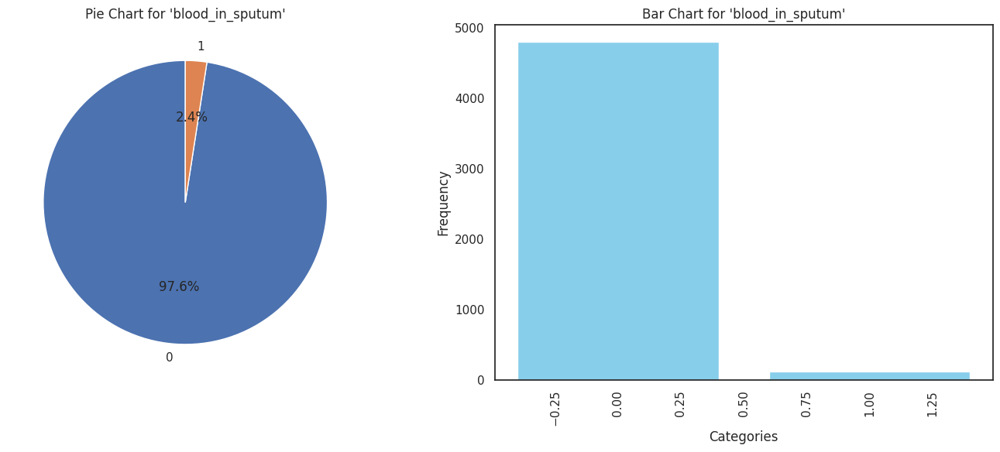

>> Column 'prominent_veins_on_calf' has 2 unique categories.

prominent_veins_on_calf
0    4806
1     114
Name: count, dtype: int64


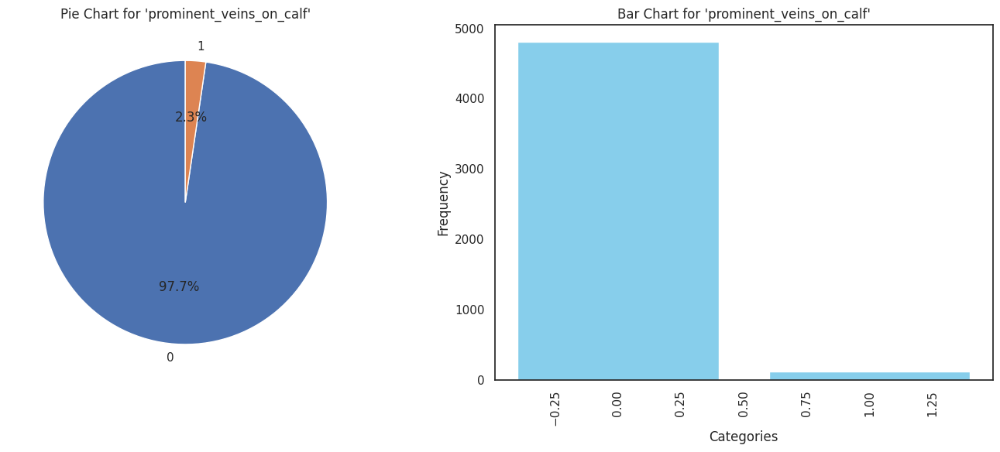

>> Column 'palpitations' has 2 unique categories.

palpitations
0    4800
1     120
Name: count, dtype: int64


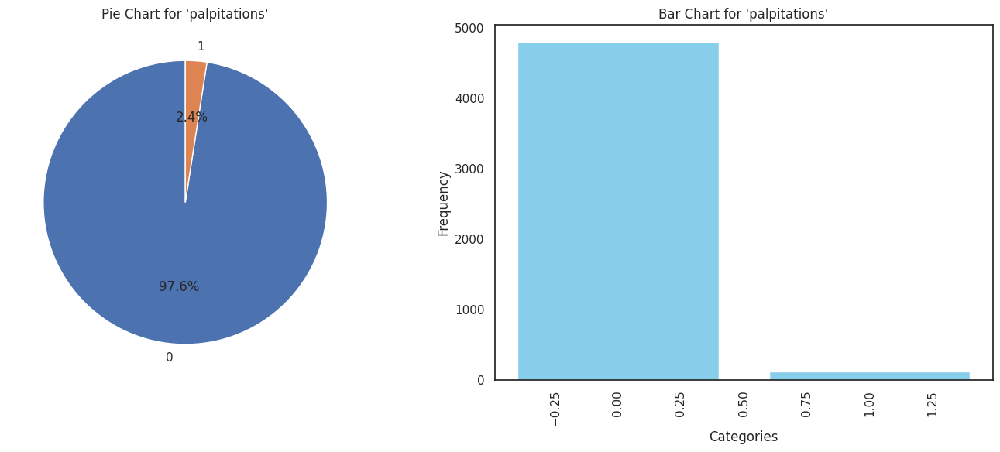

>> Column 'painful_walking' has 2 unique categories.

painful_walking
0    4692
1     228
Name: count, dtype: int64


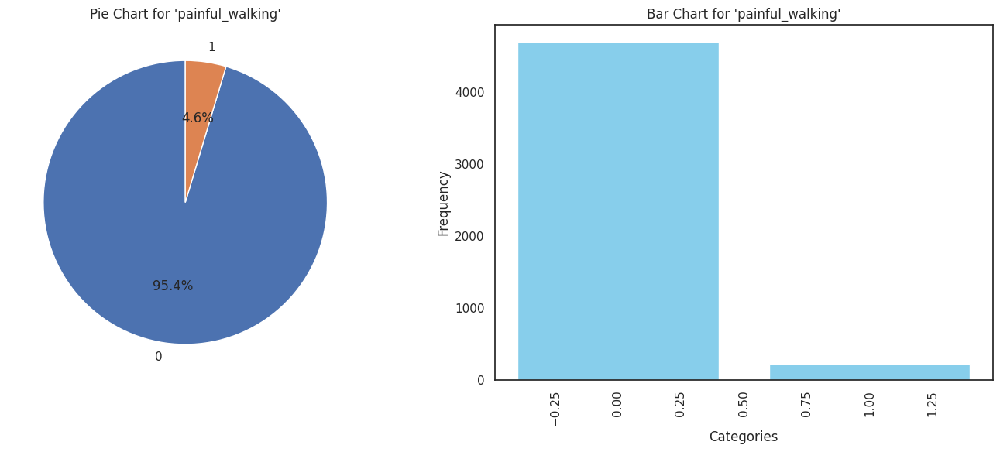

>> Column 'pus_filled_pimples' has 2 unique categories.

pus_filled_pimples
0    4812
1     108
Name: count, dtype: int64


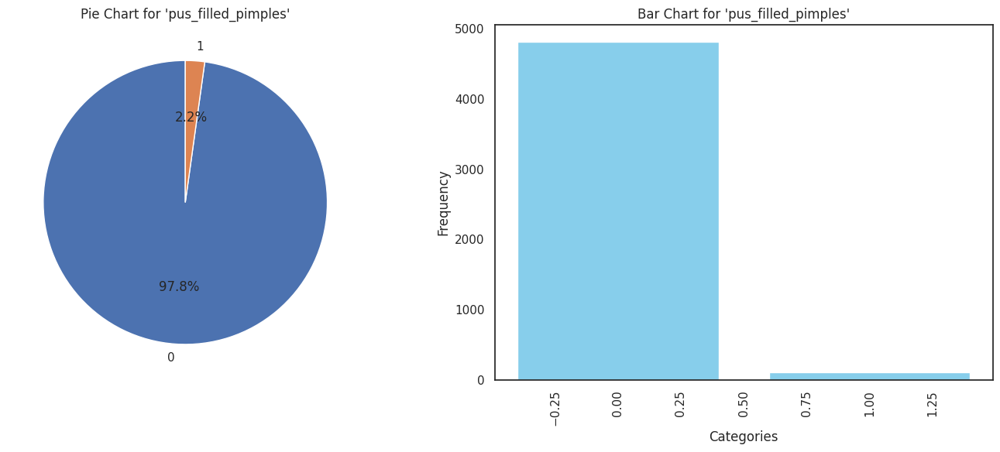

>> Column 'blackheads' has 2 unique categories.

blackheads
0    4812
1     108
Name: count, dtype: int64


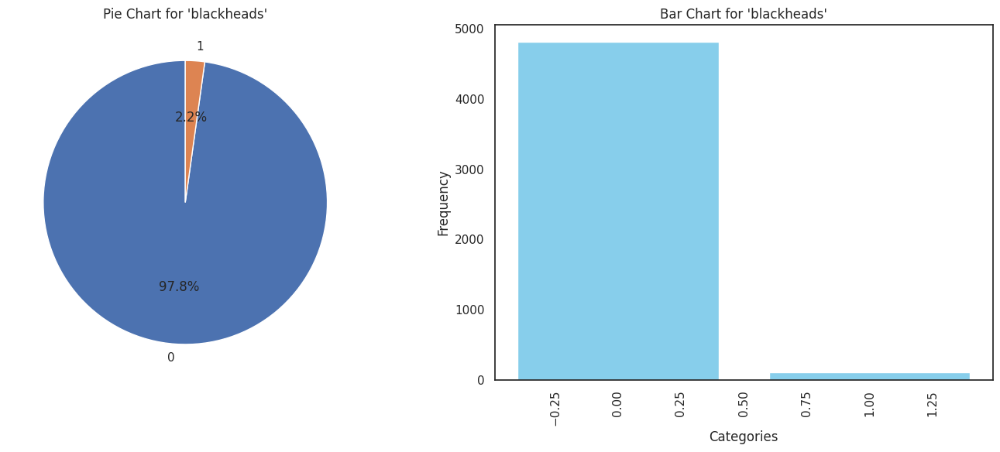

>> Column 'scurring' has 2 unique categories.

scurring
0    4812
1     108
Name: count, dtype: int64


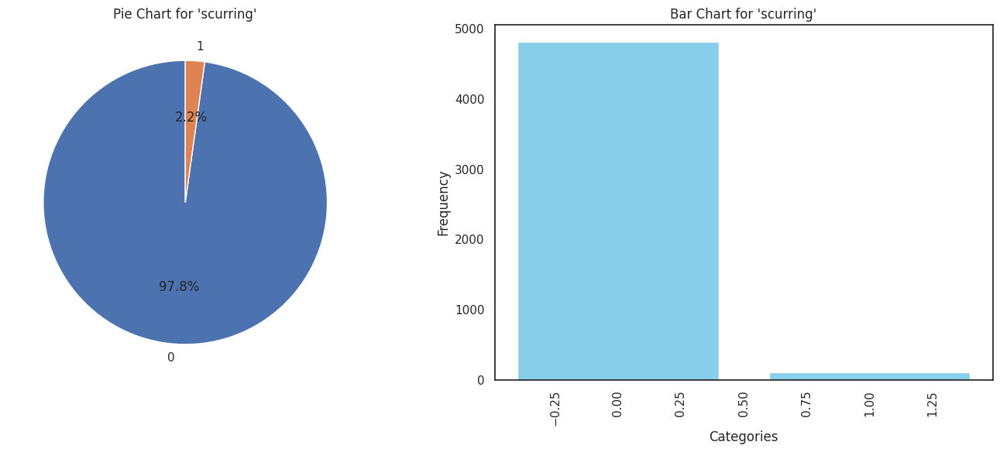

>> Column 'skin_peeling' has 2 unique categories.

skin_peeling
0    4806
1     114
Name: count, dtype: int64


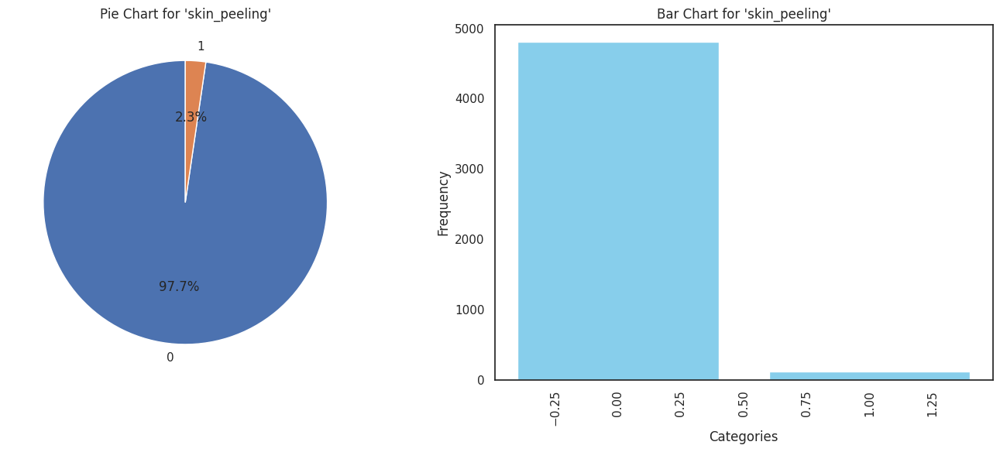

>> Column 'silver_like_dusting' has 2 unique categories.

silver_like_dusting
0    4806
1     114
Name: count, dtype: int64


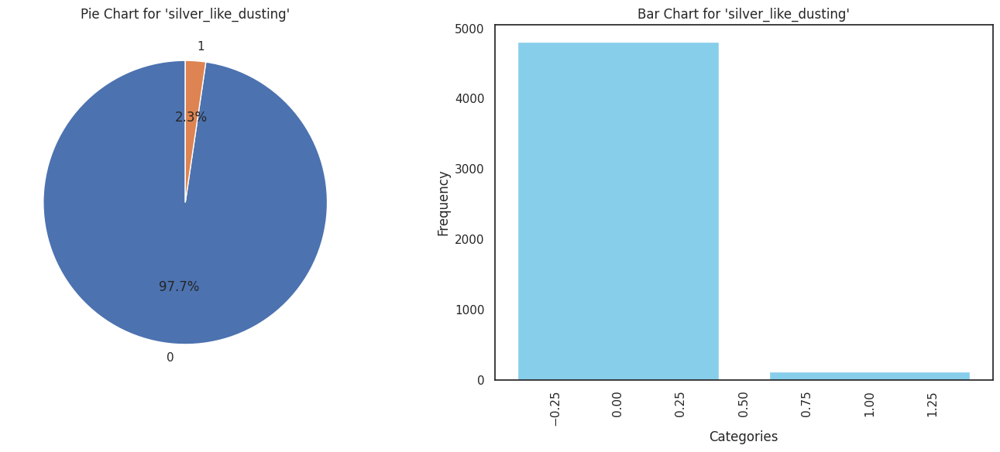

>> Column 'small_dents_in_nails' has 2 unique categories.

small_dents_in_nails
0    4806
1     114
Name: count, dtype: int64


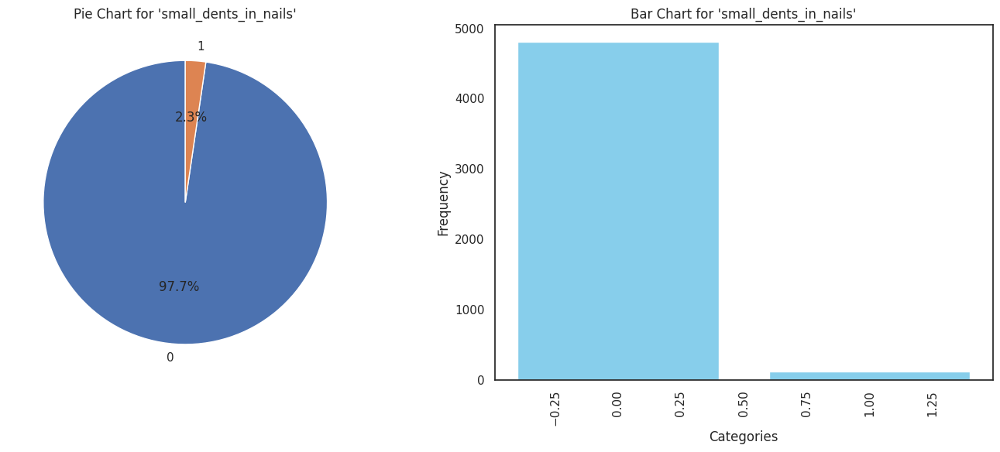

>> Column 'inflammatory_nails' has 2 unique categories.

inflammatory_nails
0    4806
1     114
Name: count, dtype: int64


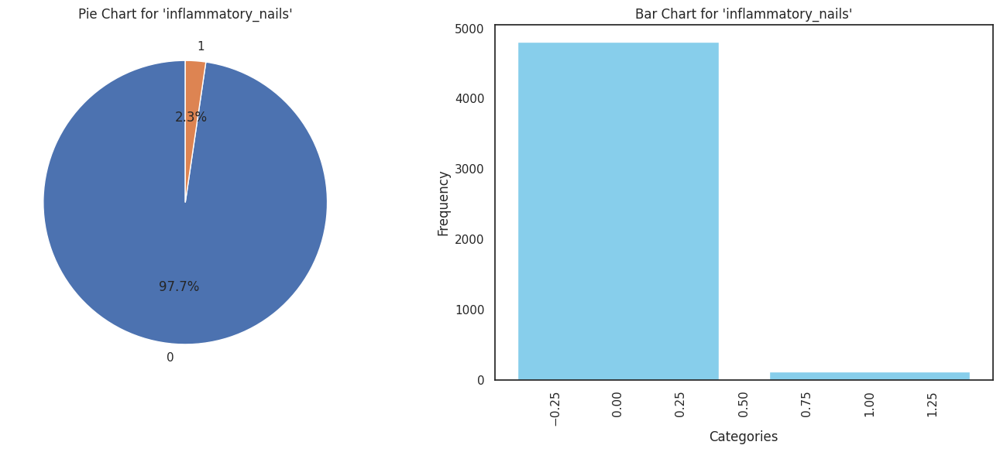

>> Column 'blister' has 2 unique categories.

blister
0    4806
1     114
Name: count, dtype: int64


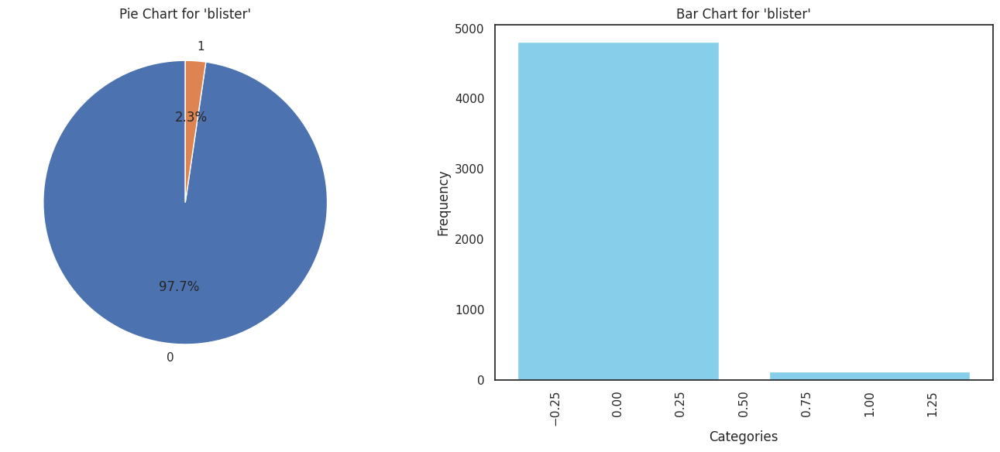

>> Column 'red_sore_around_nose' has 2 unique categories.

red_sore_around_nose
0    4806
1     114
Name: count, dtype: int64


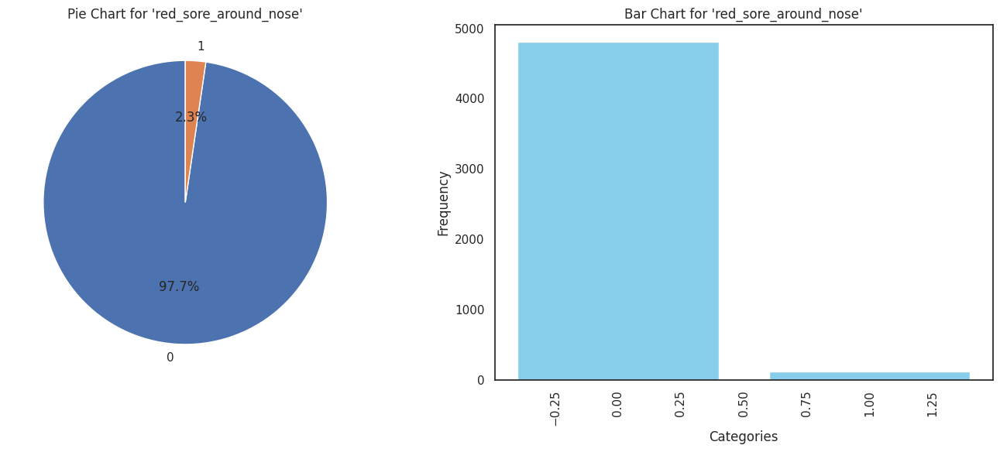

>> Column 'yellow_crust_ooze' has 2 unique categories.

yellow_crust_ooze
0    4806
1     114
Name: count, dtype: int64


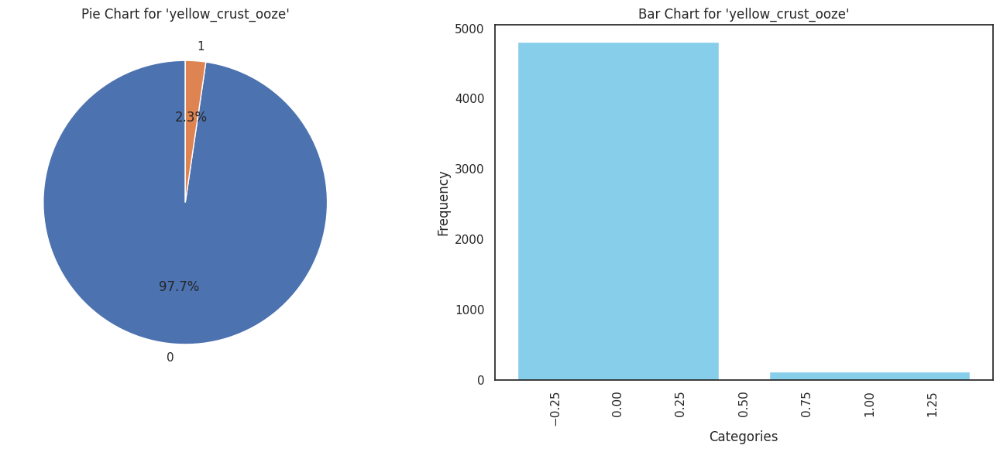

>> Column 'prognosis' has 41 unique categories.

prognosis
Fungal infection                           120
Hepatitis C                                120
Hepatitis E                                120
Alcoholic hepatitis                        120
Tuberculosis                               120
Common Cold                                120
Pneumonia                                  120
Dimorphic hemmorhoids(piles)               120
Heart attack                               120
Varicose veins                             120
Hypothyroidism                             120
Hyperthyroidism                            120
Hypoglycemia                               120
Osteoarthristis                            120
Arthritis                                  120
(vertigo) Paroymsal  Positional Vertigo    120
Acne                                       120
Urinary tract infection                    120
Psoriasis                                  120
Hepatitis D                                120
H

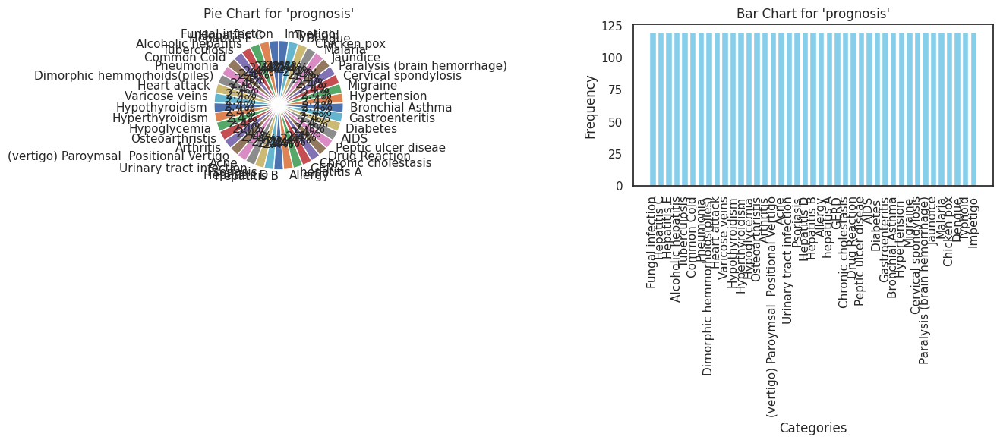

In [11]:
for i in train.columns:
    print(f">> Column '{i}' has {train[i].nunique()} unique categories.\n") #data[i].nunque()
    print(train[i].value_counts())
    
    plt.figure(figsize=(14, 6))

    plt.subplot(1, 2, 1)
    plt.pie(train[i].value_counts().values, labels=train[i].value_counts().index, autopct='%1.1f%%', startangle=90)
    plt.title(f"Pie Chart for '{i}'")

    plt.subplot(1, 2, 2)
    plt.bar(train[i].value_counts().index, train[i].value_counts().values, color='skyblue')
    plt.title(f"Bar Chart for '{i}'")
    plt.xlabel("Categories")
    plt.ylabel("Frequency")
    plt.xticks(rotation=90)

    plt.tight_layout()
    plt.show()

# Data preprocssing

In [12]:
train.isnull().sum() 

itching                 0
skin_rash               0
nodal_skin_eruptions    0
continuous_sneezing     0
shivering               0
                       ..
inflammatory_nails      0
blister                 0
red_sore_around_nose    0
yellow_crust_ooze       0
prognosis               0
Length: 133, dtype: int64

In [13]:
encoder=LabelEncoder()
train['prognosis']=encoder.fit_transform(train.prognosis)

In [14]:
test['prognosis']=encoder.transform(test.prognosis)

In [15]:
x_train=train.drop(columns="prognosis")
y_train=train["prognosis"]

In [16]:
x_test=test.drop(columns="prognosis")
y_test=test["prognosis"]

In [17]:
def train_evaluate(x_train,x_test,y_train,y_test):
    print("x_train shape:", x_train.shape)
    print("\nx_test shape:", x_test.shape)
    print("\ny_train shape:", y_train.shape)
    print("\ny_test shape:", y_test.shape)
    print("\n---------------------------------------------------------------------------------------------------------------------\n")

    models = {
        'SVC': SVC(C=1, kernel="rbf"),
        'K-Nearest Neighbors': KNeighborsClassifier(n_neighbors=7),
        'Decision Tree': DecisionTreeClassifier(max_depth=50, random_state=42, criterion="entropy", max_features=7),
        'Random Forest': RandomForestClassifier(n_estimators=100, criterion='entropy', max_depth=50, max_features=7, random_state=42),
        'Gradient Boosting': GradientBoostingClassifier(n_estimators=150, learning_rate=.01, random_state=42),
        'AdaBoost': AdaBoostClassifier(n_estimators=200, random_state=42, learning_rate=1),
        'XGBoost': XGBClassifier()
    }

    best_model = None
    best_accuracy = 0

    for name, model in models.items():
        print(f"\n             ***********************{name} train *******************\n")
        model.fit(x_train, y_train)
        predictions = model.predict(x_test)
        accuracy = accuracy_score(y_test, predictions)
        print(f"==>{name} Accuracy: {accuracy:.2f}\n")
        print(f"==>{name} classification_report :\n{classification_report(y_test, predictions)}\n")
        ConfusionMatrixDisplay(confusion_matrix(y_test, predictions)).plot(cmap=plt.cm.Blues)
        plt.title(f'Confusion Matrix for {name}')
        plt.show()

        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_model = model

    print(f"\nBest Model: {best_model} with Accuracy: {best_accuracy:.2f}")
    return best_model

x_train shape: (4920, 132)

x_test shape: (42, 132)

y_train shape: (4920,)

y_test shape: (42,)

---------------------------------------------------------------------------------------------------------------------


             ***********************SVC train *******************

==>SVC Accuracy: 1.00

==>SVC classification_report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11

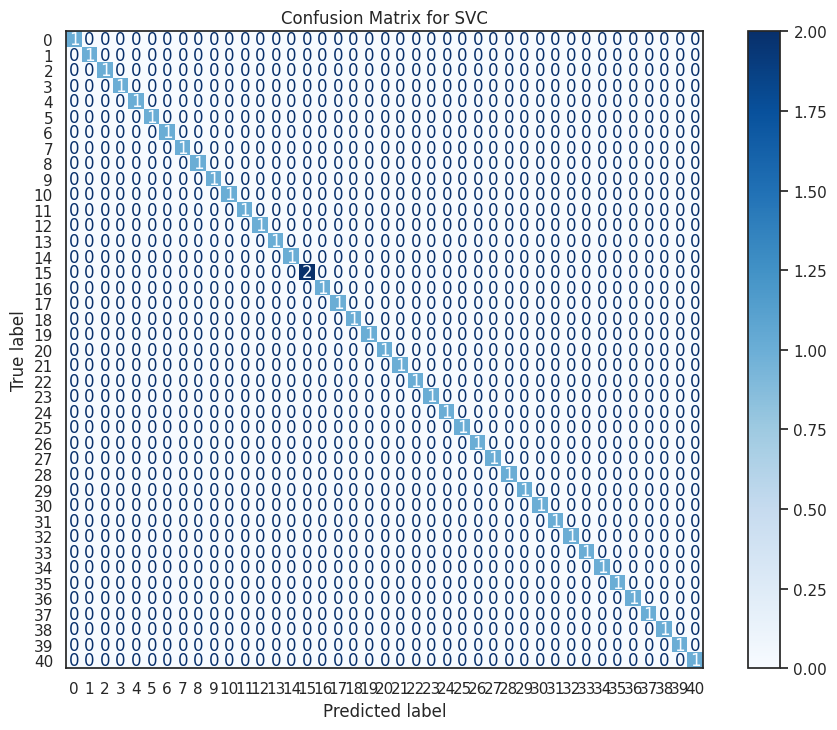


             ***********************K-Nearest Neighbors train *******************

==>K-Nearest Neighbors Accuracy: 1.00

==>K-Nearest Neighbors classification_report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       

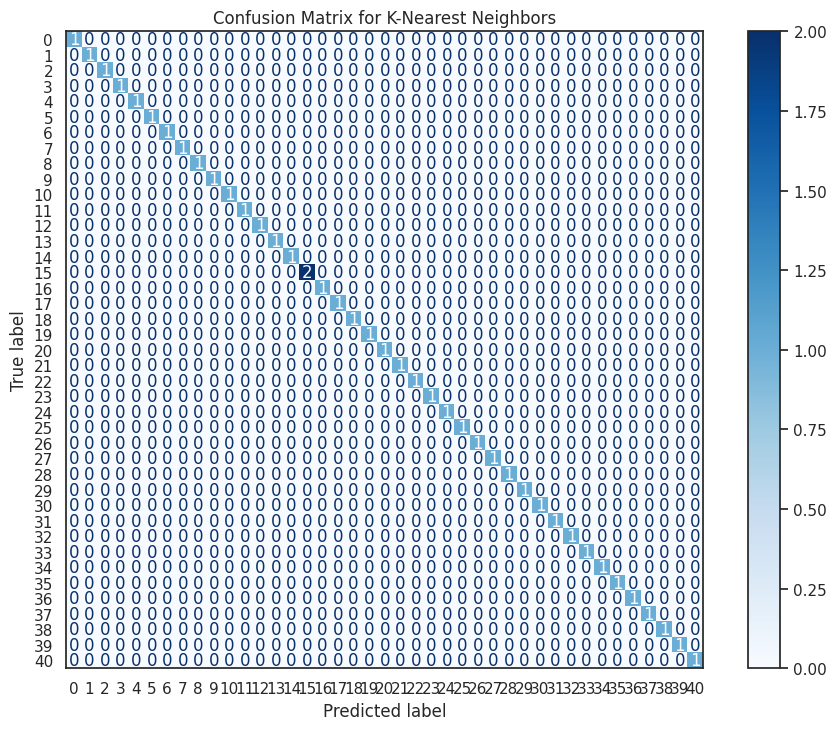


             ***********************Decision Tree train *******************

==>Decision Tree Accuracy: 0.98

==>Decision Tree classification_report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00      1.00    

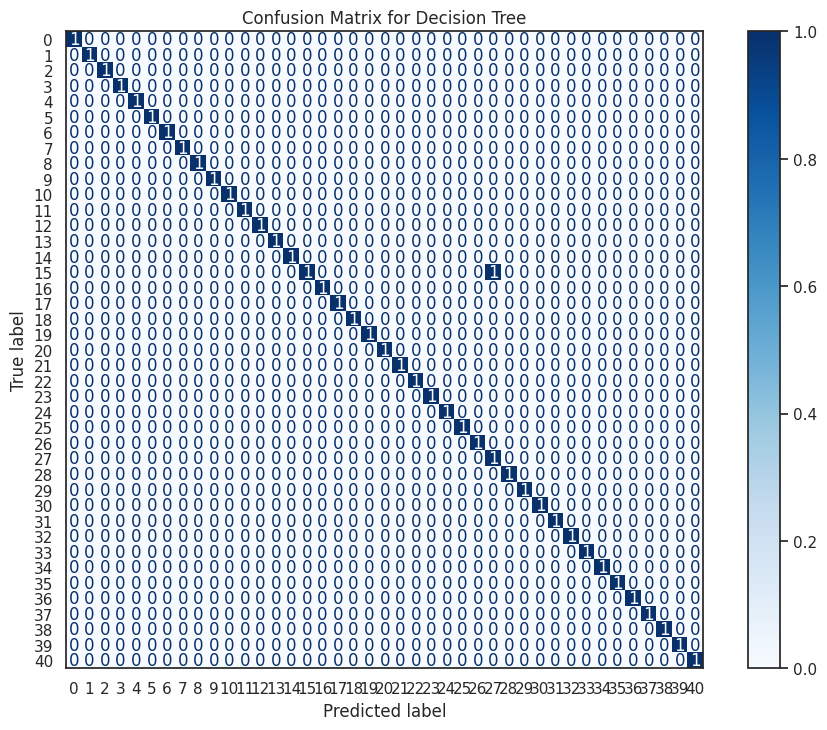


             ***********************Random Forest train *******************

==>Random Forest Accuracy: 1.00

==>Random Forest classification_report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00      1.00    

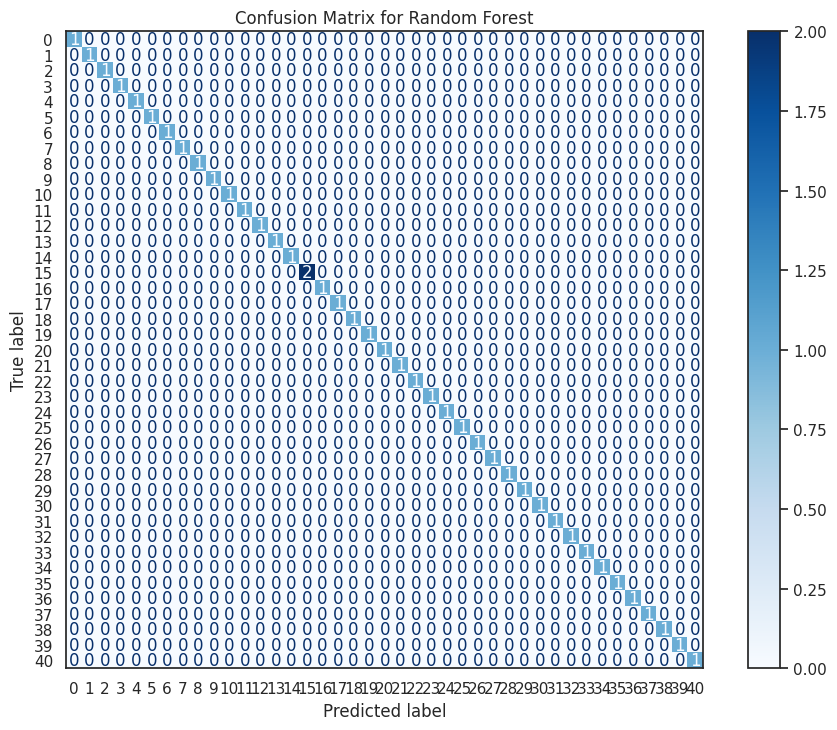


             ***********************Gradient Boosting train *******************

==>Gradient Boosting Accuracy: 0.98

==>Gradient Boosting classification_report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       0.50      1.00      0.67         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00  

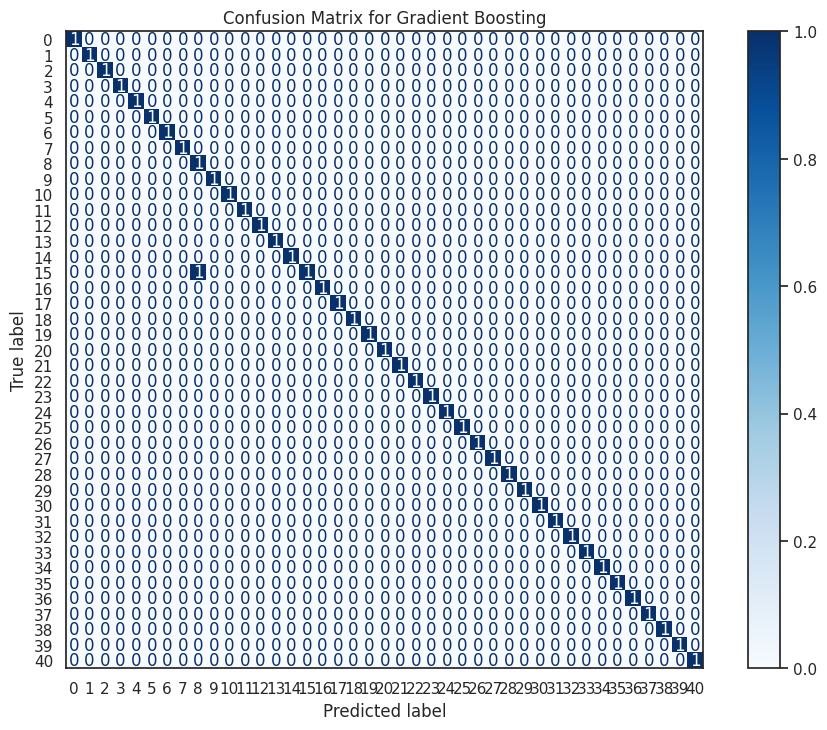


             ***********************AdaBoost train *******************

==>AdaBoost Accuracy: 0.17

==>AdaBoost classification_report :
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.00      0.00      0.00         1
           2       0.00      0.00      0.00         1
           3       0.00      0.00      0.00         1
           4       0.03      1.00      0.05         1
           5       0.00      0.00      0.00         1
           6       0.00      0.00      0.00         1
           7       0.00      0.00      0.00         1
           8       0.00      0.00      0.00         1
           9       0.00      0.00      0.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       0.00      0.00      0.00         1
          13       0.00      0.00      0.00         1
          14       0.00      0.00      0.00         

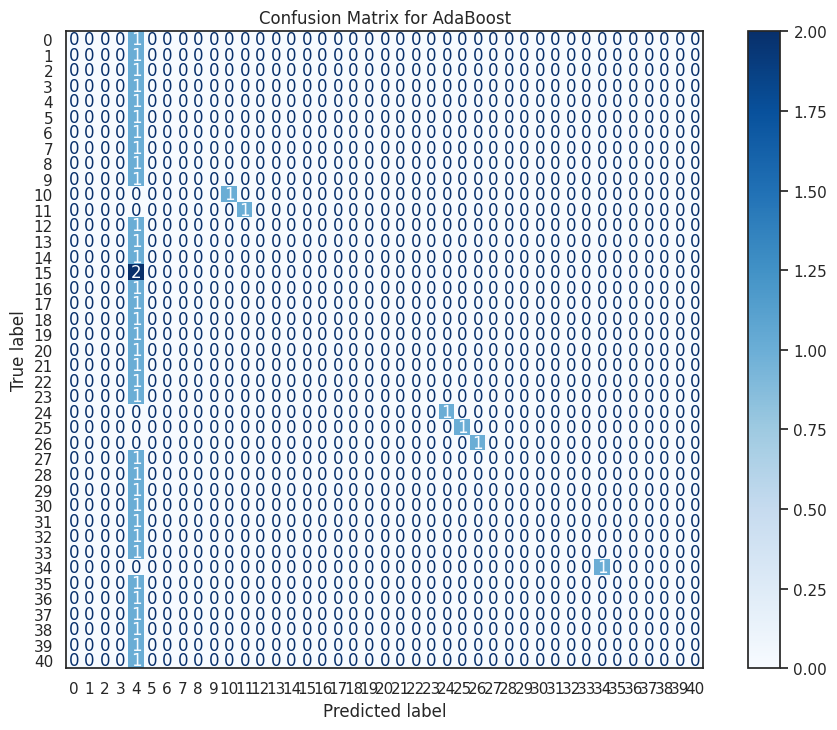


             ***********************XGBoost train *******************

==>XGBoost Accuracy: 0.98

==>XGBoost classification_report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       0.50      1.00      0.67         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00      1.00      1.00         1
 

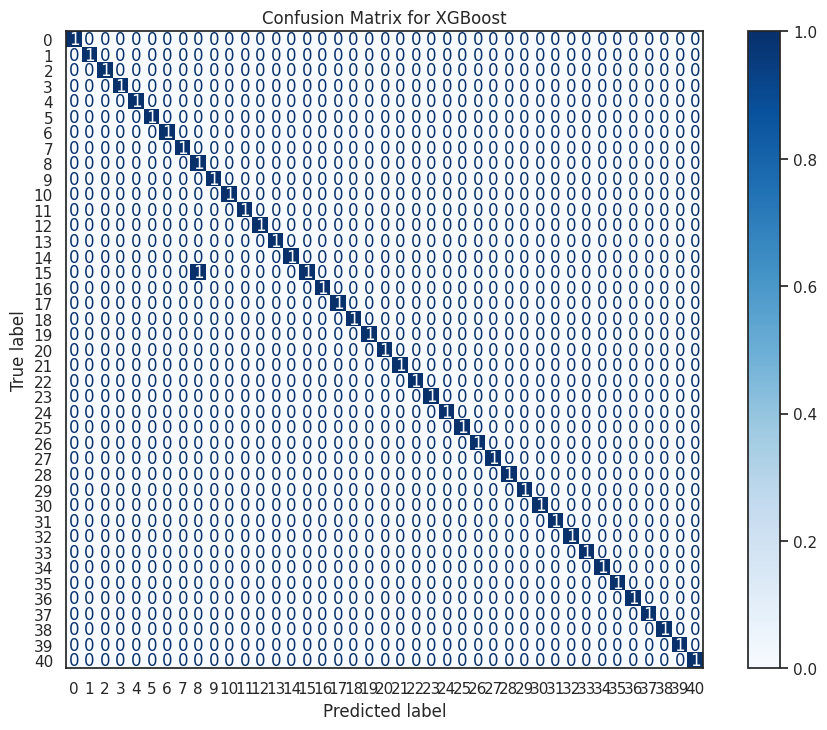


Best Model: SVC(C=1) with Accuracy: 1.00


SVC(C=1)

In [18]:
train_evaluate(x_train,x_test,y_train,y_test)